# Fit atmospheric parameters- filter OG550_65mm_1 date 2023/01/18 PSF2DFFM


- author Sylvie Dagoret-Campagne
- affiliation : IJCLab/IN2P3/CNRS
- creation date : February 13th 2023
- last update : February 13th 2023


# Import

In [1]:
import pandas as pd
import matplotlib as mpl
import matplotlib.cm as cm 
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

import numpy as np
from mpl_toolkits.axes_grid1 import host_subplot
import mpl_toolkits.axisartist as AA
import os,sys,re

from astropy.io import fits
import matplotlib.colors as colors
import matplotlib.cm as cmx
import matplotlib.dates as mdates
from matplotlib import gridspec
%matplotlib inline
import pickle
import seaborn as sns
import copy

In [2]:
import matplotlib.offsetbox
props = dict(boxstyle='round',edgecolor="w",facecolor="w", alpha=0.5)

In [3]:
# to enlarge the sizes
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (10, 6),
         'axes.labelsize': 'xx-large',
         'axes.titlesize':'xx-large',
         'xtick.labelsize':'xx-large',
         'ytick.labelsize':'xx-large'}
plt.rcParams.update(params)

In [4]:
pysynphot_root_path=os.environ['PYSYN_CDBS']
path_sed_calspec=os.path.join(pysynphot_root_path,'calspec')
# pysynphot
import pysynphot as S
S.refs.setref(area=1)
S.refs.getref()

{'graphtable': '/Users/dagoret/MacOSX/External/PySynPhotData/grp/hst/cdbs/mtab/14l1632sm_tmg.fits',
 'comptable': '/Users/dagoret/MacOSX/External/PySynPhotData/grp/hst/cdbs/mtab/16n1832tm_tmc.fits',
 'thermtable': '/Users/dagoret/MacOSX/External/PySynPhotData/grp/hst/cdbs/mtab/tae17277m_tmt.fits',
 'area': 1,
 'waveset': 'Min: 500, Max: 26000, Num: 10000, Delta: None, Log: True'}

In [5]:
import time
from datetime import datetime,date
from astropy.time import Time
import dateutil.parser
import pytz

import argparse

import logging
import coloredlogs
import configparser


In [6]:
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.signal import savgol_filter
from scipy import fftpack
from scipy.optimize import curve_fit,least_squares
from scipy.interpolate import RegularGridInterpolator

In [7]:
# import libradtran
sys.path.append('../../../simulation/atmsim/libradtran')
import libsimulateVisible

libradtranpath= /Users/dagoret/MacOSX/External/libRadtran2/


In [8]:
#from atmosphtransmemullsst.simpleatmospherictransparencyemulator import SimpleAtmEmulator

In [9]:
#from spectractor.extractor.spectroscopy import Lines, Line ,HALPHA, HBETA, O2_1, H2O_1, ATMOSPHERIC_LINES

class Line:
    """Class modeling the emission or absorption lines."""

    def __init__(self, wavelength, label, atmospheric=False, emission=False, label_pos=[0.007, 0.02],
                 width_bounds=[0.5, 6], use_for_calibration=False):
        """Class modeling the emission or absorption lines. lines attributes contains main spectral lines
        sorted in wavelength.

        Parameters
        ----------
        wavelength: float
            Wavelength of the spectral line in nm
        label: str

        atmospheric: bool
            Set True if the spectral line is atmospheric (default: False)
        emission: bool
            Set True if the spectral line has to be detected in emission. Can't be true if the line is atmospheric.
            (default: False)
        label_pos: [float, float]
            Position of the label in the plot with respect to the vertical lin (default: [0.007,0.02])
        width_bounds: [float, float]
            Minimum and maximum width (in nm) of the line for fitting procedures (default: [1,7])
        use_for_calibration: bool
            Use this line for the dispersion relation calibration, bright line recommended (default: False)

        Examples
        --------
        >>> l = Line(550, label='test', atmospheric=True, emission=True)
        >>> print(l.wavelength)
        550
        >>> print(l.label)
        test
        >>> print(l.atmospheric)
        True
        >>> print(l.emission)
        False
        """
        self.wavelength = wavelength  # in nm
        self.label = label
        self.label_pos = label_pos
        self.atmospheric = atmospheric
        self.emission = emission
        if self.atmospheric:
            self.emission = False
        self.width_bounds = width_bounds
        self.fitted = False
        self.use_for_calibration = use_for_calibration
        self.high_snr = False
        self.fit_lambdas = None
        self.fit_gauss = None
        self.fit_bgd = None
        self.fit_snr = None
        self.fit_fwhm = None
        self.fit_popt = None
        self.fit_pcov = None
        self.fit_popt_gaussian = None
        self.fit_pcov_gaussian = None
        self.fit_chisq = None
        self.fit_eqwidth_mod = None
        self.fit_eqwidth_data = None
        #self.fit_bgd_npar = parameters.CALIB_BGD_NPARAMS
        self.fit_bgd_npar = None


In [10]:
HALPHA = Line(656.3, atmospheric=False, label='$H\\alpha$', label_pos=[-0.01, 0.02], use_for_calibration=True)
HBETA = Line(486.3, atmospheric=False, label='$H\\beta$', label_pos=[0.001, 0.02], use_for_calibration=True)
HGAMMA = Line(434.0, atmospheric=False, label='$H\\gamma$', label_pos=[0.001, 0.02], use_for_calibration=True)
HDELTA = Line(410.2, atmospheric=False, label='$H\\delta$', label_pos=[0.001, 0.02], use_for_calibration=True)
HEPSILON = Line(397.0, atmospheric=False, label='$H\\epsilon$', label_pos=[0.001, 0.02], use_for_calibration=True)

HZETA = Line(388.9064, atmospheric=False, label='$H\\zeta$', label_pos=[0.001, 0.02], use_for_calibration=False)
HETA = Line(383.5397, atmospheric=False, label='$H\\eta$', label_pos=[0.001, 0.02], use_for_calibration=False)

HBETA2 = Line(486.3*2, atmospheric=False, label='$H\\beta$2', label_pos=[0.001, 0.02], use_for_calibration=True)
HGAMMA2 = Line(434.0*2, atmospheric=False, label='$H\\gamma$2', label_pos=[0.001, 0.02], use_for_calibration=True)
HDELTA2 = Line(410.2*2, atmospheric=False, label='$H\\delta$2', label_pos=[0.001, 0.02], use_for_calibration=True)
HEPSILON2 = Line(397.0*2, atmospheric=False, label='$H\\epsilon$2', label_pos=[0.001, 0.02], use_for_calibration=True)
HZETA2 = Line(388.9064*2, atmospheric=False, label='$H\\zeta$2', label_pos=[0.001, 0.02], use_for_calibration=False)
HETA2 = Line(383.5397*2, atmospheric=False, label='$H\\eta$2', label_pos=[0.001, 0.02], use_for_calibration=False)

O2_1 = Line(760.3, atmospheric=True, label='$O_2$',label_pos=[0.001, 0.02], use_for_calibration=True)  # libradtran paper fig.3
O2_2 = Line(763.1, atmospheric=True, label='$O_2$',label_pos=[0.001, 0.02], use_for_calibration=True)  # libradtran paper fig.3

O2B = Line(687.472, atmospheric=True, label=r'$O_2(B)$',  # 687.472 is a weighted average of the O2B line simulated by Libradtran
           label_pos=[0.001, 0.02], use_for_calibration=True)  # https://en.wikipedia.org/wiki/Fraunhofer_lines
O2Y = Line(898.765, atmospheric=True, label=r'$O_2(Y)$',
           label_pos=[0.001, 0.02])  # https://en.wikipedia.org/wiki/Fraunhofer_lines
O2Z = Line(822.696, atmospheric=True, label=r'$O_2(Z)$',
           label_pos=[0.001, 0.02])  # https://en.wikipedia.org/wiki/Fraunhofer_lines
# H2O = Line( 960,atmospheric=True,label='$H_2 O$',label_pos=[0.007,0.02],width_bounds=(1,50))  #
H2O_1 = Line(935, atmospheric=True, label=r'$H_2 O$', label_pos=[0.001, 0.02],  # MFL: don't these need different labels?
             width_bounds=[5, 30])  # libradtran paper fig.3, broad line
H2O_2 = Line(960, atmospheric=True, label=r'$H_2 O$', label_pos=[0.001, 0.02],  # MFL: don't these need different labels?
              width_bounds=[5, 30])  # libradtran paper fig.3, broad line
ATMOSPHERIC_LINES = [O2_1, O2_2, O2B, O2Y, O2Z, H2O_1]


H2O_1 = Line(935, atmospheric=True, label=r'$H_2 O$', label_pos=[0.001, 0.02],  # MFL: don't these need different labels?
             width_bounds=[5, 30])  # libradtran paper fig.3, broad line
H2O_2 = Line(960, atmospheric=True, label=r'$H_2 O$', label_pos=[0.007, 0.02],width_bounds=[5, 30])  # libradtran paper fig.3, broad line

#my_calib_lines_etador = Lines([HALPHA,HBETA,HGAMMA,HDELTA,HEPSILON,HBETA2,HGAMMA2,HDELTA2,HEPSILON2,HZETA2,O2_1,O2_2],hydrogen_only=True,atmospheric_lines=True, redshift=0, emission_spectrum=False)
#hydrogen_lines_order1 =  Lines([HALPHA,HBETA,HGAMMA,HDELTA,HEPSILON])
#hydrogen_lines_order2 =  Lines([HBETA2,HGAMMA2,HDELTA2,HEPSILON2,HZETA2,HETA2])
#oxygen_lines_order1 = Lines([O2_1,O2_2])

In [11]:
#ax.plot([x_O2_1,x_O2_1],[72,100],'b-',lw=3)
#ax.annotate(O2_1.label, xy=(x_O2_1, 80), color='b',fontsize=20,fontweight='bold')

In [12]:
os.getenv("PYSYN_CDBS")

'/Users/dagoret/MacOSX/External/PySynPhotData/grp/hst/cdbs'

In [13]:
path_calspec = os.path.join(os.getenv("PYSYN_CDBS"),"calspec")
dict_sedfilename = {'HD38666': "mucol_stis_005.fits", 
            'HD185975': "hd185975_stis_003.fits",
            'HD074000': "hd074000_stis_003.fits",
            'HD60753' : "hd60753_stis_003.fits",
            'HD111980': "hd111980_stis_003.fits"}         

In [14]:
# Must divide the observed flux by this correction area
correction_area = 1.06/1.13

# Functions

- filtering here

https://stackoverflow.com/questions/20618804/how-to-smooth-a-curve-in-the-right-way

In [15]:
def smooth_data_convolve_my_average(arr, span):
    re = np.convolve(arr, np.ones(span * 2 + 1) / (span * 2 + 1), mode="same")

    # The "my_average" part: shrinks the averaging window on the side that 
    # reaches beyond the data, keeps the other side the same size as given 
    # by "span"
    re[0] = np.average(arr[:span])
    for i in range(1, span + 1):
        re[i] = np.average(arr[:i + span])
        re[-i] = np.average(arr[-i - span:])
    return re

def smooth_data_np_average(arr, span):  # my original, naive approach
    return [np.average(arr[val - span:val + span + 1]) for val in range(len(arr))]

def smooth_data_np_convolve(arr, span):
    return np.convolve(arr, np.ones(span * 2 + 1) / (span * 2 + 1), mode="same")

def smooth_data_np_cumsum_my_average(arr, span):
    cumsum_vec = np.cumsum(arr)
    moving_average = (cumsum_vec[2 * span:] - cumsum_vec[:-2 * span]) / (2 * span)

    # The "my_average" part again. Slightly different to before, because the
    # moving average from cumsum is shorter than the input and needs to be padded
    front, back = [np.average(arr[:span])], []
    for i in range(1, span):
        front.append(np.average(arr[:i + span]))
        back.insert(0, np.average(arr[-i - span:]))
    back.insert(0, np.average(arr[-2 * span:]))
    return np.concatenate((front, moving_average, back))

def smooth_data_lowess(arr, span):
    x = np.linspace(0, 1, len(arr))
    return sm.nonparametric.lowess(arr, x, frac=(5*span / len(arr)), return_sorted=False)

def smooth_data_kernel_regression(arr, span):
    # "span" smoothing parameter is ignored. If you know how to 
    # incorporate that with kernel regression, please comment below.
    kr = KernelReg(arr, np.linspace(0, 1, len(arr)), 'c')
    return kr.fit()[0]

def smooth_data_savgol_0(arr, span):  
    return savgol_filter(arr, span * 2 + 1, 0)

def smooth_data_savgol_1(arr, span):  
    return savgol_filter(arr, span * 2 + 1, 1)

def smooth_data_savgol_2(arr, span):  
    return savgol_filter(arr, span * 2 + 1, 2)

def smooth_data_fft(arr, span):  # the scaling of "span" is open to suggestions
    w = fftpack.rfft(arr)
    spectrum = w ** 2
    cutoff_idx = spectrum < (spectrum.max() * (1 - np.exp(-span / 2000)))
    w[cutoff_idx] = 0
    return fftpack.irfft(w)

In [16]:
def atmpatt_Dataf_to_np(df):
    """
    
    atmpatt_Dataf_to_np : convert pandas dtaframe on abs pattern into numpy array
    
    """
    o2_cols = []
    for tabcol in df.columns:
        if 'o2_' in tabcol and 'no2_' not in tabcol:
            o2_cols.append(tabcol)
            
    no2_cols = []
    for tabcol in df.columns:
        if 'no2_' in tabcol:
            no2_cols.append(tabcol)
            
            
    h2o_cols = []
    for tabcol in df.columns:
        if 'h2o_' in tabcol:
            h2o_cols.append(tabcol)
            
            
    o3_cols = []
    for tabcol in df.columns:
        if 'o3_' in  tabcol:
            o3_cols.append(tabcol)
            
            
    data_wl = df["wl"].to_numpy()
    data_o2 = df[o2_cols].to_numpy()
    data_o3 = df[o3_cols].to_numpy()
    data_h2o = df[h2o_cols].to_numpy()
    data_no2 = df[no2_cols].to_numpy()
    
    
    return data_wl, data_o2, data_o3, data_h2o, data_no2
    
    

In [17]:
def find_nearest(a, a0):
    "Element in nd array `a` closest to the scalar value `a0`"
    idx = np.abs(a - a0).argmin()
    return a.flat[idx],int(idx)

In [18]:
def GetSpectra(dict_spectra,factor=1.):
    """
    GetSpectra(dict_spectra)
    
    input:
      - dict_spectra : dictionnary of input spectra
      
      
      {'number': 238.0, 'object': 'mu. Col', 'dateobs': '2022-03-18T00:51:22.049', 'refhour': 0.0, 'airmass': 1.11557476948966, 'pressure': 743.45, 'temperature': 8.9, 
      'humidity': 48.0, 'targetx_pix': 312.7442668572934, 'targety_pix': 1738.0006619324693, 'rotangle': 0.1753951396614214, 'd2ccd': 181.0974436798836, 
      'all_lambdas': array([ 302.20970512,  302.91544585,  303.62117594, ..., 1108.67461764,
       1109.35162338, 1110.02859124]), 'all_fluxes': array([1.04110833e-13, 9.83856109e-14, 8.99209206e-14, ...,
       5.34113538e-13, 5.36905940e-13, 5.53127394e-13]), 'all_fluxes_err': array([3.51303583e-15, 3.10100695e-15, 2.58677333e-15, ...,
       3.34568263e-15, 4.01784054e-15, 4.54242555e-15]), 'all_lambdas_order2': array([ 302.24857475,  302.9543149 ,  303.66004442, ..., 1108.71192607,
       1109.38892974, 1110.06589555]), 'all_fluxes_order2': array([420.23653349, 386.95227531, 344.90384603, ...,  60.47440612,
        60.74615545,  62.53491353]), 'all_fluxes_err_order2': array([14.15542468, 12.17674916,  9.90751987, ...,  0.37846535,
        0.45415764,  0.51307916])}
      
    
    return
      - list of dataframes
    """
    
    #correction_area = 1.06/1.13
    correction_area = 1
    
    list_of_columns = ["number","object",'dateobs','refhour','airmass','pressure','temperature','humidity','filename','targetx_pix', 'targety_pix','rotangle', 'd2ccd']   

    all_df = []  # container for spectra
    
    df_info = pd.DataFrame(columns=list_of_columns)
    
    idx=0
    sorted_dict_spectra_items = sorted(dict_spectra.items())
    for key, value in sorted_dict_spectra_items:
        
        df_info.loc[idx] = [int(value["number"]),value["object"],value["dateobs"],value["refhour"],value["airmass"],value["pressure"],value["temperature"],value["humidity"],key,value['targetx_pix'],value['targety_pix'],value['rotangle'], value['d2ccd']]
         
        df = pd.DataFrame()
        df["all_lambdas"] = value["all_lambdas"]
        df["all_fluxes"] = value["all_fluxes"]/ correction_area*factor 
        df["all_fluxes_err"] = value["all_fluxes_err"]*factor
        
        if 'all_lambdas_order2' in value.keys():
            df["all_lambdas_order2"] = value["all_lambdas_order2"]
            df["all_fluxes_order2"] = value["all_fluxes_order2"]/ correction_area*factor 
            df["all_fluxes_err_order2"] = value["all_fluxes_err_order2"]*factor
            
        
        all_df.append(df)
        
        
        idx+=1
        
    return df_info , all_df

In [19]:
def GetSpectraFiltered(dict_spectra,list_of_bad_spectra,factor = 1.):
    """
    GetSpectraFiltered(inputdir,inputfiles)
    
    input:
      - dict_spectra
      - ist_of_bad_spectra
    
    return
      - filtered infos, filtered spectra
    """
    
    # factor to correct fluxes (over estimated collection surface)
    #correction_area = 1.06/1.13
    correction_area = 1
    
    
    
    list_of_columns = ["number","object",'dateobs','refhour','airmass','pressure','temperature','humidity','filename','targetx_pix', 'targety_pix','rotangle', 'd2ccd']   
        

    all_df = []  # container for spectra
    
    df_info = pd.DataFrame(columns=list_of_columns)
    
    idx=0       # counter on input spectra
    idx_out = 0 # counter on save spectra
    #for key, value in dict_spectra.items():
    sorted_dict_spectra_items = sorted(dict_spectra.items())
    for key, value in sorted_dict_spectra_items:
        
        
        if int(value["number"]) not in list_of_bad_spectra:
        
            
            df_info.loc[idx] = [int(value["number"]),value["object"],value["dateobs"],value["refhour"],value["airmass"],value["pressure"],value["temperature"],value["humidity"],key,value['targetx_pix'],value['targety_pix'],value['rotangle'], value['d2ccd']] 
        
            df = pd.DataFrame()
            df["all_lambdas"] = value["all_lambdas"]
            df["all_fluxes"] = value["all_fluxes"]/correction_area*factor
            df["all_fluxes_err"] = value["all_fluxes_err"]*factor
        
            if 'all_lambdas_order2' in value.keys():
                df["all_lambdas_order2"] = value["all_lambdas_order2"]
                df["all_fluxes_order2"] = value["all_fluxes_order2"]/correction_area*factor
                df["all_fluxes_err_order2"] = value["all_fluxes_err_order2"]*factor
               
            all_df.append(df)
            idx_out+=1  # increase count on saved spectra
            
        else:
            num = int(value["number"])
            msg = f"Remove spectrum {idx} for exposure {num}"
            print(msg)
            
        idx+=1
            

        
    return df_info,all_df

In [20]:
def FindPairOfExposures(df):
    """
    
    Find pair of exposures at similar airmass, one before culmination, the other one after the exposure
    
    - input : pandas dataframe with infos
    - output : pandas dataframe with pairs
    
    """
    
    
 
    # the culmination  
    idx_zmin = df["airmass"].idxmin()
    
    # split this dataframe into 2
    
    # df before culmination
    df1 = df.iloc[0:idx_zmin]
    
    # df after culmination
    df2 = df.iloc[idx_zmin+1:-1]
    
    #print(df1)
    
    #print(df2)
    
    # loop on exposure before culmination
    #for irow in range(0,idx_zmin):
        # print(irow,df1.iloc[irow][["number","airmass"]])
        
    dist = np.abs(df1["airmass"][np.newaxis, :] - df2["airmass"][:, np.newaxis])
    #print(dist)
    closest_idx = np.argmin(dist, axis=0)
    closest_id = df2.iloc[closest_idx]["number"].to_numpy()
    df_output = pd.DataFrame({"idx1": np.arange(0,idx_zmin), 
                              "idx2": closest_idx+idx_zmin+1,
                              "num1":df1["number"],
                              "num2":closest_id,
                              "z1":df1["airmass"].values,
                              "z2":df2.iloc[closest_idx]["airmass"].to_numpy()})

    df_output["zdiff"] =  df_output["z2"]-df_output["z1"]
    df_output["dtime"] = df2.iloc[closest_idx]["refhour"].to_numpy()- df1["refhour"] 
    return df_output
    

In [21]:
def FindPairOfExposuresFromFirst(df):
    """
    
    - input : pandas dataframe with infos
    - output : pandas dataframe with pairs
    
    """ 
 

    idx_start = 0
    
    # split this dataframe into 2
    
    # df before culmination
    df1 = df.iloc[:idx_start+1]
    
    # df after culmination
    df2 = df.iloc[idx_start+1:]
    N2=len(df2)
    

    df1_new = df1.copy(deep=True)
    df1_new = pd.concat([df1]*(N2),axis=0)
 
    df1=df1_new
    N1=len(df1)
   
    df_output = pd.DataFrame({"idx1": np.full(N1,0), 
                              "idx2": np.arange(1,N2+1),
                              "num1":df1["number"].values,
                              "num2":df2["number"].values,
                              "z1":df1["airmass"].values,
                              "z2":df2["airmass"].values,
                              "t1":df1["refhour"].values,
                              "t2":df2["refhour"].values})

    df_output["zdiff"] =  df_output["z2"]-df_output["z1"]
    df_output["dtime"] = df_output["t2"]-df_output["t1"]
    return df1,df2,df_output
    

In [22]:
class SimpleAtmEmulator:
    """
    Emulate Atmospheric Transparency above LSST from a data grids
    extracted from libradtran and analytical functions for aerosols.
    There are 3 grids:
    - 2D grid Rayleigh transmission vs (wavelength,airmass)
    - 2D grid O2 absorption vs  (wavelength,airmass)
    - 3D grid for PWV absorption vs (wavelength,airmass,PWV)
    - 3D grid for Ozone absorption vs (wavelength,airmass,Ozone)
    - Aerosol transmission for any number of components
    
    """
    def __init__(self,path='../data/simplegrid'):
        """
        Initialize the class for data point files from which the 2D and 3D grids are created.
        Interpolation are calculated from the scipy RegularGridInterpolator() function
        
        """
        self.path = path
        self.fn_info_training = "atmospherictransparencygrid_params_training.pickle"
        self.fn_info_test = "atmospherictransparencygrid_params_test.pickle"
        self.fn_rayleigh_training = "atmospherictransparencygrid_rayleigh_training.npy"
        self.fn_rayleigh_test = "atmospherictransparencygrid_rayleigh_test.npy"
        self.fn_O2abs_training = "atmospherictransparencygrid_O2abs_training.npy"
        self.fn_O2abs_test = "atmospherictransparencygrid_O2abs_test.npy"
        self.fn_PWVabs_training = "atmospherictransparencygrid_PWVabs_training.npy"
        self.fn_PWVabs_test = "atmospherictransparencygrid_PWVabs_test.npy"
        self.fn_OZabs_training = "atmospherictransparencygrid_OZabs_training.npy"
        self.fn_OZabs_test = "atmospherictransparencygrid_OZabs_test.npy"

        self.info_params_training = None
        self.info_params_test = None
        self.data_rayleigh_training = None
        self.data_rayleigh_test = None
        self.data_O2abs_training = None
        self.data_O2abs_test = None
        self.data_PWVabs_training = None
        self.data_PWVabs_test = None
        self.data_OZabs_training = None
        self.data_OZabs_test = None
        
        self.loadtables()
        
        self.WLMIN = self.info_params_training["WLMIN"]
        self.WLMAX = self.info_params_training["WLMAX"]
        self.WLBIN = self.info_params_training["WLBIN"]
        self.NWLBIN = self.info_params_training['NWLBIN']
        self.WL = self.info_params_training['WL']
        
        self.AIRMASSMIN = self.info_params_training['AIRMASSMIN']
        self.AIRMASSMAX = self.info_params_training['AIRMASSMAX']
        self.NAIRMASS = self.info_params_training['NAIRMASS']
        self.DAIRMASS = self.info_params_training['DAIRMASS']
        self.AIRMASS = self.info_params_training['AIRMASS']
        
        self.PWVMIN = self.info_params_training['PWVMIN']
        self.PWVMAX = self.info_params_training['PWVMAX'] 
        self.NPWV = self.info_params_training['NPWV']
        self.DPWV = self.info_params_training['DPWV'] 
        self.PWV = self.info_params_training['PWV']
        
        
        self.OZMIN =  self.info_params_training['OZMIN']
        self.OZMAX = self.info_params_training['OZMAX']
        self.NOZ = self.info_params_training['NOZ']
        self.DOZ =  self.info_params_training['DOZ'] 
        self.OZ = self.info_params_training['OZ']
        
        
        self.lambda0 = 550.
        self.tau0 = 1.


        self.func_rayleigh_train = RegularGridInterpolator((self.WL,self.AIRMASS),self.data_rayleigh_training)
        self.func_O2abs_train = RegularGridInterpolator((self.WL,self.AIRMASS),self.data_O2abs_training)
        self.func_PWVabs_train = RegularGridInterpolator((self.WL,self.AIRMASS,self.PWV),self.data_PWVabs_training)
        self.func_OZabs_train = RegularGridInterpolator((self.WL,self.AIRMASS,self.OZ),self.data_OZabs_training)

        
        
    def loadtables(self):
        """
        Load files into grid arrays
        """
        
        filename=os.path.join(self.path,self.fn_info_training)     
        with open(filename, 'rb') as f:
            self.info_params_training = pickle.load(f)
            
        filename=os.path.join(self.path,self.fn_info_test)     
        with open(filename, 'rb') as f:
            self.info_params_test = pickle.load(f)        
        
        filename=os.path.join(self.path,self.fn_rayleigh_training)
        with open(filename, 'rb') as f:
            self.data_rayleigh_training=np.load(f)
            
        filename=os.path.join(self.path,self.fn_rayleigh_test)
        with open(filename, 'rb') as f:
            self.data_rayleigh_test=np.load(f)
            
        filename=os.path.join(self.path,self.fn_O2abs_training)
        with open(filename, 'rb') as f:
            self.data_O2abs_training=np.load(f)
            
        filename=os.path.join(self.path,self.fn_O2abs_test)
        with open(filename, 'rb') as f:
            self.data_O2abs_test=np.load(f)
                  
        filename=os.path.join(self.path,self.fn_PWVabs_training)
        with open(filename, 'rb') as f:
            self.data_PWVabs_training=np.load(f)
            
        filename=os.path.join(self.path,self.fn_PWVabs_test)
        with open(filename, 'rb') as f:
            self.data_PWVabs_test=np.load(f)
            
            
        filename=os.path.join(self.path,self.fn_OZabs_training)
        with open(filename, 'rb') as f:
            self.data_OZabs_training=np.load(f)
            
        filename=os.path.join(self.path,self.fn_OZabs_test)
        with open(filename, 'rb') as f:
            self.data_OZabs_test=np.load(f)
            
            
    def GetWL(self):
        return self.WL
            
    def GetRayleighTransparencyArray(self,wl,am):
        pts = [ np.array([the_wl,am])   for the_wl in wl]
        return self.func_rayleigh_train(pts)
    
    
    def GetO2absTransparencyArray(self,wl,am):
        pts = [ np.array([the_wl,am])   for the_wl in wl]
        return self.func_O2abs_train(pts)
    
    
    def GetPWVabsTransparencyArray(self,wl,am,pwv):
        pts = [ np.array([the_wl,am,pwv])   for the_wl in wl]
        return self.func_PWVabs_train(pts)
    
    
    def GetOZabsTransparencyArray(self,wl,am,oz):
        pts = [ np.array([the_wl,am,oz])   for the_wl in wl]
        return self.func_OZabs_train(pts)
    
    def GetGriddedTransparencies(self,wl,am,pwv,oz,flagRayleigh=True,flagO2abs=True,flagPWVabs=True,flagOZabs=True):
        """
        Emulation of libradtran simulated transparencies. Decomposition of the
        total transmission in different processes:
        - Rayleigh scattering
        - O2 absorption
        - PWV absorption
        - Ozone absorption
        
        inputs:
        - wl : wavelength array or list
        - am :the airmass,
        - pwv : the precipitable water vapor (mm)
        - oz : the ozone column depth in Dobson unit
        - flags to activate or not the individual interaction processes
        
        outputs:
        - 1D array of atmospheric transmission (save size as wl)
        
        """
        

        if flagRayleigh:
            pts = [ np.array([the_wl,am]) for the_wl in wl]
            transm = self.func_rayleigh_train(pts)
        else:
            transm = np.ones(len(wl))
            
        if flagO2abs:
            transm *= self.GetO2absTransparencyArray(wl,am)
            
        if flagPWVabs:
            transm *= self.GetPWVabsTransparencyArray(wl,am,pwv)
            
        if flagOZabs:
            transm *= self.GetOZabsTransparencyArray(wl,am,oz)
            
        return transm
            
    def GetAerosolsTransparencies(self,wl,am,ncomp,taus=None,betas=None):
        """
        Compute transmission due to aerosols:
        
        inputs:
        - wl : wavelength array
        - am : the airmass
        - ncomp : the number of aerosol components
        - taus : the vertical aerosol depth of each component at lambda0 vavelength
        - betas : the angstrom exponent. Must be negativ.
        
        
        outputs:
        - 1D array of atmospheric transmission (save size as wl)
        
        """
          
        wl = np.array(wl)
        NWL=wl.shape[0]
        
        transm = np.ones(NWL)
        
        if ncomp <=0:
            return transm
        else:
            taus=np.array(taus)
            betas=np.array(betas)
            
            NTAUS=taus.shape[0]
            NBETAS=betas.shape[0]
        
            assert ncomp<=NTAUS
            assert ncomp<=NBETAS     
        
            for icomp in range(ncomp):            
                exponent = (taus[icomp]/self.tau0)*np.exp(betas[icomp]*np.log(wl/self.lambda0))*am
                transm *= np.exp(-exponent)
            
            return transm
        
        
    def GetAllTransparencies(self,wl,am,pwv,oz,ncomp=0, taus=None, betas=None, flagRayleigh=True,flagO2abs=True,flagPWVabs=True,flagOZabs=True,flagAerosols=False):
        """
        Combine interpolated libradtran transmission with analytical expression for the
        aerosols
        
        inputs:
        - wl : wavelength array or list
        - am :the airmass,
        - pwv : the precipitable water vapor (mm)
        - oz : the ozone column depth in Dobson unit
        - ncomp : number of aerosols components,
        - taus & betas : arrays of parameters for aerosols
        - flags to activate or not the individual interaction processes
        
        outputs:
        - 1D array of atmospheric transmission (save size as wl)
        
        """
        
        
        transm = self.GetGriddedTransparencies(wl,am,pwv,oz,flagRayleigh=flagRayleigh,flagO2abs=flagO2abs,flagPWVabs=flagPWVabs,flagOZabs=flagOZabs)
        
        if flagAerosols:
            transmaer = self.GetAerosolsTransparencies(wl,am,ncomp,taus,betas)
            transm *=transmaer
           
            
        return transm
            

# Constants

# Initialisation

In [23]:
# start with logs
#-----------------
logging.basicConfig()
logging.root.setLevel(logging.NOTSET)

handle = __name__

logger = logging.getLogger(handle)
# logging.getLogger().setLevel(logging.INFO)
logger.setLevel(logging.DEBUG)

# If you don't want to see log messages from libraries, you can pass a
# specific logger object to the install() function. In this case only log
# messages originating from that logger will show up on the terminal.
coloredlogs.install(level='DEBUG', logger=logger)
coloredlogs.install(fmt='%(asctime)s,%(msecs)03d %(hostname)s %(name)s[%(process)d] %(levelname)s %(message)s')

In [24]:
# set time
# date
today = date.today()
string_date = today.strftime("%Y-%m-%d")

# time
now = datetime.now()
current_time = now.strftime("%H:%M:%S")

tim = time.localtime()
current_time = time.strftime("%H:%M:%S", tim)

# timezones
tz_LA = pytz.timezone('America/Los_Angeles')
datetime_LA = datetime.now(tz_LA)
msg="LA time:"+  datetime_LA.strftime("%H:%M:%S")
logger.info(msg)

tz_NY = pytz.timezone('America/New_York')
datetime_NY = datetime.now(tz_NY)
msg="NY time:"+ datetime_NY.strftime("%H:%M:%S")
logger.info(msg)

tz_London = pytz.timezone('Europe/London')
datetime_London = datetime.now(tz_London)
msg="London time:"+ datetime_London.strftime("%H:%M:%S")
logger.info(msg)

tz_Paris = pytz.timezone('Europe/Paris')
datetime_Paris = datetime.now(tz_Paris)
msg="Paris time:"+ datetime_Paris.strftime("%H:%M:%S")
logger.info(msg)

msg="************************ START *********************"
logger.info(msg)


2023-02-13 14:19:36,656 MacBook-Pro-de-admin.local __main__[89187] INFO LA time:05:19:36
2023-02-13 14:19:36,659 MacBook-Pro-de-admin.local __main__[89187] INFO NY time:08:19:36
2023-02-13 14:19:36,662 MacBook-Pro-de-admin.local __main__[89187] INFO London time:13:19:36
2023-02-13 14:19:36,665 MacBook-Pro-de-admin.local __main__[89187] INFO Paris time:14:19:36
2023-02-13 14:19:36,666 MacBook-Pro-de-admin.local __main__[89187] INFO ************************ START *********************


In [25]:
# arguments
#----------

parser = argparse.ArgumentParser()
parser.add_argument("--config",action="store", dest="configfile",help=f" run generate -config configfilename, with by ex configfilename = default.ini")
#results_args = parser.parse_args()

results_args=""


# Configuration

In [26]:
DATE = 20230118
FILTERTYPE = "OG550_65mm_1~holo4_003"
spectractormode = "psf2dffm"
ext = "rebin2"   # run BPS by removing ACQ

In [27]:
# config file
# --------------
#configfile = "config/default.ini"
if ext == None or ext == "":
    configfile = f"config/{DATE}/{FILTERTYPE}/confprog_run-auxtel-{DATE}-{FILTERTYPE}_{spectractormode}.ini"
else:
    configfile = f"config/{DATE}/{FILTERTYPE}/confprog_run-auxtel-{DATE}-{FILTERTYPE}_{spectractormode}_{ext}.ini"
    
#config_filename = results_args.configfile
config_filename = configfile
msg = f"Configuration file : {config_filename}"
logger.info(msg)


2023-02-13 14:19:36,687 MacBook-Pro-de-admin.local __main__[89187] INFO Configuration file : config/20230118/OG550_65mm_1~holo4_003/confprog_run-auxtel-20230118-OG550_65mm_1~holo4_003_psf2dffm_rebin2.ini


In [28]:
# 1) CONFIGURATION
#------------------
logger.info('1) Configuration')

config = configparser.ConfigParser()

if os.path.exists(config_filename):
    config.read(config_filename)
else:
    msg = f"config file {config_filename} does not exist !"
    logger.error(msg)

2023-02-13 14:19:36,696 MacBook-Pro-de-admin.local __main__[89187] INFO 1) Configuration


In [29]:
config_section = config.sections()

In [30]:
if len(config_section) == 0:
    msg = f"empty config file {config_filename} !"
    logger.error(msg)

In [31]:
if 'GENERAL' in config_section:

    FLAG_DEBUG = bool(int(config['GENERAL']['FLAG_DEBUG']))
    FLAG_VERBOSE = bool(int(config['GENERAL']['FLAG_VERBOSE']))
    FLAG_PLOT   = bool(int(config['GENERAL']['FLAG_PLOT']))
    FLAG_PRINT  = bool(int(config['GENERAL']['FLAG_PRINT']))
    
    SITE          = config['GENERAL']['SITE']
    DATE          = config['GENERAL']['DATE']
    
    inputdir    = config['GENERAL']['inputdir']
    inputfile   = config['GENERAL']['inputfile']
    filterdisperser =  config['GENERAL']['filterdisperser']
    
    
    
    filename_auxtelthroughput = config['GENERAL']['filename_auxtelthroughput']
    filename_filterthroughput = config['GENERAL']['filename_filterOG550_65mm_1_throughput']
   
    spectractormode = config['GENERAL']['spectractormode']
   
    normalisationfactor = float(config['GENERAL']['normalisationfactor'])
    
    WLMINSEL      = float(config['GENERAL']['WLMINSEL'])
    WLMAXSEL      = float(config['GENERAL']['WLMAXSEL'])
    
    
    MAGLIMMIN     = float(config['GENERAL']['MAGLIMMIN'])
    MAGLIMMAX     = float(config['GENERAL']['MAGLIMMAX'])
    FLUXLIMMIN    = float(config['GENERAL']['FLUXLIMMIN'])
    FLUXLIMMAX    = float(config['GENERAL']['FLUXLIMMAX'])    
    
    NPOINTSVIEW       =    int(config['GENERAL']['NPOINTSVIEW']) 
    NPOINTSSAVE       =    int(config['GENERAL']['NPOINTSSAVE']) 
    inputfile_linearfit =  config['GENERAL']['outputfile_linearfit']
    inputfile_gp        =  config['GENERAL']['outputfile_gp']
    
    BADEXPOS = config['GENERAL']['BADEXPOS']
    

else:
    msg = f"Configuration file : empty section GENERAL in config file {config_filename} !"   
    logger.error(msg)

In [32]:
input_file_split=inputfile.split(".")    
basefilename=input_file_split[0]
extendfilename=input_file_split[1]

In [33]:
list_of_badnums1 = [int(nn)  for nn in BADEXPOS.split()]
list_of_badnums1

[230,
 231,
 277,
 278,
 304,
 351,
 379,
 400,
 448,
 458,
 467,
 476,
 505,
 506,
 576,
 586,
 666,
 667,
 675]

In [34]:
WL= np.arange(WLMINSEL,WLMAXSEL)

# input files

## Get Calspec SED

- Notice we use a relative normalisation factor

In [35]:
path_calspec

'/Users/dagoret/MacOSX/External/PySynPhotData/grp/hst/cdbs/calspec'

In [36]:
dict_f_sed = {}
dict_name_sed = {}

In [37]:
for targetid, sedfilename in dict_sedfilename.items():
    print(targetid, '->', sedfilename)
    s0=S.FileSpectrum(os.path.join(path_calspec,sedfilename))
    
    the_targetname = s0.fheader['TARGETID']
    
    sed_w=s0.wave/10
    sed_f=s0.flux*10*normalisationfactor
    sed_idx=np.where(np.logical_and(sed_w> WLMINSEL ,sed_w< WLMAXSEL))[0]
    sed_w=sed_w[sed_idx]
    sed_f=sed_f[sed_idx]
    
    # interpolation function
    f_sed = interpolate.interp1d(sed_w,sed_f,bounds_error=False,fill_value="extrapolate")
    
    dict_name_sed[targetid] = the_targetname
    dict_f_sed[targetid] = f_sed 


HD38666 -> mucol_stis_005.fits
HD185975 -> hd185975_stis_003.fits
Warning, 16 of 3740 bins contained negative fluxes; they have been set to zero.
HD074000 -> hd074000_stis_003.fits
HD60753 -> hd60753_stis_003.fits
HD111980 -> hd111980_stis_003.fits


In [38]:
dict_name_sed

{'HD38666': 'MUCOL',
 'HD185975': 'HD185975',
 'HD074000': 'HD074000',
 'HD60753': 'HD60753',
 'HD111980': 'HD111980'}

In [39]:
sed_m=-2.5*np.log10(sed_f)

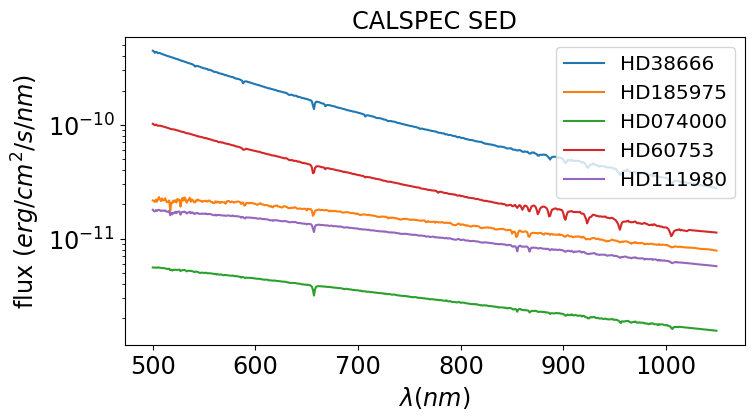

In [40]:
fig=plt.figure(figsize=(8,4))
ax=fig.add_subplot(1,1,1)

for targetid, f_sed  in dict_f_sed.items():

    sed = f_sed(WL)
    sed_m=-2.5*np.log10(sed)
    
    label= f"{targetid}"
    ax.plot(WL,sed,label=label)
    
ax.set_xlabel("$\\lambda (nm)$")
ax.set_ylabel("flux $(erg/cm^2/s/nm)$")
ax.set_title("CALSPEC SED")
ax.set_yscale('log')
ax.legend(loc='upper right')
#ax2=ax.twinx()
#ax2.plot(sed_w,sed_m,'r-')
#ax2.set_ylabel("mag")

# Throughputs

## Auxtel throughput and  telescope throughput

In [41]:
array = np.loadtxt(filename_auxtelthroughput)
dft = pd.DataFrame(data=array,columns=["lambda","throughput"])

In [42]:
#dft = pd.read_excel(filename_auxtelthroughput,header=1,index_col=0)
dft.reset_index(inplace=True)
dft['index'] = dft.reset_index().index
dft.set_index('index')
dft.rename(columns={'lambda':'lambdas'},inplace = True)

Text(0.5, 1.0, 'auxtel throughput')

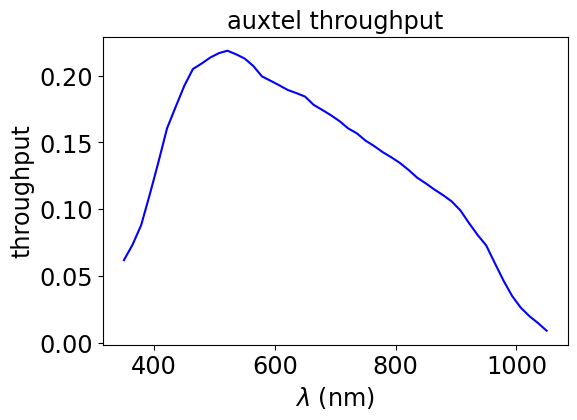

In [43]:
fig=plt.figure(figsize=(6,4))
ax=fig.add_subplot(111)
ax.plot(dft.lambdas,dft.throughput,"b-")
ax.set_xlabel("$\\lambda$ (nm)")
ax.set_ylabel("throughput")
ax.set_title("auxtel throughput")

In [44]:
# interpolation function
f_thr_auxtel = interpolate.interp1d(dft.lambdas,dft.throughput,bounds_error=False,fill_value="extrapolate")

## Filter throughput

In [45]:
arr = np.loadtxt(filename_filterthroughput)

In [46]:
wl_filt = arr[:,0]
tr_filt = arr[:,1]

Text(0.5, 1.0, 'filter throughput')

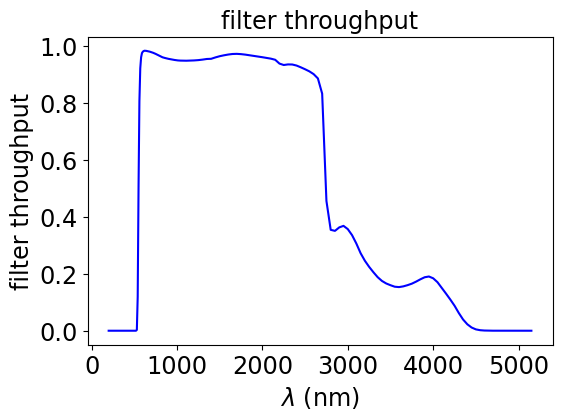

In [47]:
fig=plt.figure(figsize=(6,4))
ax=fig.add_subplot(111)
ax.plot(wl_filt,tr_filt,"b-")
ax.set_xlabel("$\\lambda$ (nm)")
ax.set_ylabel("filter throughput")
ax.set_title("filter throughput")

In [48]:
f_filter = interpolate.interp1d(wl_filt,tr_filt,bounds_error=False,fill_value="extrapolate")

In [49]:
tr_filter = f_filter(dft.lambdas)

## Combine throuputs

In [50]:
tr_combined = tr_filter* dft.throughput

Text(0.5, 1.0, 'auxtel-filter combined  throughput')

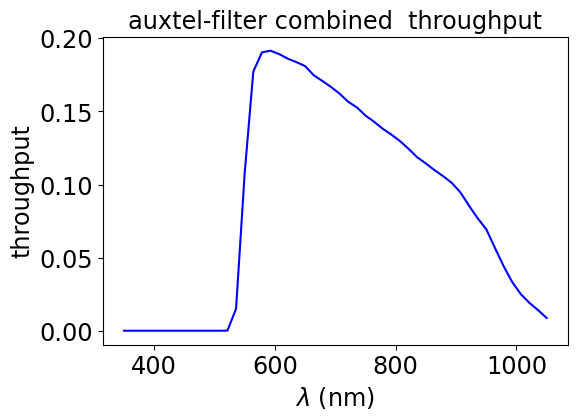

In [51]:
fig=plt.figure(figsize=(6,4))
ax=fig.add_subplot(111)
ax.plot(dft.lambdas,tr_combined,"b-")
ax.set_xlabel("$\\lambda$ (nm)")
ax.set_ylabel("throughput")
ax.set_title("auxtel-filter combined  throughput")

In [52]:
f_thr = interpolate.interp1d(dft.lambdas,tr_combined,bounds_error=False,fill_value="extrapolate")

## spectrum data

In [53]:
fullfilename=os.path.join(inputdir,inputfile)

In [54]:
with open(fullfilename, 'rb') as f:
    summary_content = pickle.load(f)

In [55]:
NBSPECTRA=len(summary_content)

In [56]:
msg=f" Number of selected files is {NBSPECTRA}"
logger.info(msg)

2023-02-13 14:19:38,717 MacBook-Pro-de-admin.local __main__[89187] INFO  Number of selected files is 71


In [57]:
# wavelength bin colors
jet = plt.get_cmap('jet')
cNorm = colors.Normalize(vmin=0, vmax=NBSPECTRA)
scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=jet)
all_colors = scalarMap.to_rgba(np.arange(NBSPECTRA), alpha=1)

### Read all files

In [58]:
normalisationfactor

1.0

In [59]:
infos, all_spectra = GetSpectra(summary_content,factor = normalisationfactor)

In [60]:
N=len(infos)

In [61]:
NX=4
NY=N/NX

In [62]:
if NY != int(NY):
    NY= int(NY)+1
else:
    NY=int(NY)

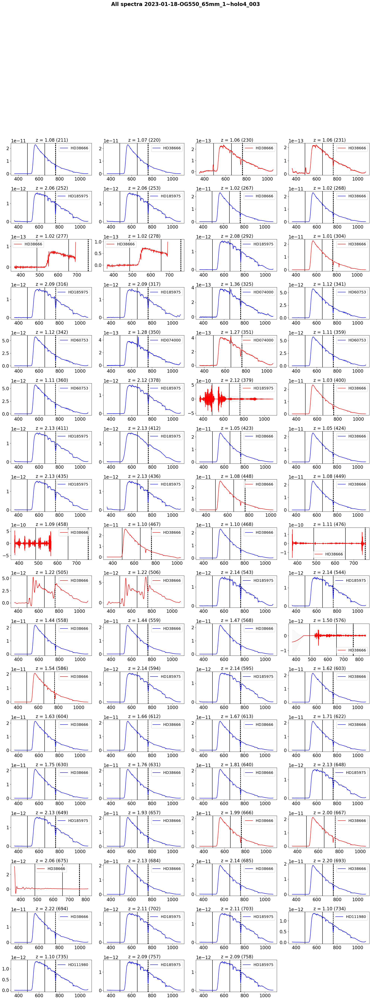

In [63]:
fig = plt.figure(figsize=(20,NY*3))

ny=0
nx=0

for idx in range(N):
    iy = idx//NX
    ix = (idx-iy*NX)
    
    ax=fig.add_subplot(NY,NX,idx+1)
    
    
    
    the_df=all_spectra[idx]
    
    airmassvalue = infos.iloc[idx]["airmass"]
    num = infos.iloc[idx]["number"]
    label_airmass = f" z = {airmassvalue:.2f} ({num})"
    the_target = infos.iloc[idx]["object"]
    
    #ax.plot(the_df.wavelength,the_df.flux,color=all_colors[ifile])
    if num in list_of_badnums1:
        thecolor="r"
    else:
        thecolor="b"
    
    ax.errorbar(the_df["all_lambdas"],the_df['all_fluxes'],yerr=the_df["all_fluxes_err"], fmt = '-', color=thecolor,capsize = 0.01, ecolor="k", elinewidth = .01,label=the_target)
    ax.set_title(label_airmass)
    
    ax.axvline(HBETA.wavelength,linestyle="-",color="k")
    ax.axvline(HALPHA.wavelength,linestyle="-",color="k")
    
    # O2 line
    ax.axvline(O2_1.wavelength,linestyle="--",color="k")
    #ax.annotate(O2_1.label, xy=(O2_1.wavelength-5, FLUXLIMMAX/2), color='blue',fontsize=20,fontweight='bold')

    ax.axvline(O2_2.wavelength,linestyle="--",color="k")
    #ax.annotate(O2_2.label, xy=(O2_2.wavelength, ypos), color='blue',fontsize=20,fontweight='bold')
    
    ax.legend()
    
the_title = f"All spectra {DATE}-{filterdisperser}"

plt.suptitle(the_title,size=20,fontweight='bold',y=0.99)    
plt.tight_layout()
plt.subplots_adjust(top=0.85)

fig_filename = f"fig_01-{DATE}-{filterdisperser}-allspectra.pdf"
plt.savefig(fig_filename)
plt.show()

# Remove bad Spectra

/var/folders/rk/cnrspsj13_3cgmh8p4m_mxww0000gp/T/ipykernel_89187/3308870561.py:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='center')


Text(0.5, 1.0, 'nb of spectra per target before spectra selection ')

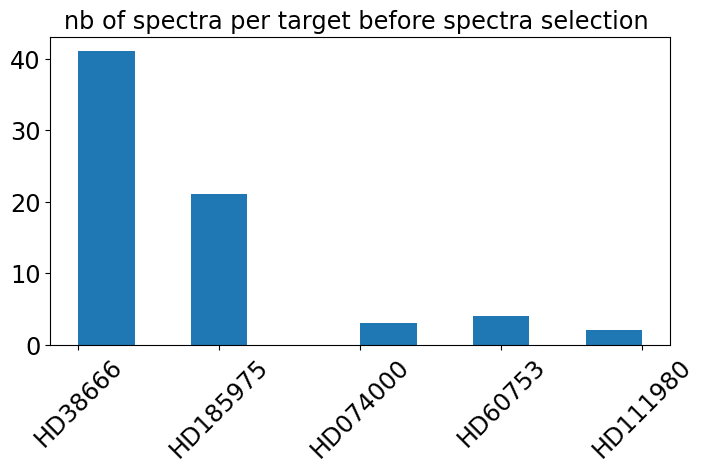

In [64]:
fig = plt.figure(figsize=(8,4))
ax=fig.add_subplot(1,1,1)
ax.hist(infos.object);
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='center')
ax.set_title("nb of spectra per target before spectra selection ")

Text(0.5, 0.98, 'Variables to apply selection')

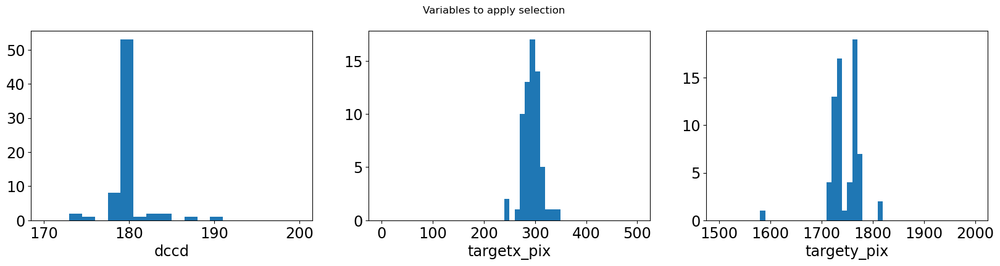

In [65]:
fig = plt.figure(figsize=(20,4))
ax=fig.add_subplot(1,3,1)
ax.hist(infos.d2ccd,bins=20,range=(170,200));
ax.set_xlabel("dccd")
ax=fig.add_subplot(1,3,2)
ax.hist(infos.targetx_pix,bins=50,range=(0,500));
ax.set_xlabel("targetx_pix")
ax=fig.add_subplot(1,3,3)
ax.hist(infos.targety_pix,bins=50,range=(1500,2000));
ax.set_xlabel("targety_pix")
plt.suptitle("Variables to apply selection")

## Define selection cut

In [66]:
#selection_cut = ((infos.d2ccd > 178) & (infos.d2ccd < 182)) & (infos.object == target)
selection_cut = ((infos.d2ccd > 178) & (infos.d2ccd < 182))
bad_cut = ~selection_cut

In [67]:
list_of_badnums2 = infos[bad_cut]["number"].values
list_of_badnums2 

array([230, 351, 448, 458, 467, 476, 576, 586, 666, 667])

# Union of badnums

In [68]:
list_of_badnums = np.union1d(list_of_badnums1,list_of_badnums2)
list_of_badnums=np.unique(list_of_badnums)

# Filtered spectra : remove bad spectra

In [69]:
list_of_badnums

array([230, 231, 277, 278, 304, 351, 379, 400, 448, 458, 467, 476, 505,
       506, 576, 586, 666, 667, 675])

In [70]:
infos, all_spectra = GetSpectraFiltered(summary_content,list_of_bad_spectra=list_of_badnums,factor = normalisationfactor)

Remove spectrum 2 for exposure 230
Remove spectrum 3 for exposure 231
Remove spectrum 8 for exposure 277
Remove spectrum 9 for exposure 278
Remove spectrum 11 for exposure 304
Remove spectrum 18 for exposure 351
Remove spectrum 22 for exposure 379
Remove spectrum 23 for exposure 400
Remove spectrum 30 for exposure 448
Remove spectrum 32 for exposure 458
Remove spectrum 33 for exposure 467
Remove spectrum 35 for exposure 476
Remove spectrum 36 for exposure 505
Remove spectrum 37 for exposure 506
Remove spectrum 43 for exposure 576
Remove spectrum 44 for exposure 586
Remove spectrum 58 for exposure 666
Remove spectrum 59 for exposure 667
Remove spectrum 60 for exposure 675


In [71]:
print("Number of spectra : ",len(all_spectra))

Number of spectra :  52


In [72]:
infos.reset_index(drop=True, inplace=True)

In [73]:
infos

,number,object,dateobs,refhour,airmass,pressure,temperature,humidity,filename,targetx_pix,targety_pix,rotangle,d2ccd
0,211,HD38666,2023-01-19T00:54:29.923007271Z,-3.087228,1.078479,0,0,0,2023011800211,248.234326,1732.468544,0.228422,180.140554
1,220,HD38666,2023-01-19T00:59:57.036990263Z,-2.996363,1.069996,0,0,0,2023011800220,242.321785,1734.470137,0.224652,180.157242
2,252,HD185975,2023-01-19T01:27:35.395008735Z,-2.535708,2.058078,0,0,0,2023011800252,282.846208,1776.201684,0.436762,180.106956
3,253,HD185975,2023-01-19T01:28:18.197490329Z,-2.523818,2.058515,0,0,0,2023011800253,282.855286,1779.107865,0.442411,180.053015
4,267,HD38666,2023-01-19T01:40:08.188998340Z,-2.326598,1.023673,0,0,0,2023011800267,292.747118,1768.489070,0.189878,179.415913
5,268,HD38666,2023-01-19T01:40:51.200005903Z,-2.314651,1.023086,0,0,0,2023011800268,295.340583,1768.451393,0.192723,179.586694
6,292,HD185975,2023-01-19T01:58:49.768499413Z,-2.015048,2.076251,0,0,0,2023011800292,304.184467,1772.654996,0.444434,180.398617
7,316,HD185975,2023-01-19T02:28:12.480994287Z,-1.525406,2.092601,0,0,0,2023011800316,305.882807,1778.849342,0.430714,180.172694
8,317,HD185975,2023-01-19T02:28:55.326491866Z,-1.513504,2.092969,0,0,0,2023011800317,301.088935,1776.993049,0.434735,180.181846
9,325,HD074000,2023-01-19T02:34:40.316998221Z,-1.417674,1.359381,0,0,0,2023011800325,292.421276,1733.749306,0.274512,180.175885


/var/folders/rk/cnrspsj13_3cgmh8p4m_mxww0000gp/T/ipykernel_89187/3614807563.py:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='center')


Text(0.5, 1.0, 'nb of spectra per target after spectra selection ')

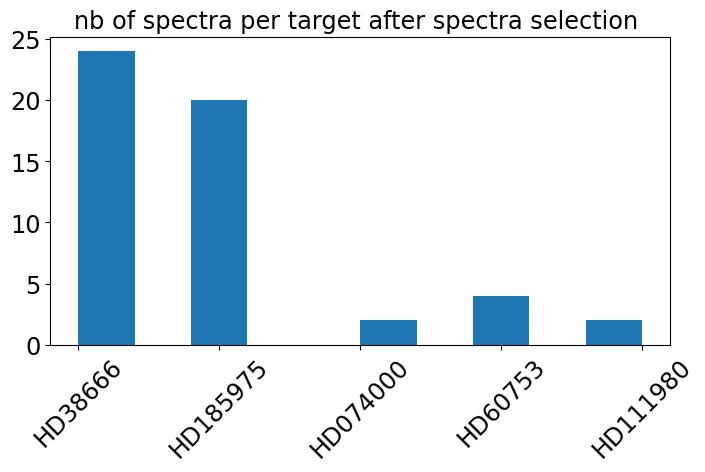

In [74]:
fig = plt.figure(figsize=(8,4))
ax=fig.add_subplot(1,1,1)
ax.hist(infos.object);
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='center')
ax.set_title("nb of spectra per target after spectra selection ")

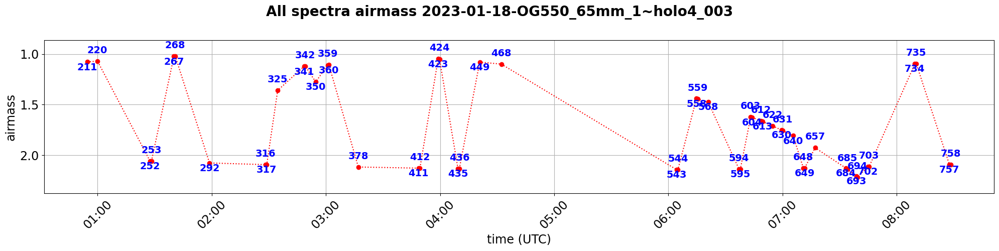

In [75]:
all_datetime = [ Time(str_time).to_datetime() for str_time in infos['dateobs'] ]
numbers = infos['number'].values
airmasses = infos['airmass'].values
N= len(numbers)

myFmt = mdates.DateFormatter('%H:%M')
ax.xaxis.set_major_formatter(myFmt)


# Create rectangle x coordinates
startTime = all_datetime[0]
endTime =  datetime(2023, 1, 31, 0, 0, 0, 0),

# convert to matplotlib date representation
start = mdates.date2num(startTime)
end = mdates.date2num(endTime)
width = end - start



fig=plt.figure(figsize=(20,5))
ax=fig.add_subplot(111)
#ax.plot(all_datetime,grey_attenuation,'bo:')
#ax.grid()
#plt.gcf().autofmt_xdate()
#ax.xaxis.set_major_formatter(myFmt)
#ax.xaxis.set_tick_params(rotation=45)
#ax.set_xlabel("time (UTC)")
#ax.set_title(f"Grey attenuation : {DATE} ({filterdisperser}, {target})")
#ax.set_ylabel("attenuation")
#ax2 = ax.twinx()

y_shift= 0.08

ax2=ax
ax2.plot(all_datetime,airmasses,'r:o')
ax2.xaxis.set_major_formatter(myFmt)
ax2.xaxis.set_tick_params(rotation=45)
ax2.set_xlabel("time (UTC)")
ax2.set_ylabel("airmass")
ax2.set_ylim(airmasses.min()-2*y_shift,airmasses.max()+2*y_shift)
# Plot rectangle
#rect = plt.Rectangle((start, airmasses.min()-2*y_shift), width, airmasses.max()+ 2*y_shift, color='grey',alpha=0.3)
#ax2.add_patch(rect)   
ax2.invert_yaxis()
ax2.grid()


for index in range(N):
    textstr= str(numbers[index])
    if index%2 == 0:
        dy = y_shift
    else:
        dy = -y_shift
            
    ax2.text(all_datetime[index], airmasses[index] + dy , textstr,fontsize=14,fontweight="bold",ha='center',color="b" )
    
the_title = f"All spectra airmass {DATE}-{filterdisperser}"
plt.suptitle(the_title,size=20,fontweight='bold',y=0.99)    
plt.tight_layout()
plt.subplots_adjust(top=0.85)

fig_filename = f"fig_02-{DATE}-{filterdisperser}-airmasses.pdf"
plt.savefig(fig_filename)
plt.show()

# Simulate atmospheric transparency

In [76]:
emul = SimpleAtmEmulator()

In [77]:
NBINFOS = len(infos)
dict_func_atm = {}
print(NBINFOS)

pwv0 = 3
oz0 = 300.
ncomp=0

for ispec in range(NBINFOS):
    the_infos = infos.iloc[ispec]
    the_airmass = the_infos["airmass"]
    the_number = the_infos["number"]
    
    transm = emul.GetAllTransparencies(WL,the_airmass,pwv0,oz0,ncomp=ncomp,flagAerosols=False)
    dict_func_atm[the_number] = interpolate.interp1d(WL,transm,bounds_error=False,fill_value="extrapolate")

52


In [78]:
# wavelength bin colors
jet = plt.get_cmap('jet')
cNorm = colors.Normalize(vmin=0, vmax=NBINFOS)
scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=jet)
all_colors = scalarMap.to_rgba(np.arange(NBINFOS), alpha=1)

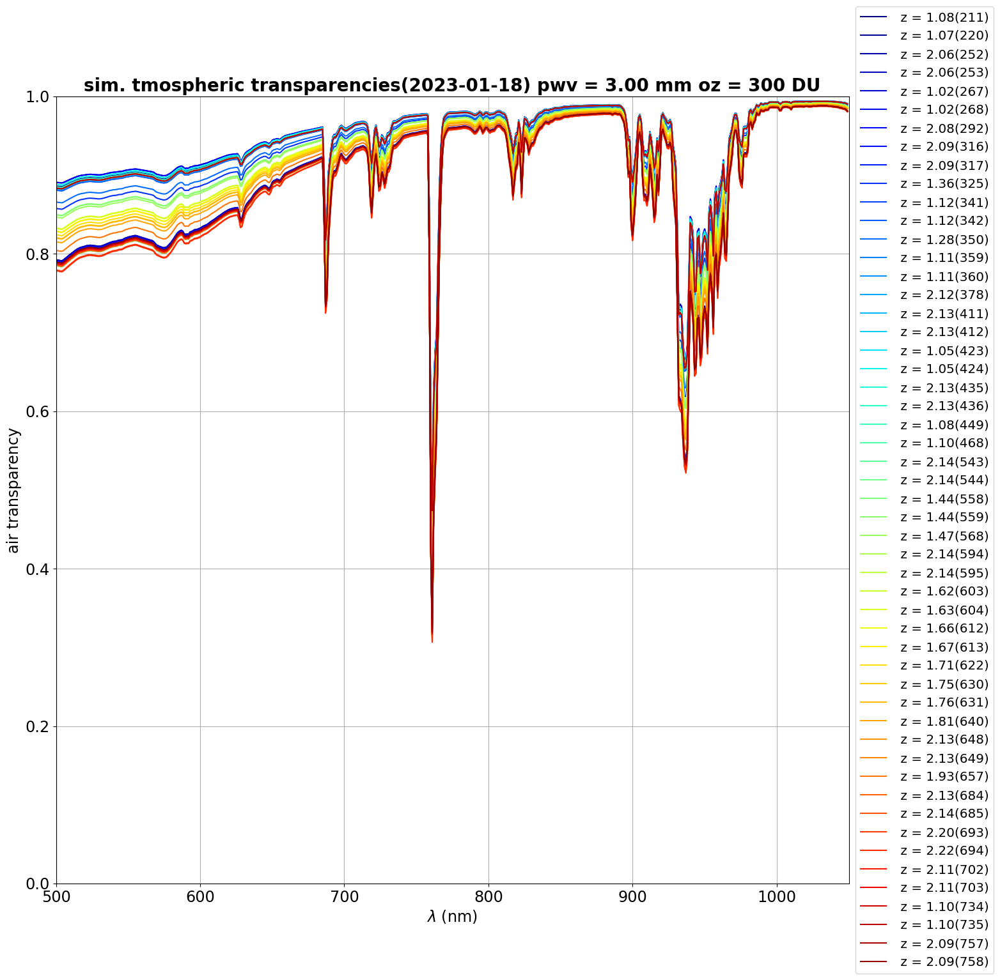

In [79]:
fig=plt.figure(figsize=(16,16))
ax=fig.add_subplot(111)
for isim in np.arange(NBINFOS):
    
    airmassvalue = infos.iloc[isim]["airmass"]
    the_number = infos.iloc[isim]["number"]
    label_airmass = f" z = {airmassvalue:.2f}({the_number})"

    atm = dict_func_atm[the_number](WL)
    
    ax.plot(WL,atm, color=all_colors[isim],label=label_airmass)

ax.grid()
ax.set_xlabel("$\lambda$ (nm)")
ax.set_ylabel("air transparency")
title=f"sim. tmospheric transparencies({DATE}) pwv = {pwv0:.2f} mm oz = {oz0:.0f} DU"
ax.set_title(title,fontsize=20,fontweight='bold')

ax.set_xlim( WLMINSEL  , WLMAXSEL  )
ax.set_ylim(0.,1)
#ax.legend(loc="lower left",ncol=5)
#ax.legend(bbox_to_anchor=(1.02, 0.5))
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))


# Plot Spectra

In [80]:
NBSPECTRA=len(all_spectra)

In [81]:
assert NBSPECTRA == NBINFOS

In [82]:
# wavelength bin colors
jet = plt.get_cmap('jet')
cNorm = colors.Normalize(vmin=0, vmax=NBSPECTRA)
scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=jet)
all_colors = scalarMap.to_rgba(np.arange(NBSPECTRA), alpha=1)

In [83]:
msg=f" Number of good spectra is {NBSPECTRA}"
logger.info(msg)

2023-02-13 14:20:16,196 MacBook-Pro-de-admin.local __main__[89187] INFO  Number of good spectra is 52


### load absorption pattern

In [84]:
df = pd.read_csv("data/absorption_pattern.csv")
wlpt,o2,o3,h2o,no2 = atmpatt_Dataf_to_np(df)

In [85]:
def plotlines(ax,ypos):
    
    ax.axvline(HDELTA.wavelength,color='orange')
    ax.annotate(HDELTA.label, xy=(HDELTA.wavelength, ypos), color='orange',fontsize=20,fontweight='bold')
    
    ax.axvline(HGAMMA.wavelength,color='orange')
    ax.annotate(HGAMMA.label, xy=(HGAMMA.wavelength, ypos), color='orange',fontsize=20,fontweight='bold')
    
    ax.axvline(HBETA.wavelength,color='orange')
    ax.annotate(HBETA.label, xy=(HBETA.wavelength, ypos), color='orange',fontsize=20,fontweight='bold')
    
    ax.axvline(HALPHA.wavelength,color='orange')
    ax.annotate(HALPHA.label, xy=(HALPHA.wavelength, ypos), color='orange',fontsize=20,fontweight='bold')

    ax.axvline(O2B.wavelength,color="blue")
    ax.annotate(O2B.label, xy=(O2B.wavelength, ypos), color='blue',fontsize=20,fontweight='bold')

    ax.axvline(O2_1.wavelength,color="blue")
    #ax.annotate(O2_1.label, xy=(O2_1.wavelength-5, FLUXLIMMAX/2), color='blue',fontsize=20,fontweight='bold')

    ax.axvline(O2_2.wavelength,color="blue")
    ax.annotate(O2_2.label, xy=(O2_2.wavelength, ypos), color='blue',fontsize=20,fontweight='bold')

    ax.axvline(H2O_1.wavelength,color="blue")
    ax.annotate(H2O_1.label, xy=(H2O_1.wavelength, ypos), color='blue',fontsize=20,fontweight='bold')
    
    ax.axvline(H2O_2.wavelength,color="blue")
    ax.annotate(H2O_2.label, xy=(H2O_2.wavelength, ypos), color='blue',fontsize=20,fontweight='bold')
    

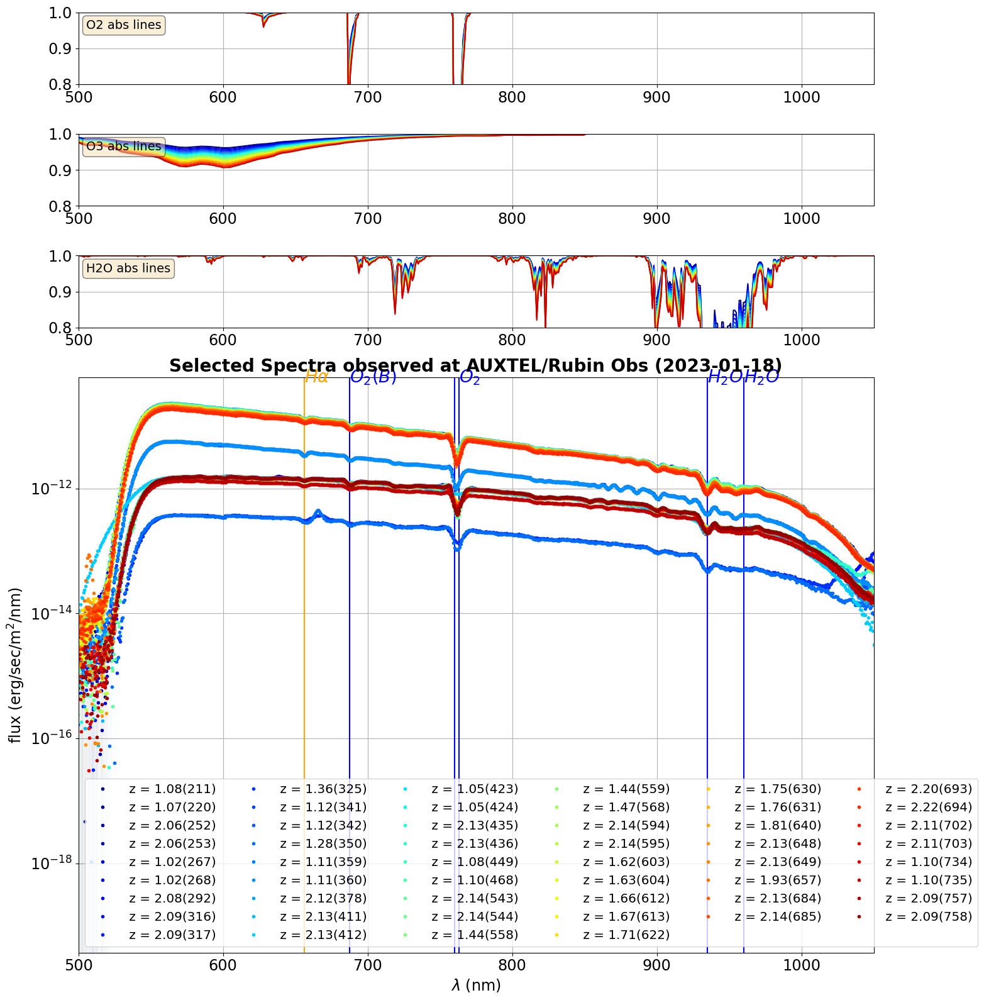

In [86]:
figsize=(16,16)

NOBS = o2.shape[1]
# wavelength bin colors
jet = plt.get_cmap('jet')
cNorm = colors.Normalize(vmin=0, vmax=NOBS)
scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=jet)
all_colors = scalarMap.to_rgba(np.arange(NOBS), alpha=1)

props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)

fig=plt.figure(figsize=figsize)
title =f"Spectra (hologram) {SITE} ({DATE})"


#gs = gridspec.GridSpec(5, 1,height_ratios=[0.5,0.5,0.5,0.5,4] ,figure=fig)
gs = gridspec.GridSpec(4, 1,height_ratios=[0.5,0.5,0.5,4] ,figure=fig)

#=========================================================== NO2    
#ax=fig.add_subplot(gs[0,0])
#for index in np.arange(NOBS):   
#    ax.plot(wlpt,no2[:,index],'-',color=all_colors[index])
#ax.set_ylim(0.8,1)
#ax.set_xlim(WLMINSEL,WLMAXSEL)
#ax.grid()
#textstr = "NO2 abs lines"
# place a text box in upper left in axes coords
#ax.text(0.01, 0.90, textstr, transform=ax.transAxes, fontsize=14,
#        verticalalignment='top', bbox=props)
#ax.set_title(title,fontsize=20,fontweight='bold')
#main_ax = ax



#=========================================================== O2    
#ax=fig.add_subplot(gs[0,0], sharex=main_ax)
ax=fig.add_subplot(gs[0,0])
for index in np.arange(NOBS):   
    ax.plot(wlpt,o2[:,index],'-',color=all_colors[index])
ax.set_ylim(0.8,1)
ax.set_xlim(WLMINSEL,WLMAXSEL)
ax.grid()
textstr = "O2 abs lines"
# place a text box in upper left in axes coords
ax.text(0.01, 0.90, textstr, transform=ax.transAxes, fontsize=14,
        verticalalignment='top', bbox=props)
#ax.set_title(title)
main_ax = ax

#=========================================================== Ozone
ax=fig.add_subplot(gs[1,0], sharex=main_ax)
for index in np.arange(NOBS):   
    ax.plot(wlpt,o3[:,index],'-',color=all_colors[index])
ax.set_ylim(0.8,1)
ax.set_xlim(WLMINSEL,WLMAXSEL)
ax.grid()
textstr = "O3 abs lines"
# place a text box in upper left in axes coords
ax.text(0.01, 0.90, textstr, transform=ax.transAxes, fontsize=14,
        verticalalignment='top', bbox=props)


#=========================================================== H2O
ax=fig.add_subplot(gs[2,0], sharex=main_ax)

for index in np.arange(NOBS):   
    ax.plot(wlpt,h2o[:,index],'-',color=all_colors[index])
ax.set_ylim(0.8,1)
ax.grid()
textstr = "H2O abs lines"
# place a text box in upper left in axes coords
ax.text(0.01, 0.90, textstr, transform=ax.transAxes, fontsize=14,
        verticalalignment='top', bbox=props)


#================================================= spectra
ax=fig.add_subplot(gs[3,0], sharex=main_ax)

# wavelength bin colors
jet = plt.get_cmap('jet')
cNorm = colors.Normalize(vmin=0, vmax=NBSPECTRA)
scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=jet)
all_colors = scalarMap.to_rgba(np.arange(NBSPECTRA), alpha=1)
all_numbers = infos['number'].values



for ifile in np.arange(NBSPECTRA):
    the_df=all_spectra[ifile]
    
    airmassvalue = infos.iloc[ifile]["airmass"]
    the_number = all_numbers[ifile]
    label_airmass = f" z = {airmassvalue:.2f}({the_number})"

    #ax.plot(the_df.wavelength,the_df.flux,color=all_colors[ifile])
    ax.errorbar(the_df["all_lambdas"],the_df['all_fluxes'],yerr=the_df["all_fluxes_err"], fmt = '.', color=all_colors[ifile],capsize = 0.01, ecolor=all_colors[ifile], elinewidth = .01,label=label_airmass)
ax.grid()
ax.set_xlabel("$\lambda$ (nm)")
ax.set_ylabel("flux (erg/sec/m$^2$/nm)")
title=f"Selected Spectra observed at {SITE} ({DATE})"
ax.set_title(title,fontsize=20,fontweight='bold')
#ax.plot(sed_w,sed_f,'k-')
#ax.set_xlim(350,1000)
#ax.set_ylim(1e-14,1e-10)
#ax.set_ylim(FLUXLIMMIN,FLUXLIMMAX)
ax.set_yscale("log")
ax.legend(loc="lower left",ncol=6)
#ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

# draw abs lines
plotlines(ax,ypos=FLUXLIMMAX/2)

plt.tight_layout()


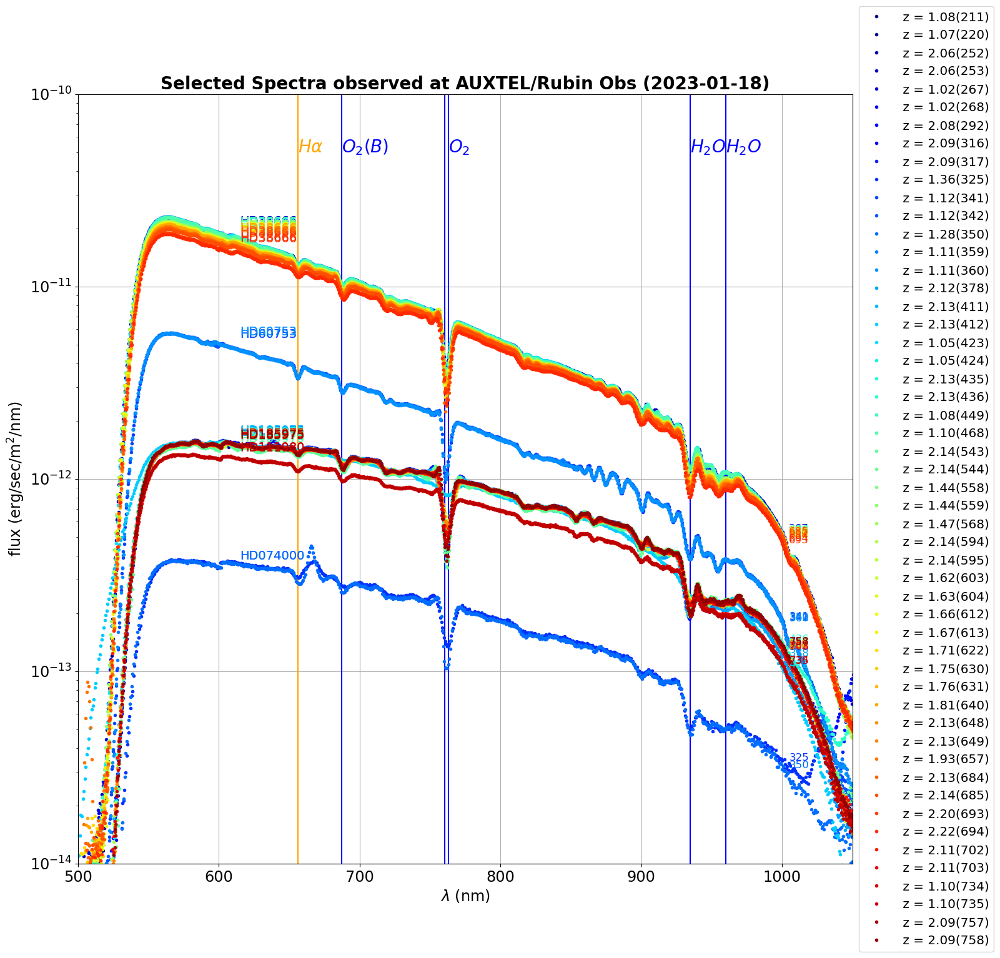

In [87]:
fig=plt.figure(figsize=(16,16))
ax=fig.add_subplot(111)
for ifile in np.arange(NBSPECTRA):
    the_df=all_spectra[ifile]
    
    airmassvalue = infos.iloc[ifile]["airmass"]
    the_number = all_numbers[ifile]
    label_airmass = f" z = {airmassvalue:.2f}({the_number})"

    #ax.plot(the_df.wavelength,the_df.flux,color=all_colors[ifile])
    ax.errorbar(the_df["all_lambdas"],the_df['all_fluxes'],yerr=the_df["all_fluxes_err"], fmt = '.', color=all_colors[ifile],capsize = 0.01, ecolor=all_colors[ifile], elinewidth = .01,label=label_airmass)

    f_flux = interpolate.interp1d(the_df["all_lambdas"].values,the_df['all_fluxes'].values,bounds_error=False,fill_value=0)
    x1=1000.
    y1=f_flux(x1)
    s1=str(the_number)
    x2=600
    y2=f_flux(x2)
    s2=infos.iloc[ifile]["object"]
    ax.text(x1+5, y1, s1, color=all_colors[ifile],fontsize=12)
    ax.text(x2+15, y2*1.1, s2, color=all_colors[ifile],fontsize=14)
    
ax.grid()
ax.set_xlabel("$\lambda$ (nm)")
ax.set_ylabel("flux (erg/sec/m$^2$/nm)")
title=f"Selected Spectra observed at {SITE} ({DATE})"
ax.set_title(title,fontsize=20,fontweight='bold')
#ax.plot(sed_w,sed_f,'k-')
ax.set_xlim( WLMINSEL  , WLMAXSEL  )
ax.set_ylim(FLUXLIMMIN,FLUXLIMMAX)
ax.set_yscale("log")
#ax.legend(loc="lower left",ncol=5)
#ax.legend(bbox_to_anchor=(1.02, 0.5))
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

# draw abs lines
plotlines(ax,ypos=FLUXLIMMAX/2)


In [88]:
correction_area = 1.06/1.13

In [89]:
#sed_predicted_f = f_sed(WL) * f_thr(WL) * f_atm(WL) 
#sed_predicted_m = -2.5*np.log10(sed_predicted_f) 

# Fit

## Select the identifier

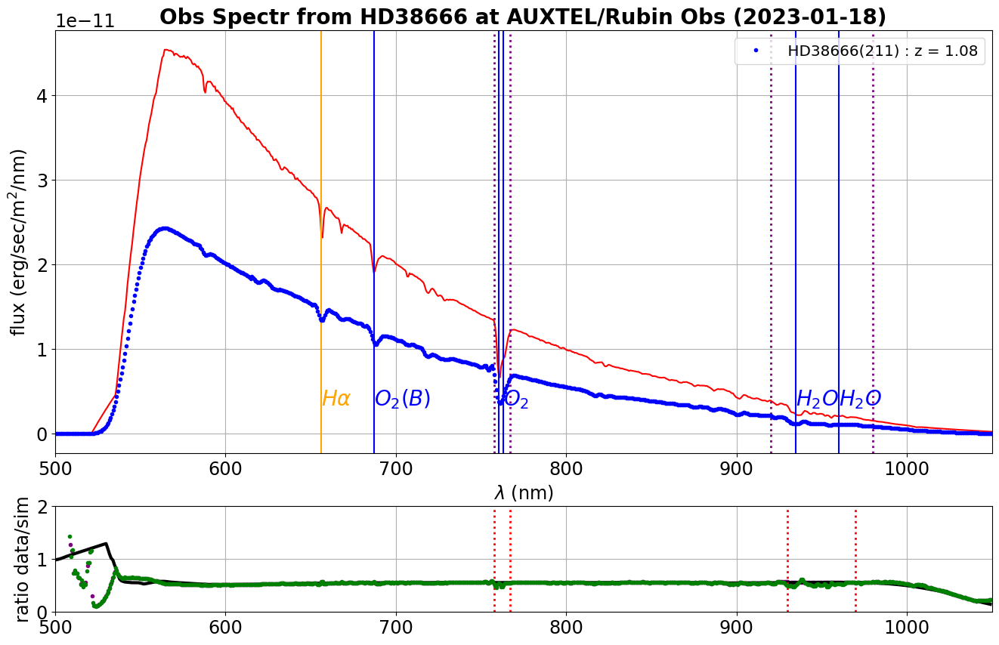

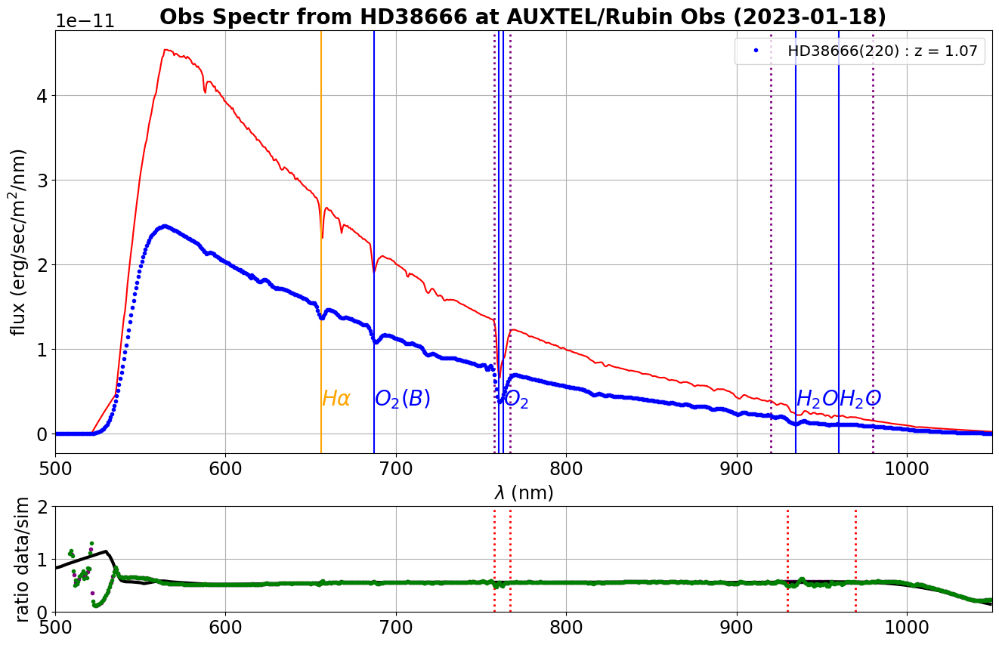

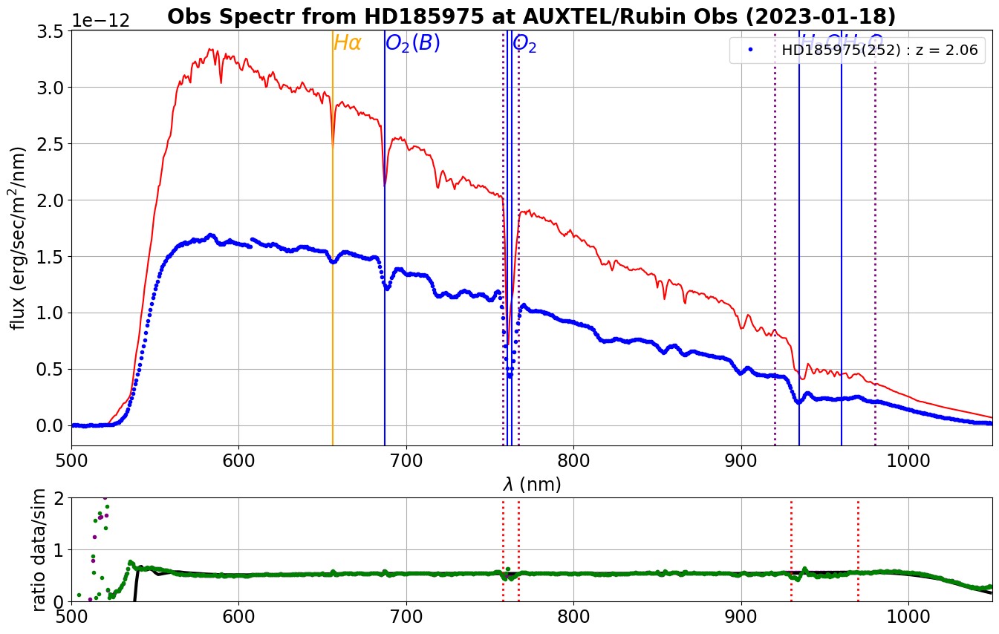

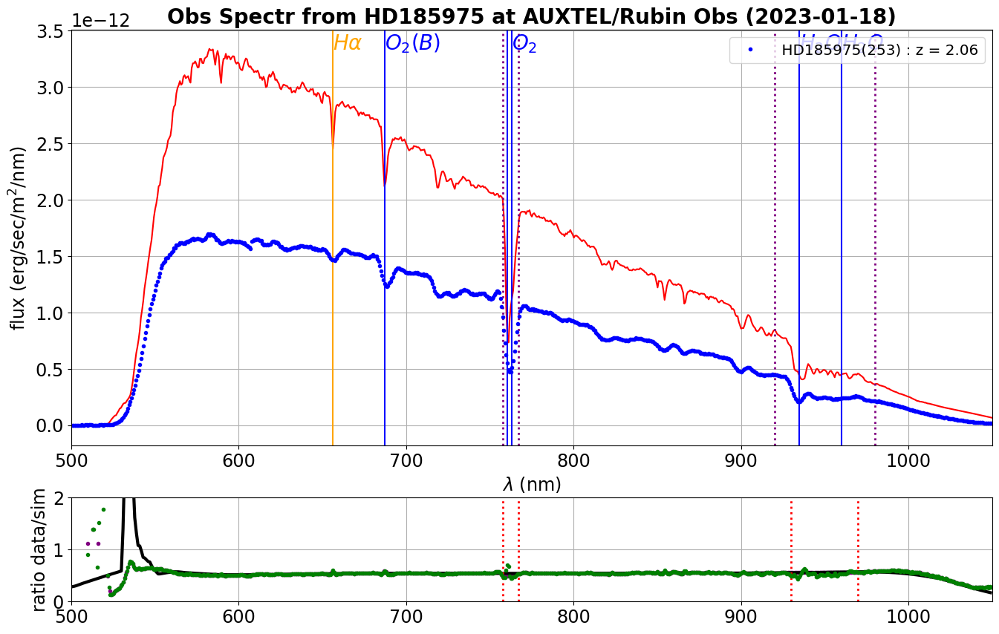

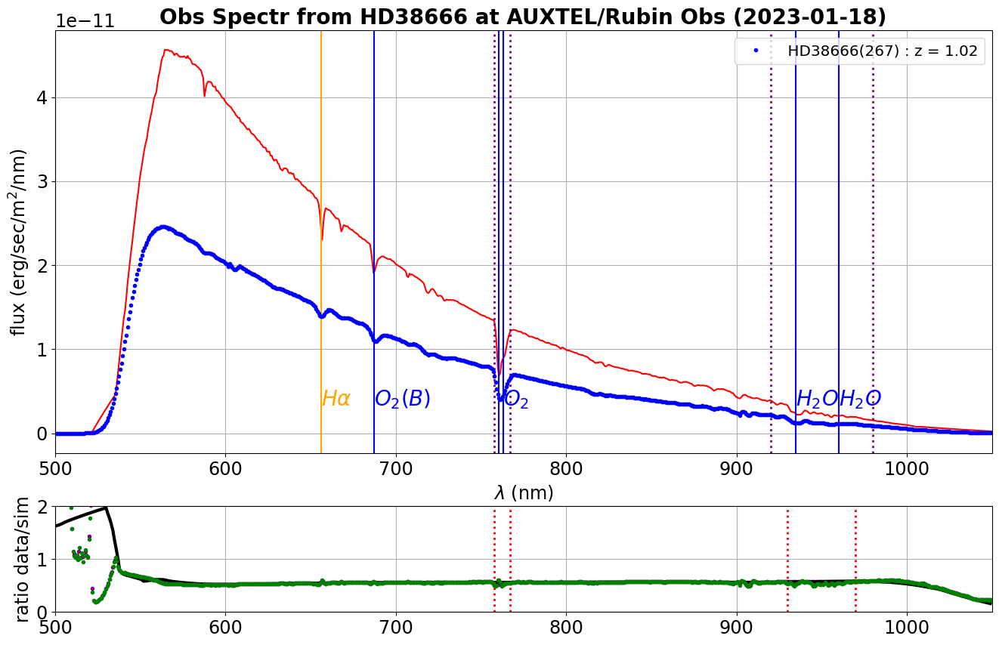

...

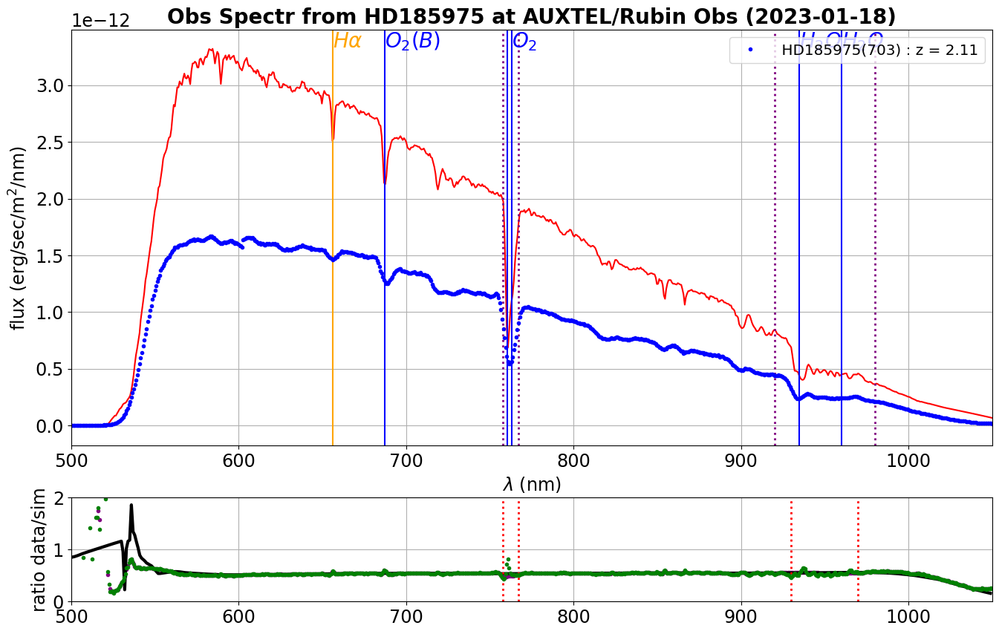

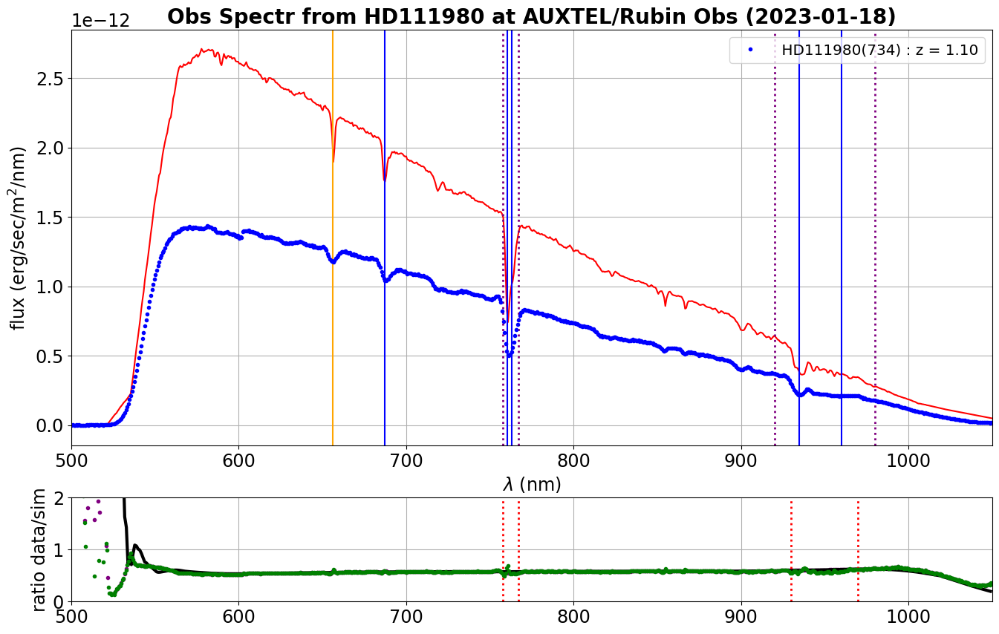

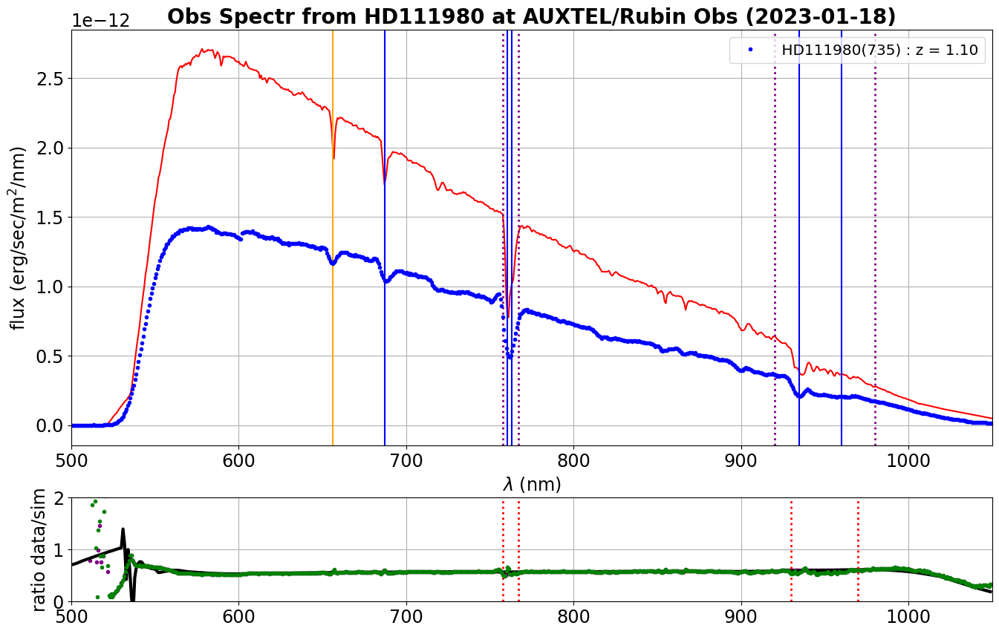

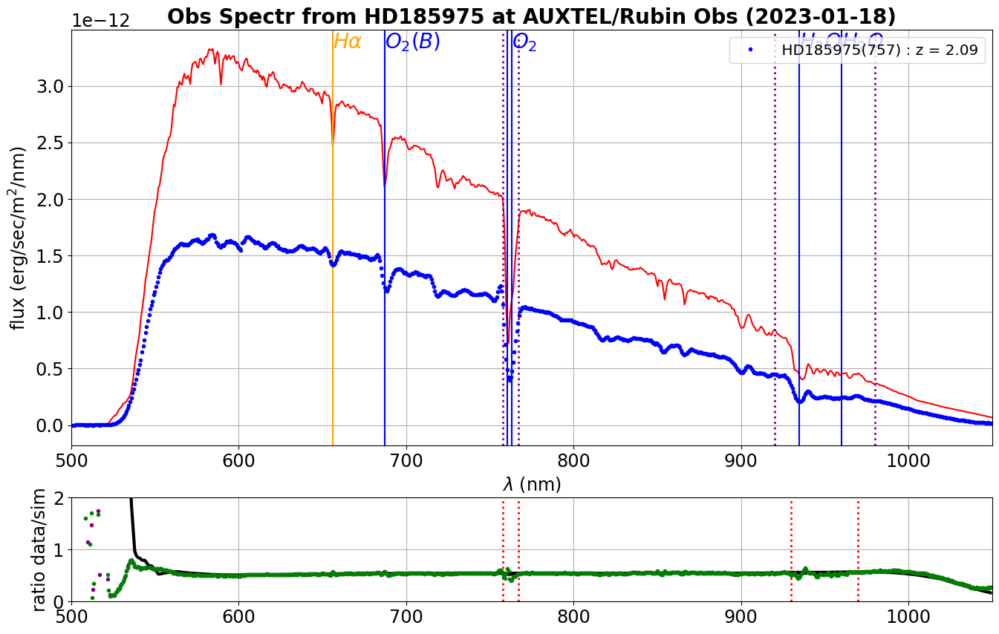

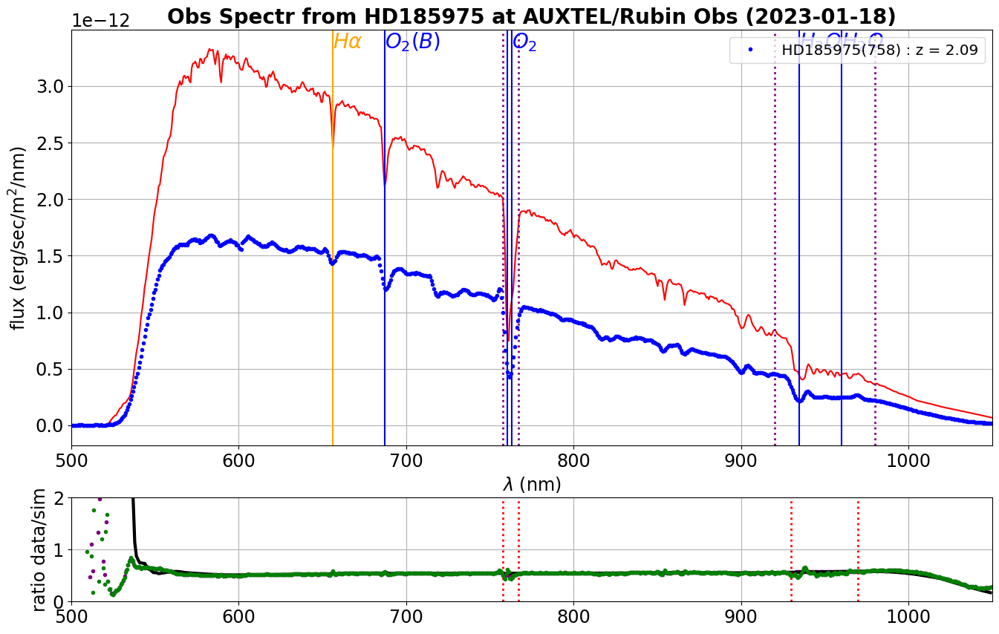

In [90]:
dict_ratio = {}
array_ratio = np.zeros((NBSPECTRA,len(WL)))

for idx in range(NBSPECTRA):
    
    fig=plt.figure(figsize=(16,10))
    gs = gridspec.GridSpec(2, 1,height_ratios=[4,1] ,figure=fig)


    # Fig 1
    ax=fig.add_subplot(gs[0,0])

    # extract spectrum from data
    the_df=all_spectra[idx]
    the_number = infos.iloc[idx]["number"]
    airmassvalue = infos.iloc[idx]["airmass"]
    target = infos.iloc[idx]["object"]
    label_airmass = f" {target}({the_number}) : z = {airmassvalue:.2f}"

    # the SED
    f_sed = dict_f_sed[target] 

    # atmosphere
    the_f_atm = dict_func_atm[the_number]

    # the throughput
    #f_thr

    # prediction
    the_wl = the_df["all_lambdas"].values
    the_sim = f_sed(the_wl) * the_f_atm(the_wl) * f_thr(the_wl)


    ax.errorbar(the_df["all_lambdas"],the_df['all_fluxes']/correction_area,yerr=the_df["all_fluxes_err"], fmt = '.',color="b",capsize = 0.01, ecolor=all_colors[ifile], elinewidth = .01,label=label_airmass)
    ax.plot(the_wl,the_sim,'-r')

    ax.grid()
    ax.set_xlabel("$\lambda$ (nm)")
    ax.set_ylabel("flux (erg/sec/m$^2$/nm)")
    title=f"Obs Spectr from {target} at {SITE} ({DATE})"
    ax.set_title(title,fontsize=20,fontweight='bold')
    #ax.plot(sed_w,sed_f,'k-',label="SED")
    #ax.plot(WL,sed_predicted_f,color='darkviolet',lw=4,label = "predicted flux")
    ax.set_xlim( WLMINSEL  , WLMAXSEL  )

    ax.legend(loc="upper right")
    # draw abs lines
    plotlines(ax,ypos=FLUXLIMMAX/30)
    
    ax.axvline(x=758,linewidth=2,linestyle=":" ,color='purple')
    ax.axvline(x=767,linewidth=2,linestyle=':', color='purple')
    
    ax.axvline(x=920,linewidth=2,linestyle=":" ,color='purple')
    ax.axvline(x=980,linewidth=2,linestyle=':', color='purple')
    

    main_ax = ax

    # Fig 2
    ax=fig.add_subplot(gs[1,0], sharex=main_ax)

    ax.errorbar(the_wl,the_df['all_fluxes']/correction_area/the_sim,yerr=the_df["all_fluxes_err"], fmt = '.',color="g",capsize = 0.01, ecolor=all_colors[ifile], elinewidth = .01,label=label_airmass)
    ratio = the_df['all_fluxes']/correction_area/the_sim
    
    # remove absorption line
    xcut1=758
    xcut2=767
    xcut3=925
    xcut4=970
    
    index_to_remove=np.where(np.logical_or(np.logical_and(the_wl>xcut1,the_wl<xcut2),np.logical_and(the_wl>xcut3,the_wl<xcut4)))[0]
    
                             
    new_the_wl = the_wl[~np.isin(np.arange(the_wl.size), index_to_remove)]
    new_ratio = ratio[~np.isin(np.arange(ratio.size), index_to_remove)]
    
    f_ratio = interpolate.interp1d(new_the_wl,new_ratio,bounds_error=False,fill_value="extrapolate")
    ratio_interp =f_ratio(WL)
    
                                
    ax.plot(WL,ratio_interp,'.',color="purple")

    span=30
    ratio_filtered = smooth_data_np_convolve(ratio_interp,span)
    ax.plot(WL,ratio_filtered,'k-',lw=3)
    
    
    dict_ratio[the_number] = ratio_filtered
    array_ratio[idx,:] = ratio_filtered
    
    ax.axvline(x=758,linewidth=2,linestyle=":" ,color='r')
    ax.axvline(x=767,linewidth=2,linestyle=':', color='r')
    
    ax.axvline(x=930,linewidth=2,linestyle=":" ,color='r')
    ax.axvline(x=970,linewidth=2,linestyle=':', color='r')

    ax.grid()
    ax.set_ylim(0,2)
    ax.set_ylabel("ratio data/sim")
    
    plt.show()



In [91]:
ratio_median = np.median(array_ratio,axis=0)

In [92]:
indexes_selected = np.where(np.logical_and(WL>=600, WL<=900))[0]
ratio_median_toextrapolate = np.median(ratio_median[indexes_selected])

In [93]:
ratio_median_toextrapolate

0.5449479191062904

In [94]:
indexes_selected[0]

100

In [95]:
ratio_median[:indexes_selected[0]] = ratio_median_toextrapolate
ratio_median[indexes_selected[-1]:] = ratio_median_toextrapolate

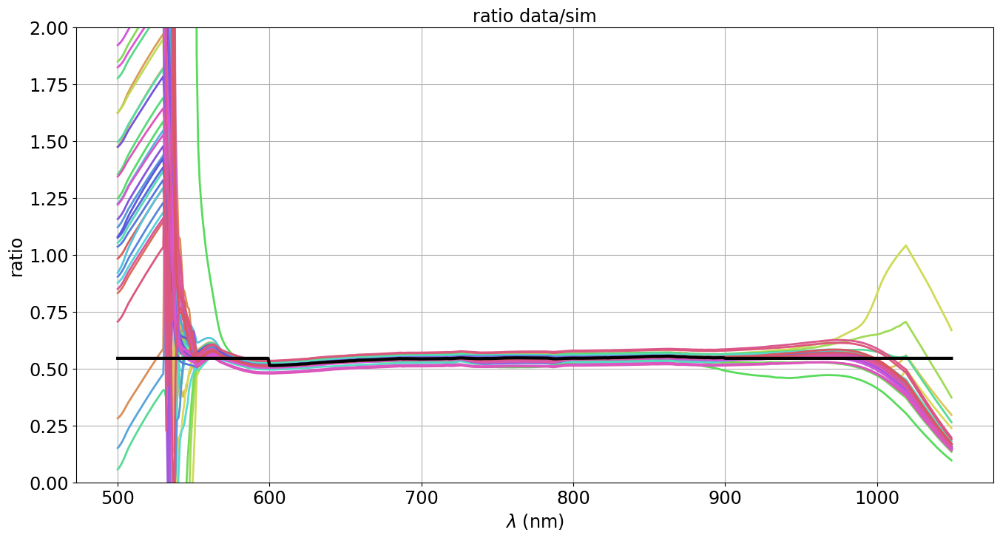

In [96]:
hls_colors = sns.color_palette("hls", NBSPECTRA)

fig=plt.figure(figsize=(16,8))
ax=fig.add_subplot(111)

idx=0
for key, value in dict_ratio.items():
    ax.plot(WL,value,"-",color=hls_colors[idx],lw=2)
    idx+=1
    
ax.plot(WL,ratio_median,'k-',lw=3)
ax.set_ylim(0,2)
ax.set_xlabel("$\lambda$ (nm)")  
ax.set_ylabel("ratio")
ax.set_title("ratio data/sim")

ax.grid()

Text(0.5, 1.0, 'Auxtel Throughput')

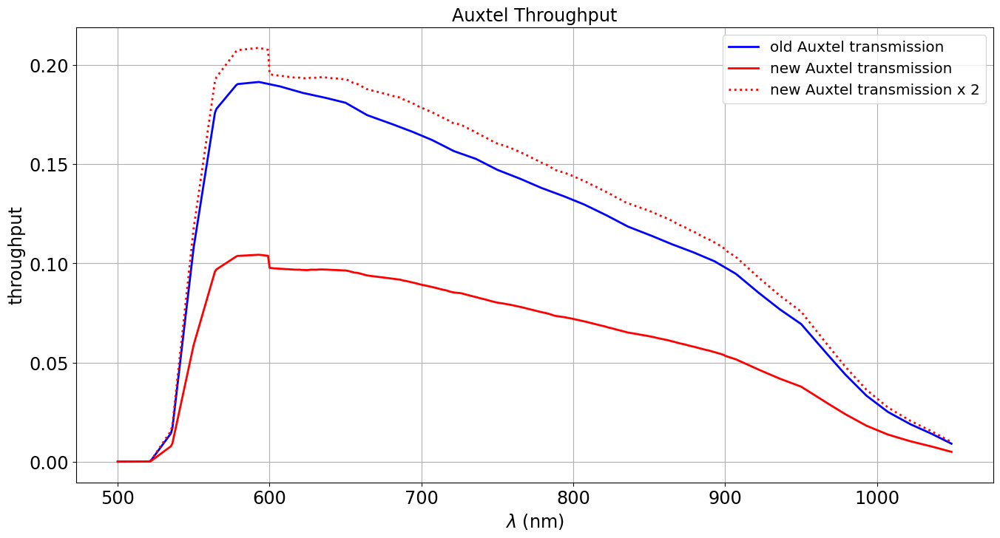

In [97]:
hls_colors = sns.color_palette("hls",2)

new_throughput = f_thr(WL)*ratio_median

fig=plt.figure(figsize=(16,8))
ax=fig.add_subplot(111)
ax.plot(WL,f_thr(WL),'b-',label = "old Auxtel transmission",lw=2) 
ax.plot(WL,new_throughput,'r-',label = "new Auxtel transmission",lw=2)
ax.plot(WL,2*new_throughput,'r:',label = "new Auxtel transmission x 2",lw=2)
ax.legend()
ax.grid()
ax.set_xlabel("$\lambda$ (nm)")  
ax.set_ylabel("throughput")
ax.set_title("Auxtel Throughput")

## New fittable 

In [98]:
f_thr_new = interpolate.interp1d(WL,new_throughput,bounds_error=False,fill_value="extrapolate")

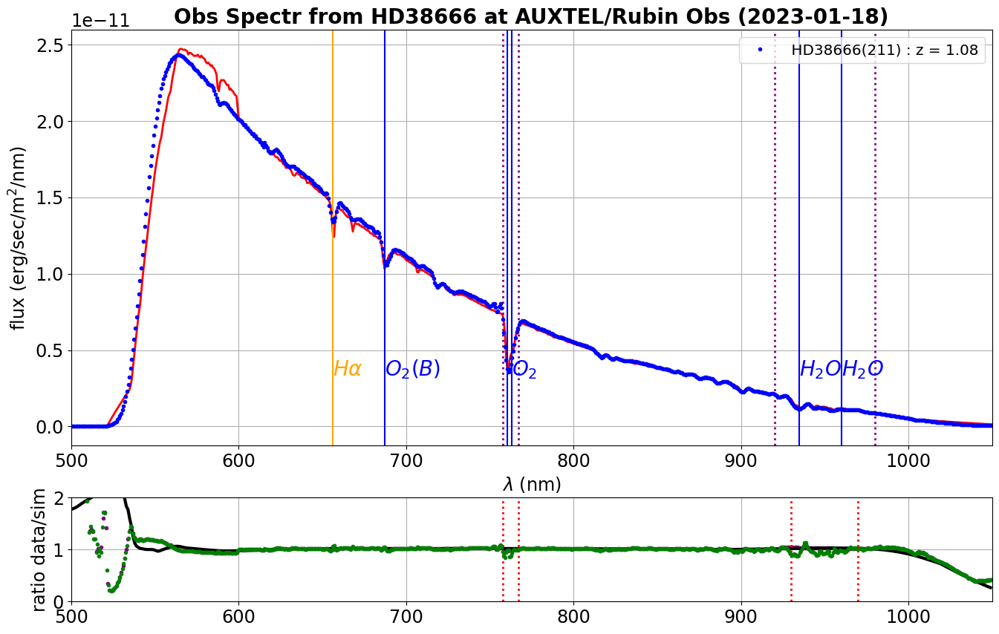

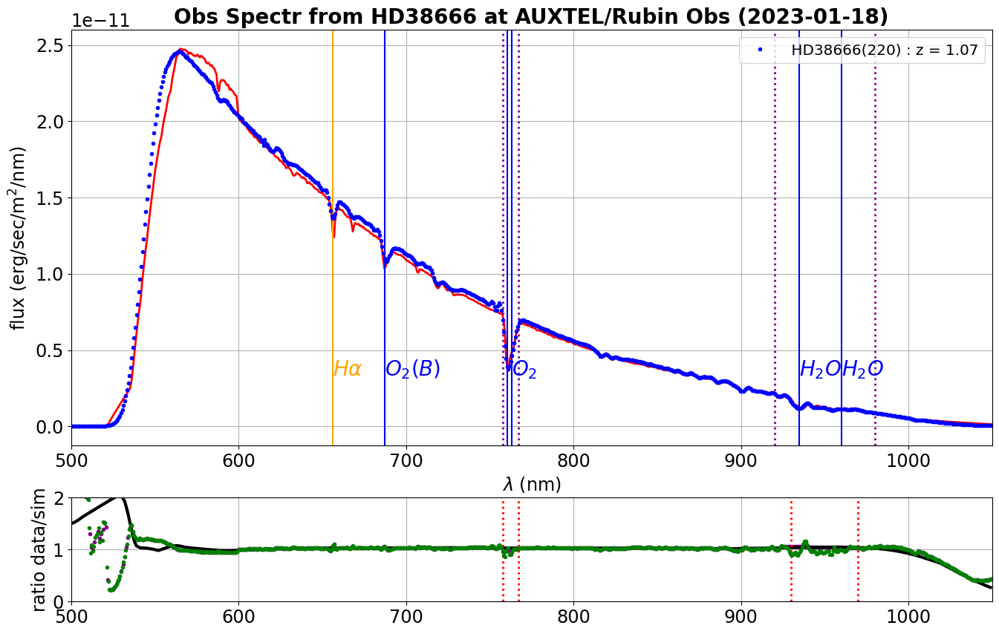

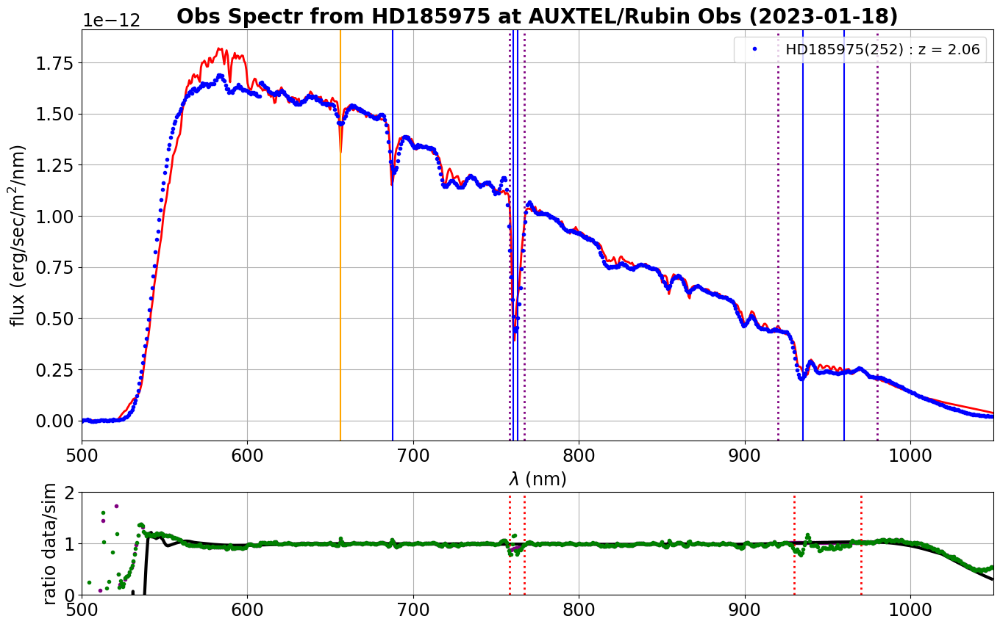

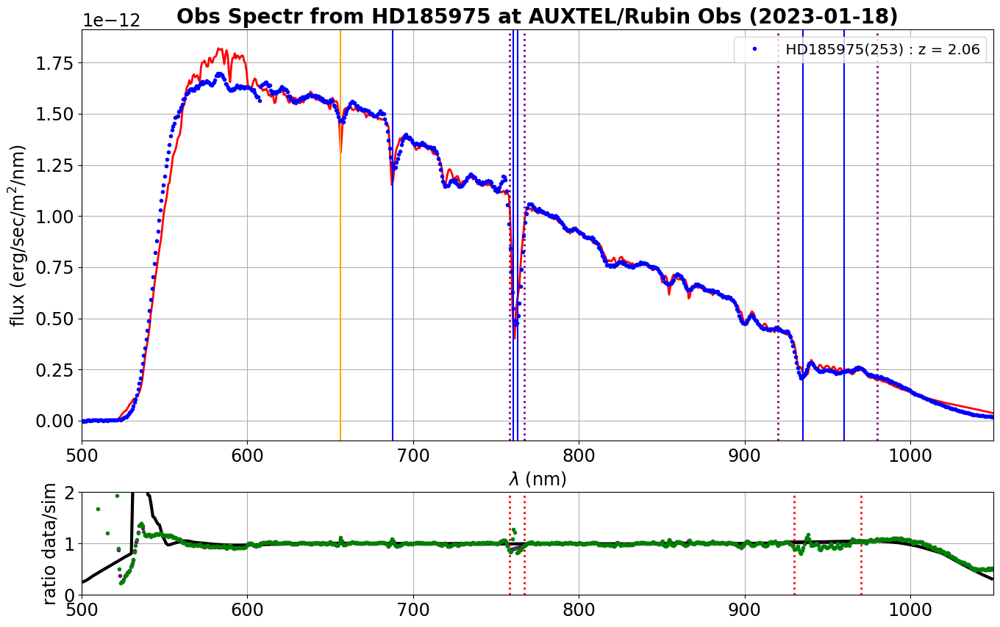

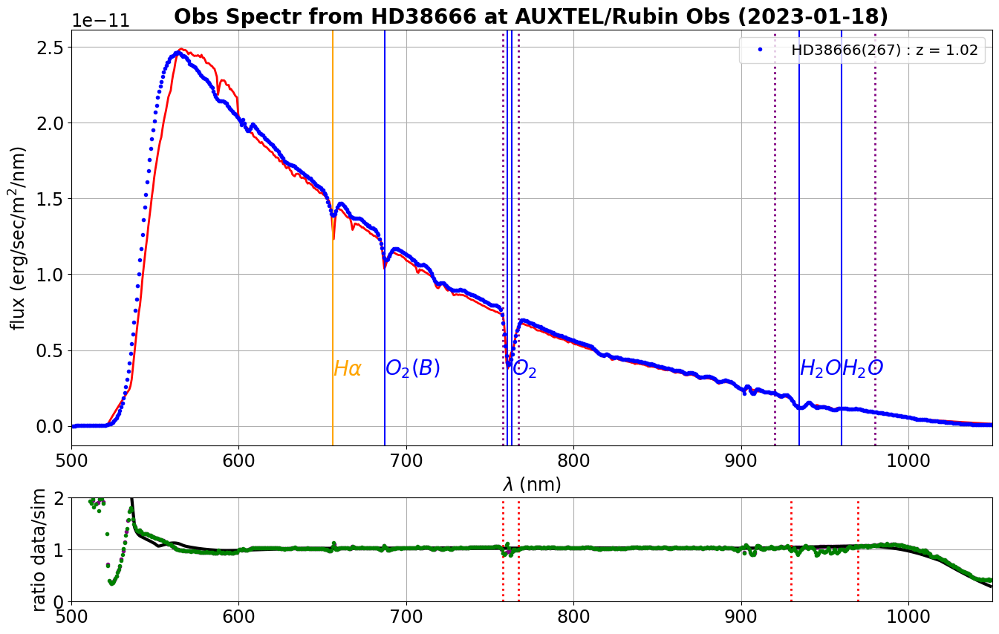

...

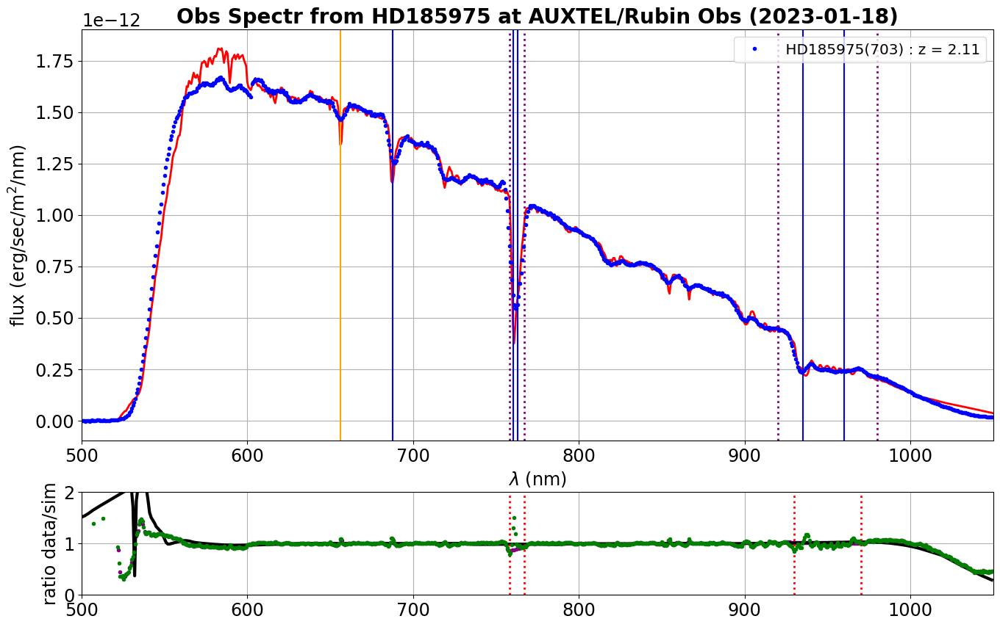

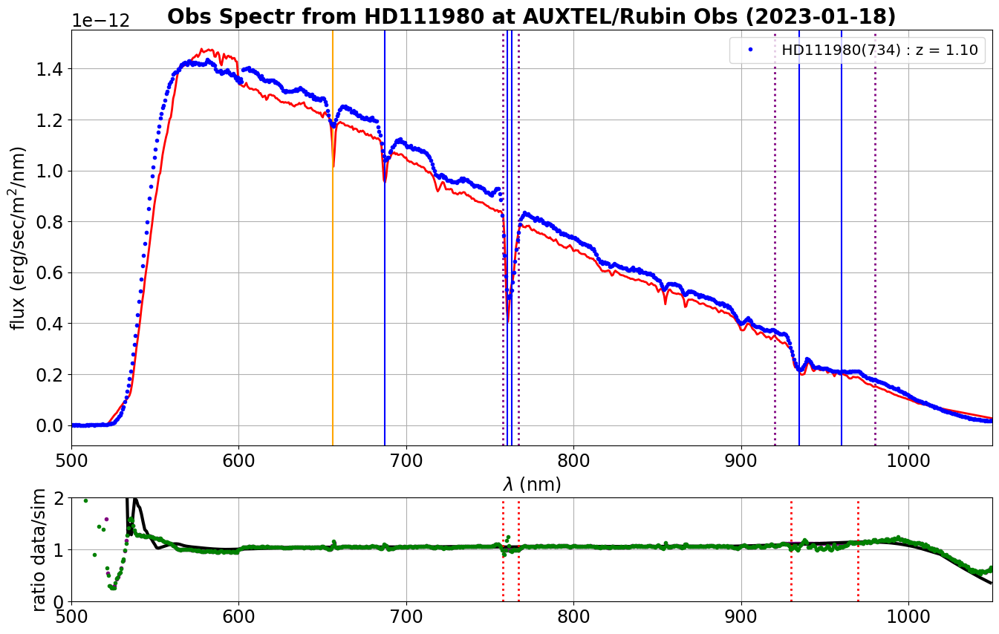

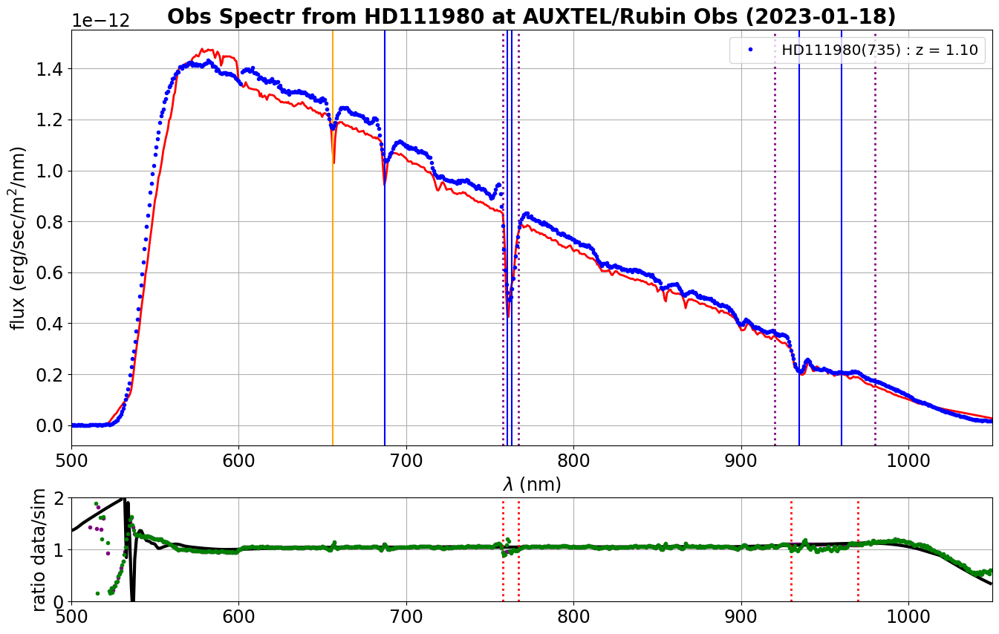

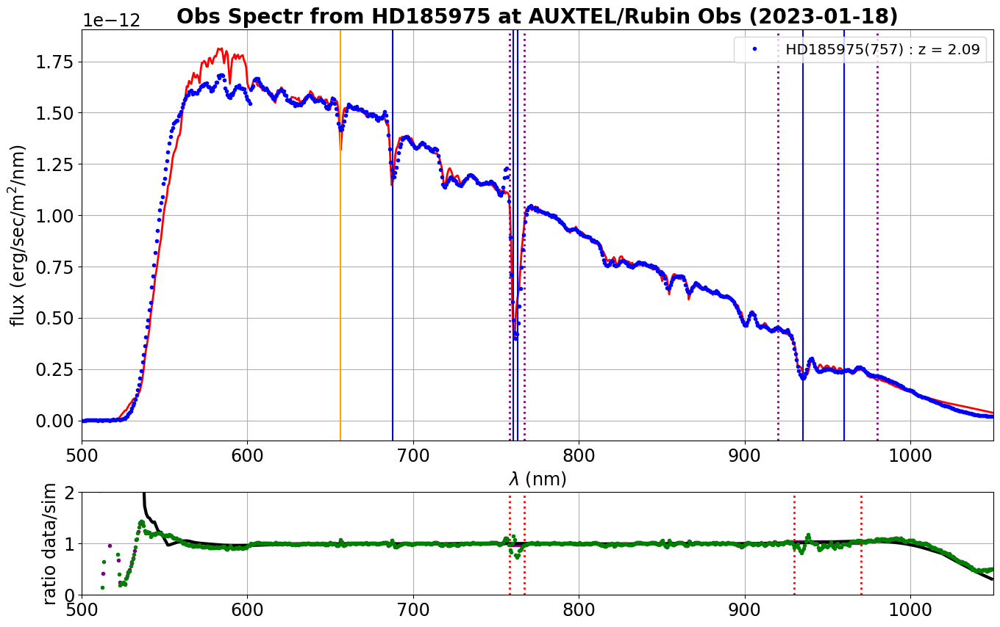

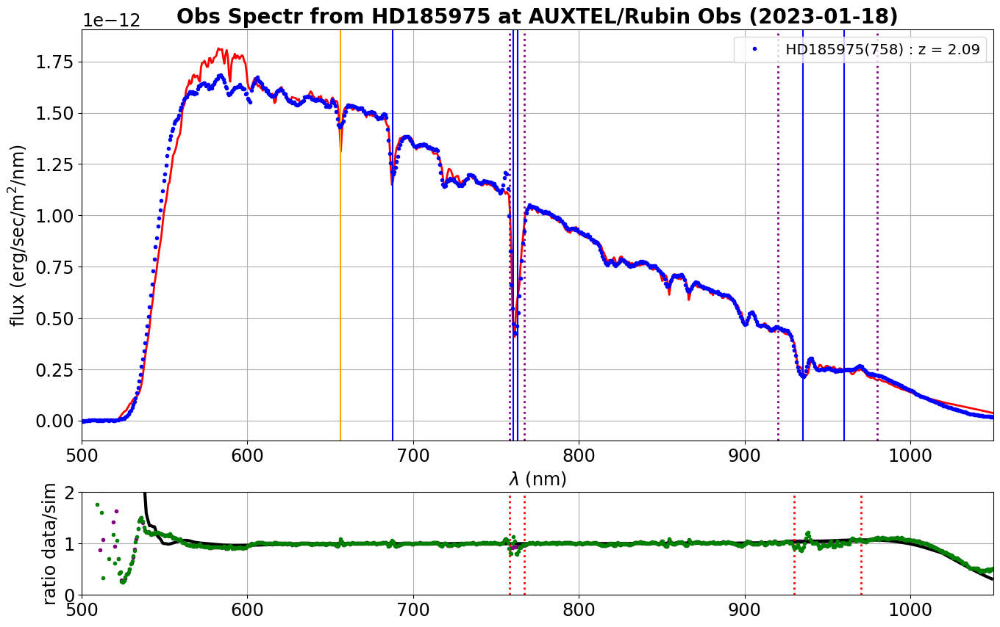

In [99]:
dict_ratio = {}
array_ratio = np.zeros((NBSPECTRA,len(WL)))

for idx in range(NBSPECTRA):
    
    fig=plt.figure(figsize=(16,10))
    gs = gridspec.GridSpec(2, 1,height_ratios=[4,1] ,figure=fig)


    # Fig 1
    ax=fig.add_subplot(gs[0,0])

    # extract spectrum from data
    the_df=all_spectra[idx]
    the_number = infos.iloc[idx]["number"]
    airmassvalue = infos.iloc[idx]["airmass"]
    target = infos.iloc[idx]["object"]
    label_airmass = f" {target}({the_number}) : z = {airmassvalue:.2f}"

    # the SED
    f_sed = dict_f_sed[target] 

    # atmosphere
    the_f_atm = dict_func_atm[the_number]

    # the throughput
    #f_thr

    # prediction
    the_wl = the_df["all_lambdas"].values
    the_sim = f_sed(the_wl) * the_f_atm(the_wl) * f_thr_new(the_wl)


    ax.errorbar(the_df["all_lambdas"],the_df['all_fluxes']/correction_area,yerr=the_df["all_fluxes_err"], fmt = '.',color="b",capsize = 0.01, ecolor=all_colors[ifile], elinewidth = .01,label=label_airmass)
    ax.plot(the_wl,the_sim,'r-',lw=2)

    ax.grid()
    ax.set_xlabel("$\lambda$ (nm)")
    ax.set_ylabel("flux (erg/sec/m$^2$/nm)")
    title=f"Obs Spectr from {target} at {SITE} ({DATE})"
    ax.set_title(title,fontsize=20,fontweight='bold')
    #ax.plot(sed_w,sed_f,'k-',label="SED")
    #ax.plot(WL,sed_predicted_f,color='darkviolet',lw=4,label = "predicted flux")
    ax.set_xlim( WLMINSEL  , WLMAXSEL  )

    ax.legend(loc="upper right")
    # draw abs lines
    plotlines(ax,ypos=FLUXLIMMAX/30)
    
    ax.axvline(x=758,linewidth=2,linestyle=":" ,color='purple')
    ax.axvline(x=767,linewidth=2,linestyle=':', color='purple')
    
    ax.axvline(x=920,linewidth=2,linestyle=":" ,color='purple')
    ax.axvline(x=980,linewidth=2,linestyle=':', color='purple')
    

    main_ax = ax

    # Fig 2
    ax=fig.add_subplot(gs[1,0], sharex=main_ax)

    ax.errorbar(the_wl,the_df['all_fluxes']/correction_area/the_sim,yerr=the_df["all_fluxes_err"], fmt = '.',color="g",capsize = 0.01, ecolor=all_colors[ifile], elinewidth = .01,label=label_airmass)
    ratio = the_df['all_fluxes']/correction_area/the_sim
    
    # remove absorption line
    xcut1=758
    xcut2=767
    xcut3=925
    xcut4=970
    
    index_to_remove=np.where(np.logical_or(np.logical_and(the_wl>xcut1,the_wl<xcut2),np.logical_and(the_wl>xcut3,the_wl<xcut4)))[0]
    
                             
    new_the_wl = the_wl[~np.isin(np.arange(the_wl.size), index_to_remove)]
    new_ratio = ratio[~np.isin(np.arange(ratio.size), index_to_remove)]
    
    f_ratio = interpolate.interp1d(new_the_wl,new_ratio,bounds_error=False,fill_value="extrapolate")
    ratio_interp =f_ratio(WL)
    
                                
    ax.plot(WL,ratio_interp,'.',color="purple")

    span=30
    ratio_filtered = smooth_data_np_convolve(ratio_interp,span)
    ax.plot(WL,ratio_filtered,'k-',lw=3)
    
    
    dict_ratio[the_number] = ratio_filtered
    array_ratio[idx,:] = ratio_filtered
    
    ax.axvline(x=758,linewidth=2,linestyle=":" ,color='r')
    ax.axvline(x=767,linewidth=2,linestyle=':', color='r')
    
    ax.axvline(x=930,linewidth=2,linestyle=":" ,color='r')
    ax.axvline(x=970,linewidth=2,linestyle=':', color='r')

    ax.grid()
    ax.set_ylim(0,2)
    ax.set_ylabel("ratio data/sim")
    
    plt.show()



# Do the fit

https://hernandis.me/2020/04/05/three-examples-of-nonlinear-least-squares-fitting-in-python-with-scipy.html

In [100]:
idx = 2
the_df=all_spectra[idx]
data = the_df['all_fluxes']/correction_area
dataerr = the_df["all_fluxes_err"]/correction_area
data_the_wl = the_df["all_lambdas"].values

index_sel= np.where(np.logical_and(data_the_wl>WLMINSEL,data_the_wl<WLMAXSEL))[0]

data = data[index_sel].values
dataerr = dataerr[index_sel].values 
data_the_wl = data_the_wl[index_sel]
                    
data_airmassvalue = infos.iloc[idx]["airmass"]
data_target = infos.iloc[idx]["object"]
f_sed = dict_f_sed[data_target] 
data_the_sedxthroughput = f_sed(data_the_wl) * f_thr_new(data_the_wl)

In [101]:
# scipy.optimize.least_squares
#(fun, 
# x0, 
# jac='2-point', 
# bounds=(-inf, inf), 
# method='trf', 
# ftol=1e-08, 
# xtol=1e-08, 
# gtol=1e-08, 
# x_scale=1.0, 
# loss='linear', 
# f_scale=1.0, 
# diff_step=None, 
# tr_solver=None, 
# tr_options={}, 
# jac_sparsity=None, 
# max_nfev=None, 
# verbose=0, 
# args=(), 
# kwargs={})
#Function which computes the vector of residuals, with the signature fun(x, *args, **kwargs), 

In [102]:
def pred(params,*x):
    
    global emul
    
    alpha,pwv,oz = params    
    
    # have to build the wavelength array as follow (I don't know why)
    wl = []
    for el in x[0]:
        wl.append(el)

    fl = alpha*emul.GetAllTransparencies(wl ,data_airmassvalue,pwv,oz,ncomp=0,flagAerosols=False)
    fl *= data_the_sedxthroughput
    return fl
       

def func_residuals(params):
    alpha,oz,pwv = params
    residuals = (data - pred(params,data_the_wl))/dataerr
    return residuals

In [103]:
pwv0 = 3.0
oz0 = 300.
params0 = [1,pwv0,oz0]

In [104]:
print(repr(data_the_wl[:5]))

array([500.107685  , 500.81348423, 501.5192639 , 502.225024  ,
       502.93076451])


In [105]:
res = least_squares(func_residuals, params0,bounds=([0.1,0.001,50.],[2,9.5,550.]))

In [106]:
res

     message: `ftol` termination condition is satisfied.
     success: True
      status: 2
         fun: [-2.420e+00  6.224e-01 ... -2.008e+01 -1.959e+01]
           x: [ 9.919e-01  3.740e+00  3.408e+02]
        cost: 49724.72837157743
         jac: [[-1.417e-02  1.434e-07  9.595e-07]
               [-1.381e-02  6.355e-07  9.716e-07]
               ...
               [-4.404e+01  3.500e-05 -1.399e-09]
               [-4.285e+01  3.423e-05  0.000e+00]]
        grad: [ 5.971e-04  6.360e-04  4.986e-06]
  optimality: 0.0023783266426219613
 active_mask: [0 0 0]
        nfev: 5
        njev: 5

In [107]:
def pred2(params,*arg):
    """
    Model prediction y = f(x) where x is the array of wavelength and y the measured flux
    
    inputs:
      - params : the unknown atmospheric parameters to fit (pwv,oz)
      - *args  : additionnal data provided to compute the model : 
                   1) the wavelength array, 
                   2) sedxthroughput,
                   3) the airmass
      
    output:
      - the array of predicted flux values at each wavelength data point
      
    It computes the production of the atmospheric transparency by the SED - throughout product  
    It makes use of the atmospheric model transparency emulated in the external global object emul 
    which depend on atmospheric parameters to fit
    
    """
    
    global emul
    
    alpha,pwv,oz = params    
    
    # have to build the wavelength array as follow (I don't know why)
    wl = []
    for el in arg[0]:
        wl.append(el)

    the_sedxthroughput = arg[1]
    
    airmass = arg[2]
        

    fl = alpha*emul.GetAllTransparencies(wl ,airmass,pwv,oz,ncomp=0,flagAerosols=False)
    fl *= the_sedxthroughput
    return fl
       

def func_residuals2(params,*arg):
    """
    This function is called by the scipy.optimize.least_squares function to compute the normalized residuals
    at each data point at each wavelength (yi-f(xi,thetaj)/sigmai
    
    input:
      - params : the unknown atmospheric parameters to fit (pwv,oz)
      - *args  : additionnal data provided to compute the mode : 
                 to the model
                   1) the wavelength array, 
                   2) sedxthroughput,
                   3) the airmass
                used to compute the residuals
                   4) data : the measured fluxes
                   5) dataerr : the error on fluxes
    
    return:
      - the array of residuals for the given set of parameters required by the least_squares function 
    """
    
    the_wl = arg[0]         # wavelength array required by the model function pred2
    the_sedthr = arg[1]     # the product of the SED by the throughput required by the model function pred2
    the_airmass = arg[2]    # the airmass required by the model function pred2 
    the_data = arg[3]       # the observed fluxes array
    the_dataerr = arg[4]    # the error on the observed fluxes array
    
     
    alpha,oz,pwv = params   # decode the parameters
    residuals = (the_data - pred2(params,the_wl,the_sedthr,the_airmass))/the_dataerr
    
    return residuals

In [108]:
res2 = least_squares(func_residuals2, params0,bounds=([0.1,0.001,50.],[2,9.5,550.]),args=[data_the_wl,data_the_sedxthroughput,data_airmassvalue,data,dataerr])

In [109]:
res2

     message: `ftol` termination condition is satisfied.
     success: True
      status: 2
         fun: [-2.420e+00  6.224e-01 ... -2.008e+01 -1.959e+01]
           x: [ 9.919e-01  3.740e+00  3.408e+02]
        cost: 49724.72837157743
         jac: [[-1.417e-02  1.434e-07  9.595e-07]
               [-1.381e-02  6.355e-07  9.716e-07]
               ...
               [-4.404e+01  3.500e-05 -1.399e-09]
               [-4.285e+01  3.423e-05  0.000e+00]]
        grad: [ 5.971e-04  6.360e-04  4.986e-06]
  optimality: 0.0023783266426219613
 active_mask: [0 0 0]
        nfev: 5
        njev: 5

======================================= 0 : HD38666(211) : z = 1.08 =================================
>>>> parameters for  HD38666(211) : z = 1.08 [  1.02126852   4.35683723 493.39953901]


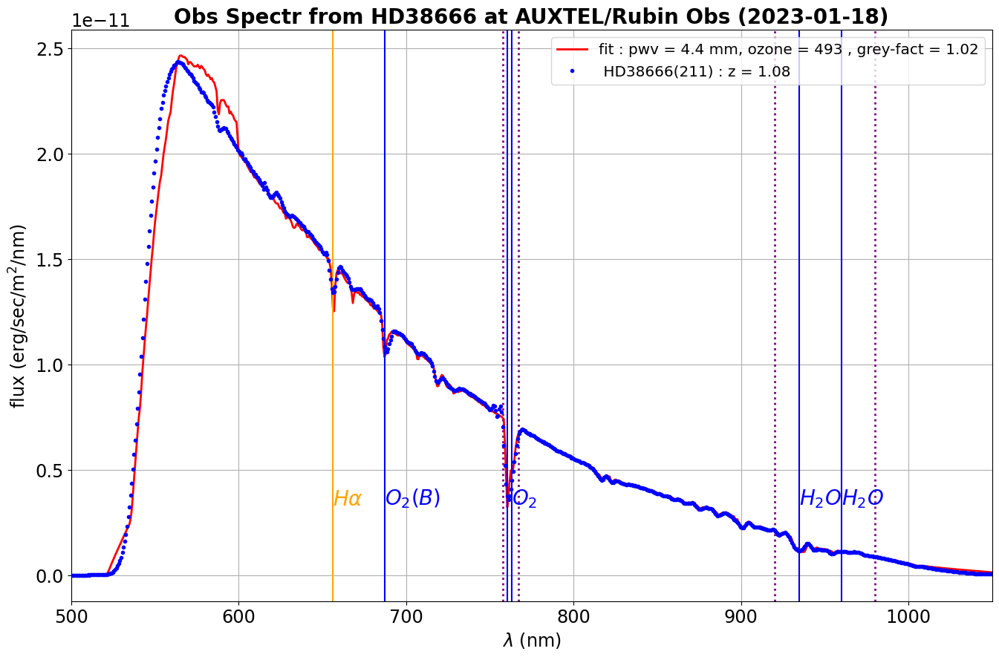

======================================= 1 : HD38666(220) : z = 1.07 =================================
>>>> parameters for  HD38666(220) : z = 1.07 [  1.03412531   4.1863995  529.58159733]


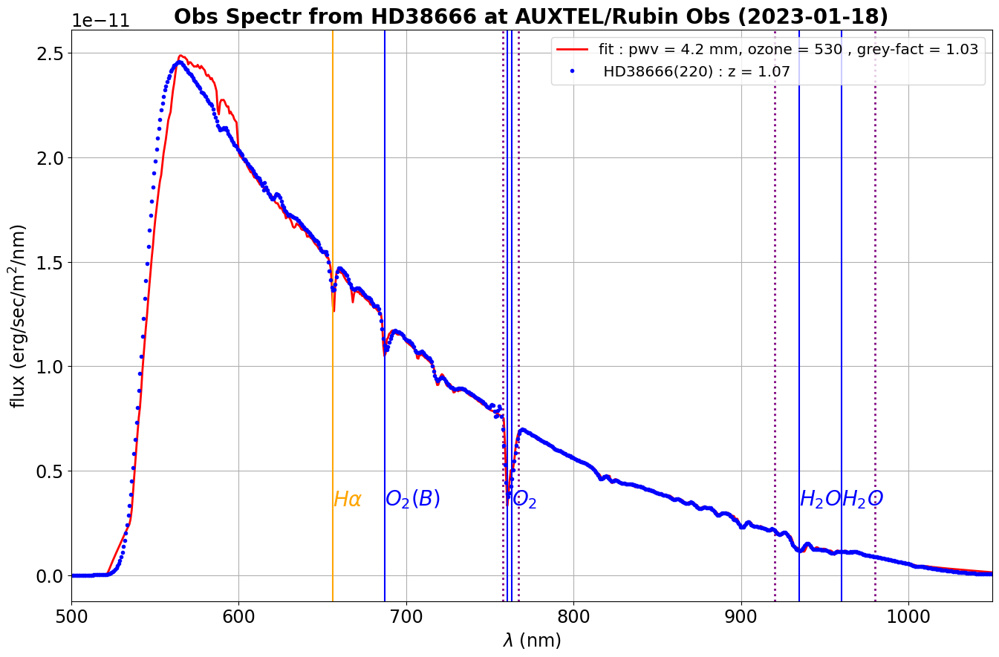

======================================= 2 : HD185975(252) : z = 2.06 =================================
>>>> parameters for  HD185975(252) : z = 2.06 [  0.99187904   3.7402286  340.83711299]


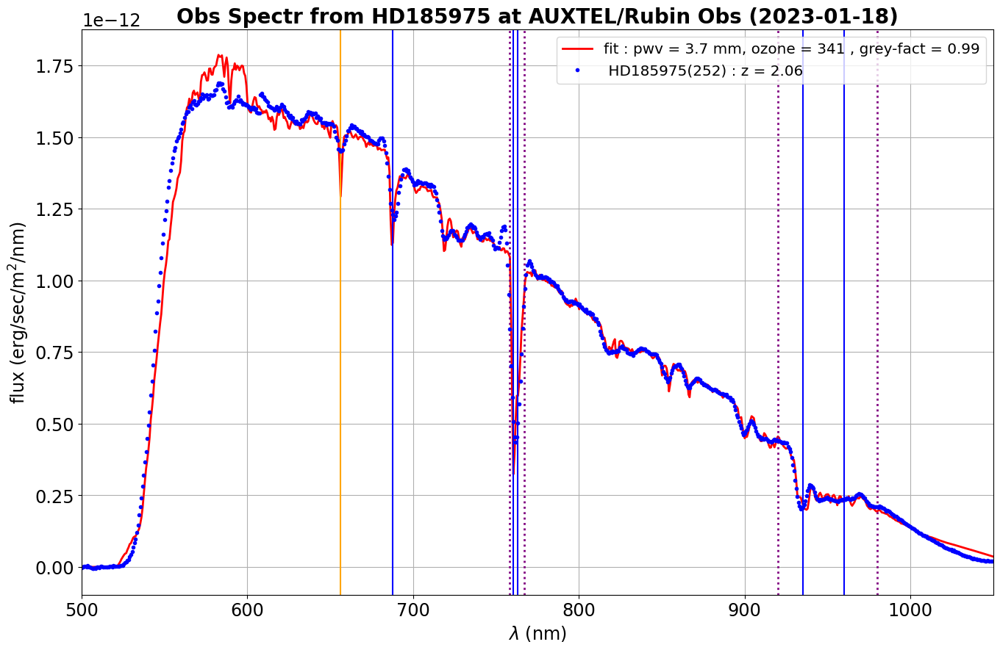

======================================= 3 : HD185975(253) : z = 2.06 =================================
>>>> parameters for  HD185975(253) : z = 2.06 [  1.00207134   3.57878988 363.27674454]


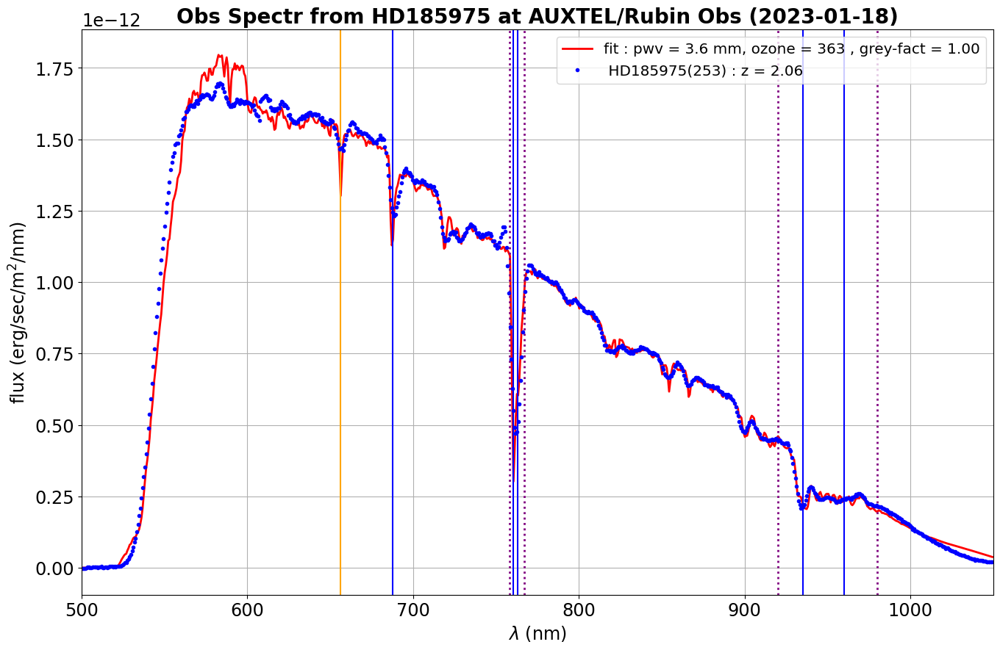

======================================= 4 : HD38666(267) : z = 1.02 =================================
>>>> parameters for  HD38666(267) : z = 1.02 [  1.03727674   4.05551897 550.        ]


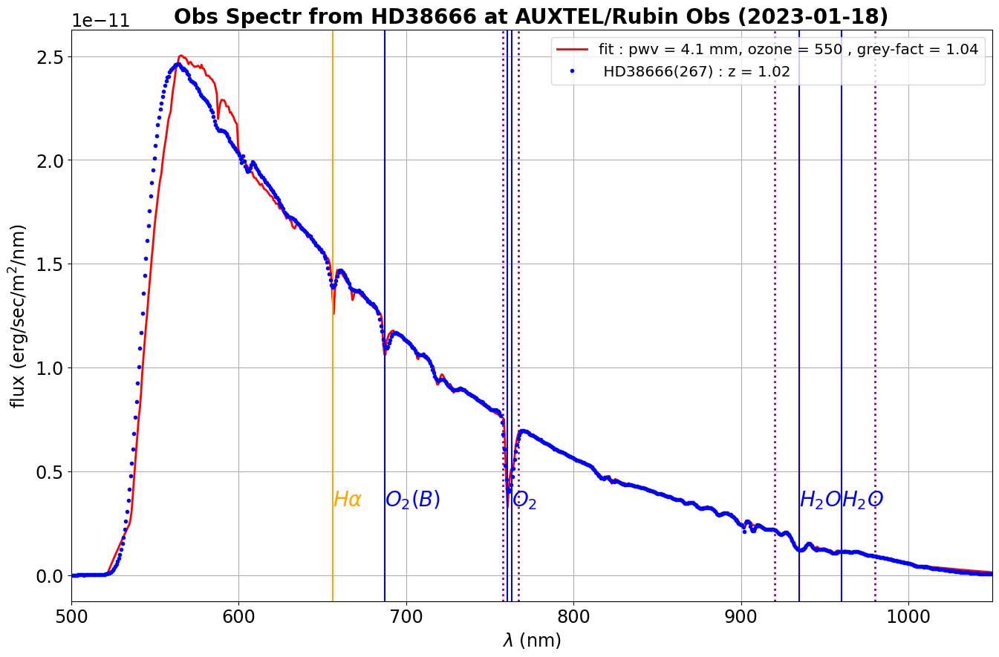

======================================= 5 : HD38666(268) : z = 1.02 =================================
>>>> parameters for  HD38666(268) : z = 1.02 [  1.02048295   4.24132757 475.1501222 ]


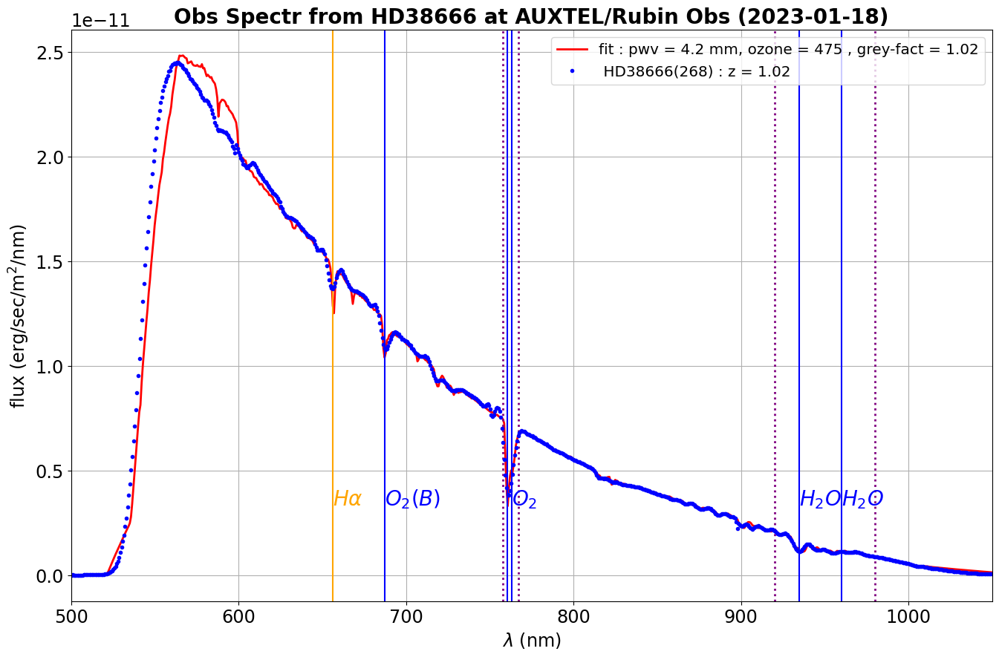

======================================= 6 : HD185975(292) : z = 2.08 =================================
>>>> parameters for  HD185975(292) : z = 2.08 [  1.00606701   3.55261422 367.1584652 ]


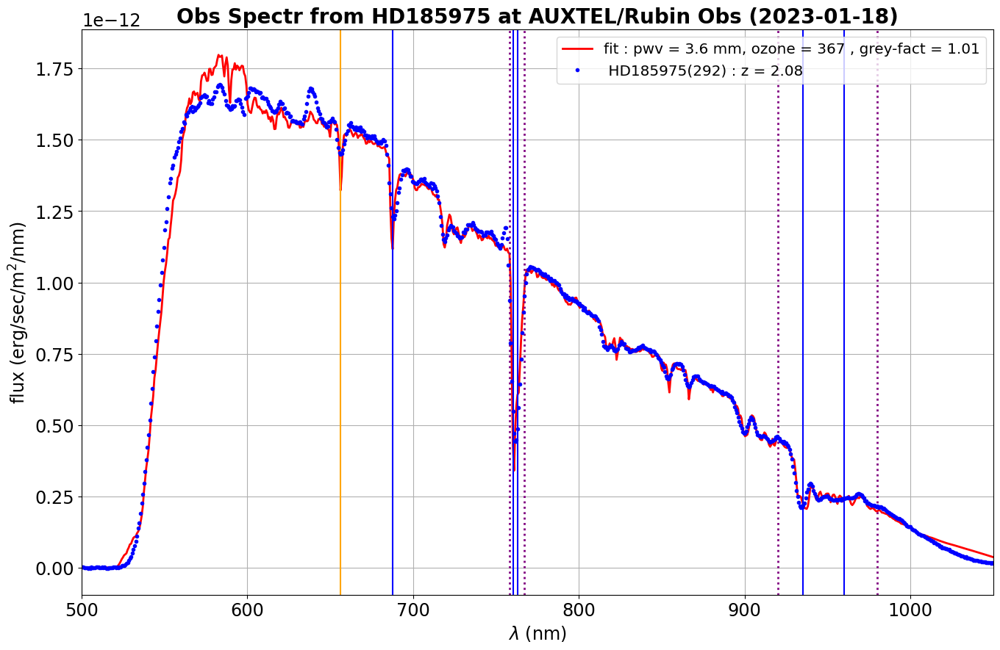

======================================= 7 : HD185975(316) : z = 2.09 =================================
>>>> parameters for  HD185975(316) : z = 2.09 [  0.99312712   4.0672992  372.54946116]


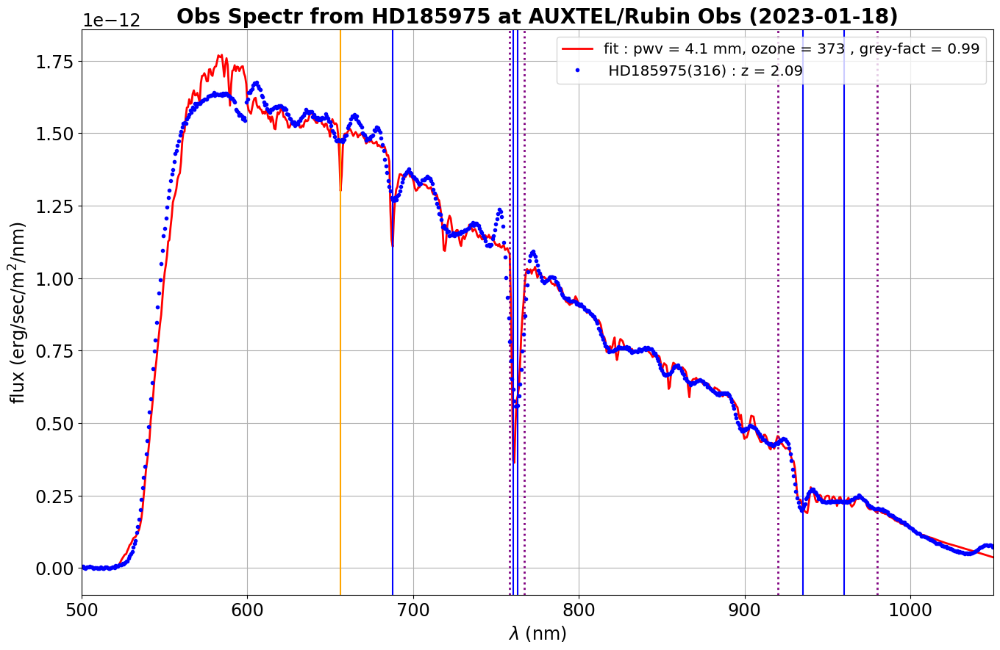

======================================= 8 : HD185975(317) : z = 2.09 =================================
>>>> parameters for  HD185975(317) : z = 2.09 [  0.99163918   4.02185419 339.37905435]


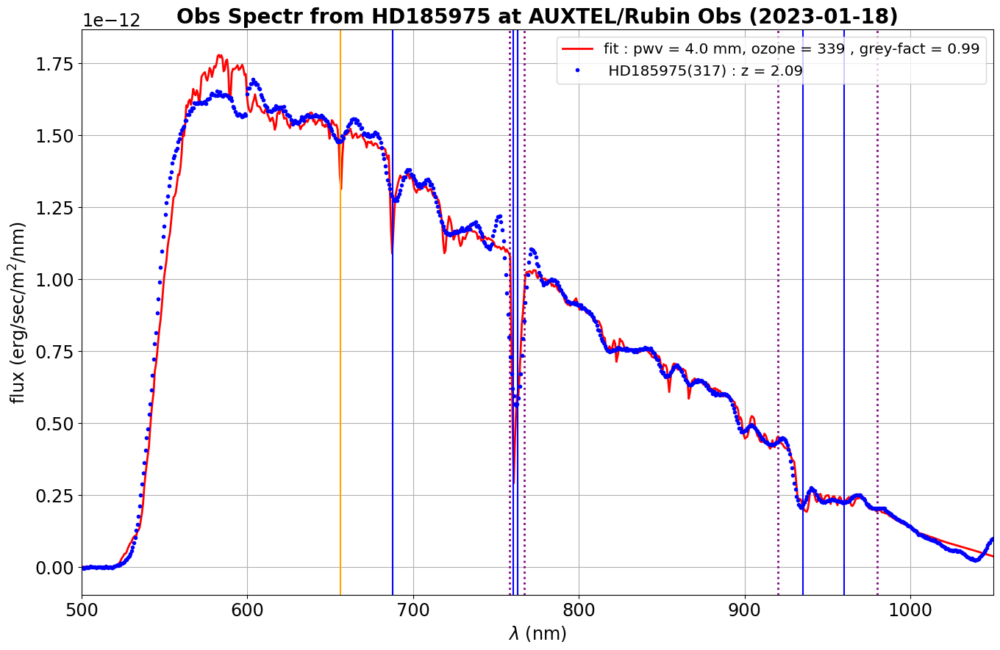

======================================= 9 : HD074000(325) : z = 1.36 =================================
>>>> parameters for  HD074000(325) : z = 1.36 [  1.03906764   3.76444824 550.        ]


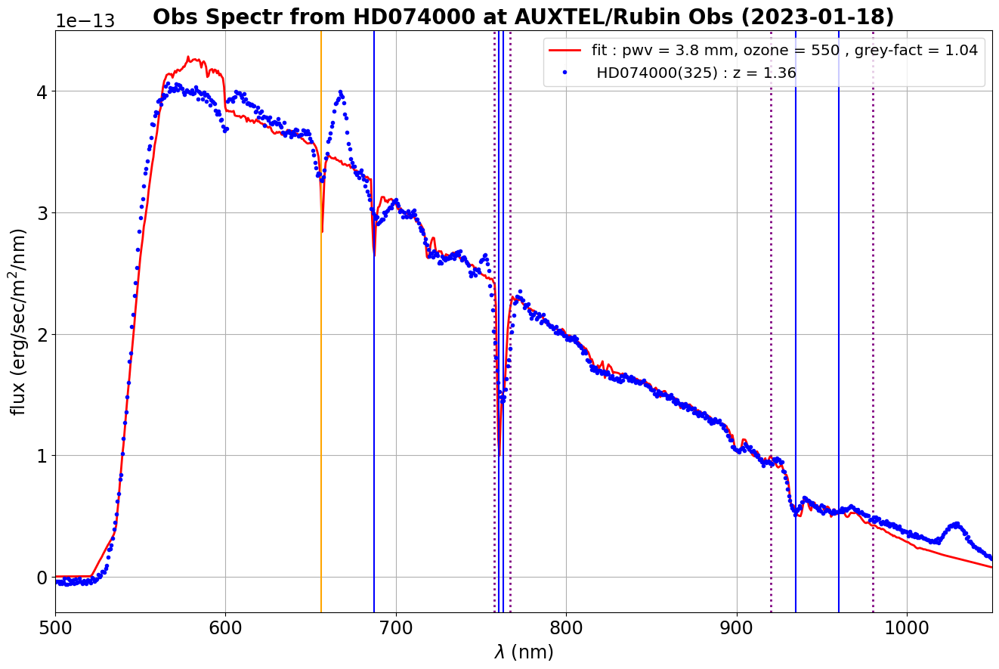

======================================= 10 : HD60753(341) : z = 1.12 =================================
>>>> parameters for  HD60753(341) : z = 1.12 [  1.03587745   4.29648646 448.61717475]


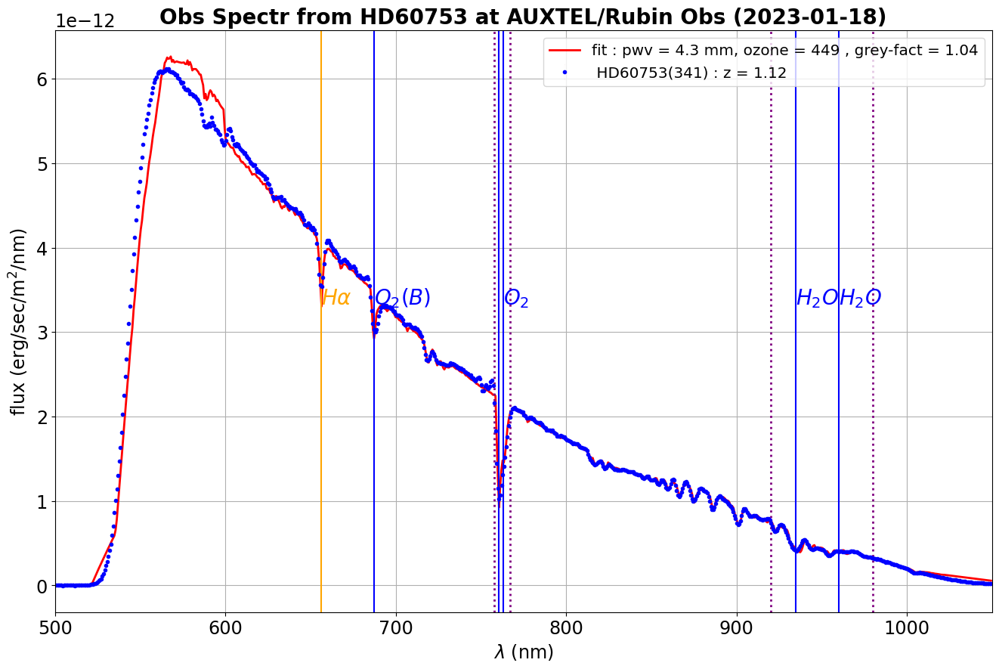

======================================= 11 : HD60753(342) : z = 1.12 =================================
>>>> parameters for  HD60753(342) : z = 1.12 [  1.02595216   4.39337962 387.46694893]


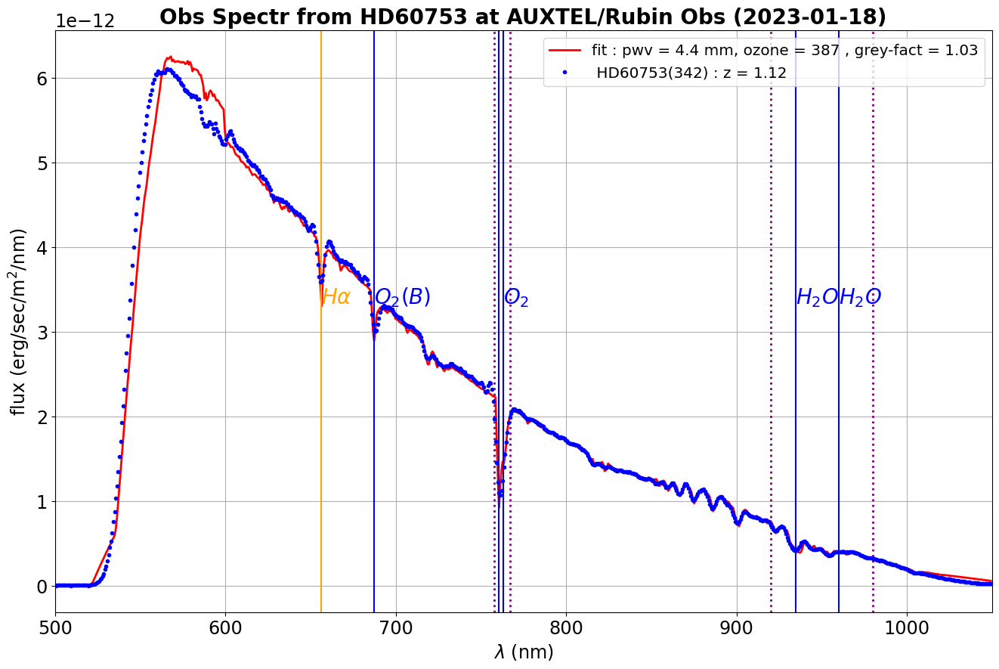

======================================= 12 : HD074000(350) : z = 1.28 =================================
>>>> parameters for  HD074000(350) : z = 1.28 [  1.01495667   3.94481637 504.93916266]


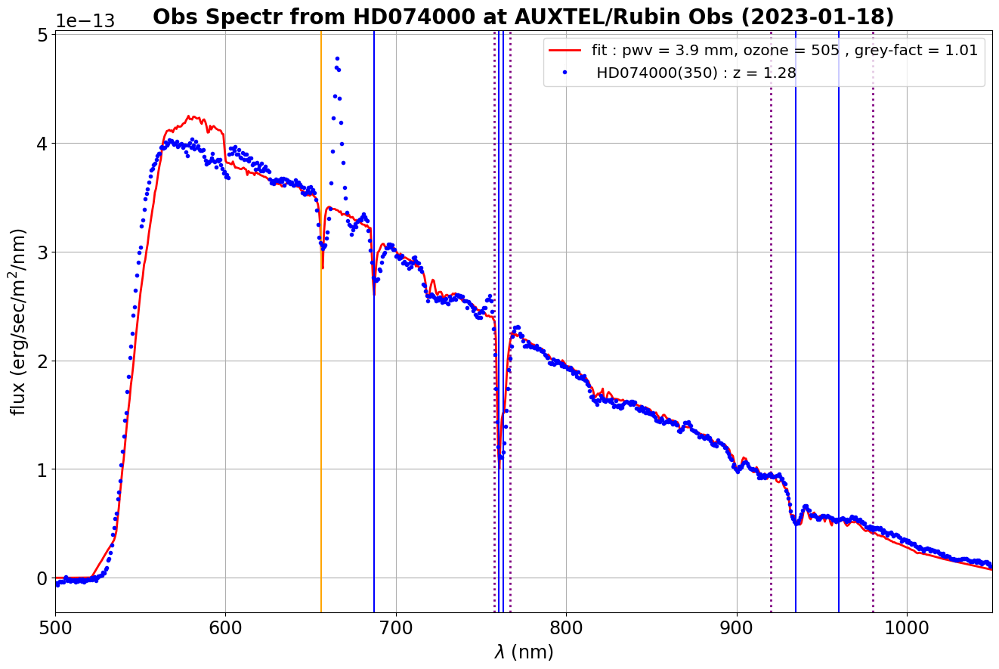

======================================= 13 : HD60753(359) : z = 1.11 =================================
>>>> parameters for  HD60753(359) : z = 1.11 [  1.03160908   4.3040949  416.15957411]


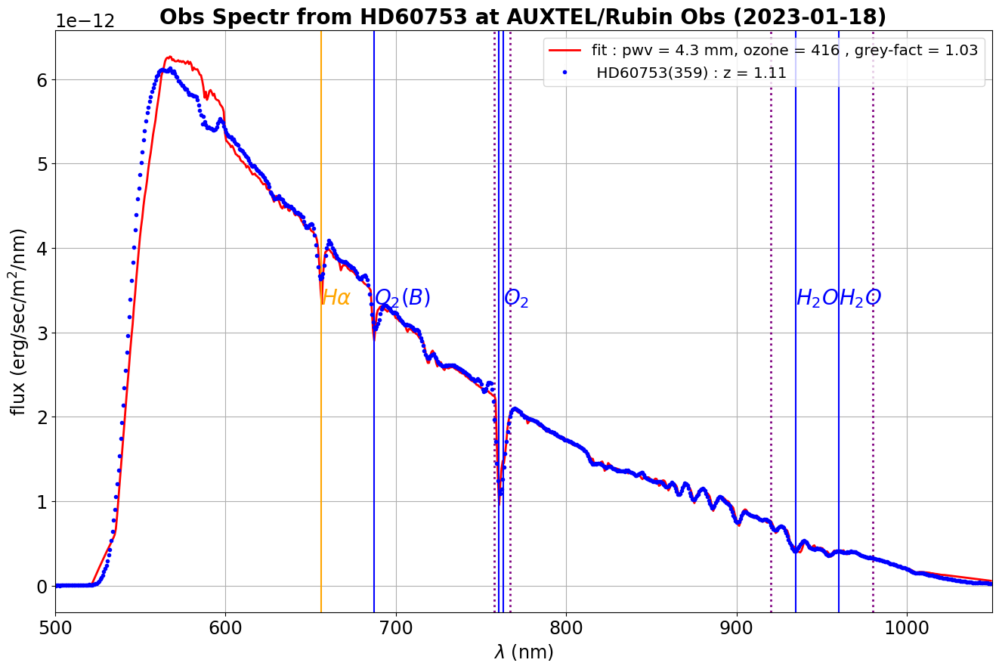

======================================= 14 : HD60753(360) : z = 1.11 =================================
>>>> parameters for  HD60753(360) : z = 1.11 [  1.02187192   4.26113965 382.9779922 ]


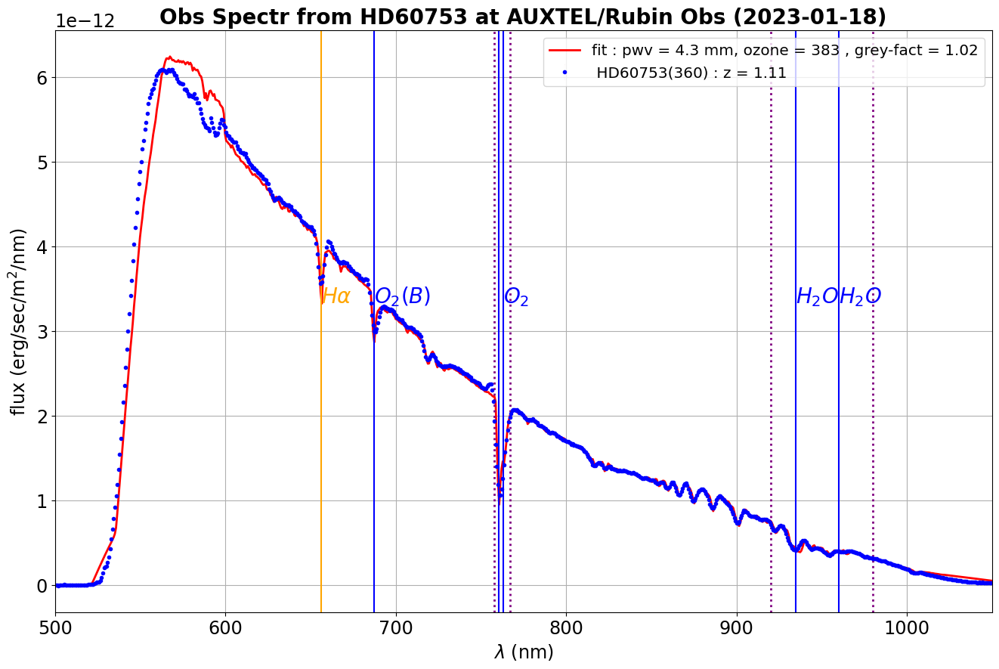

======================================= 15 : HD185975(378) : z = 2.12 =================================
>>>> parameters for  HD185975(378) : z = 2.12 [  0.97477316   3.85259225 287.60087096]


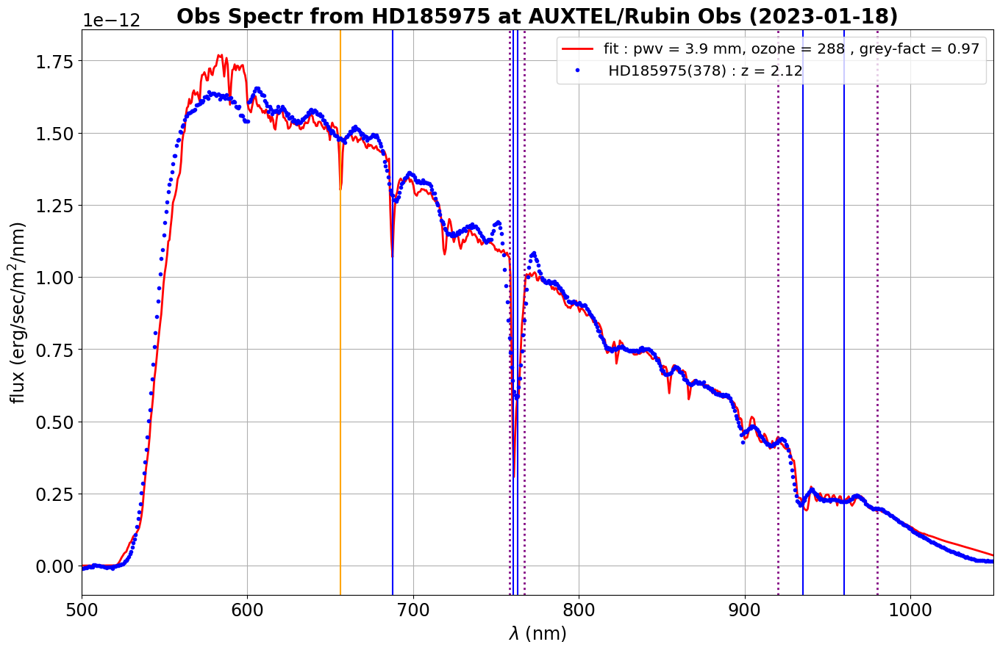

======================================= 16 : HD185975(411) : z = 2.13 =================================
>>>> parameters for  HD185975(411) : z = 2.13 [  0.99635222   2.9129265  318.3761959 ]


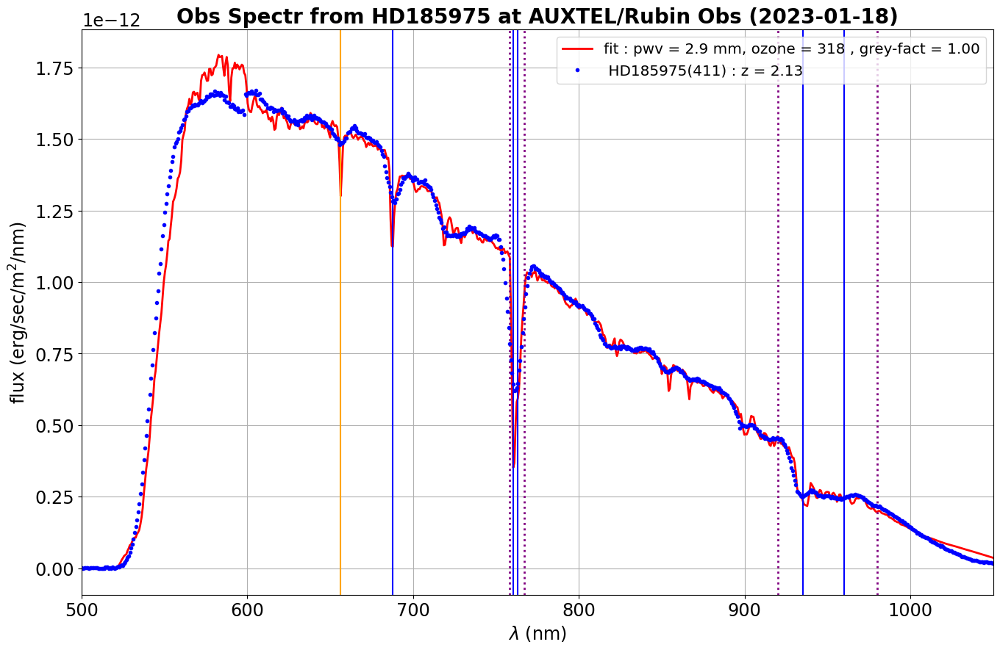

======================================= 17 : HD185975(412) : z = 2.13 =================================
>>>> parameters for  HD185975(412) : z = 2.13 [ 0.94439061  2.83077195 50.        ]


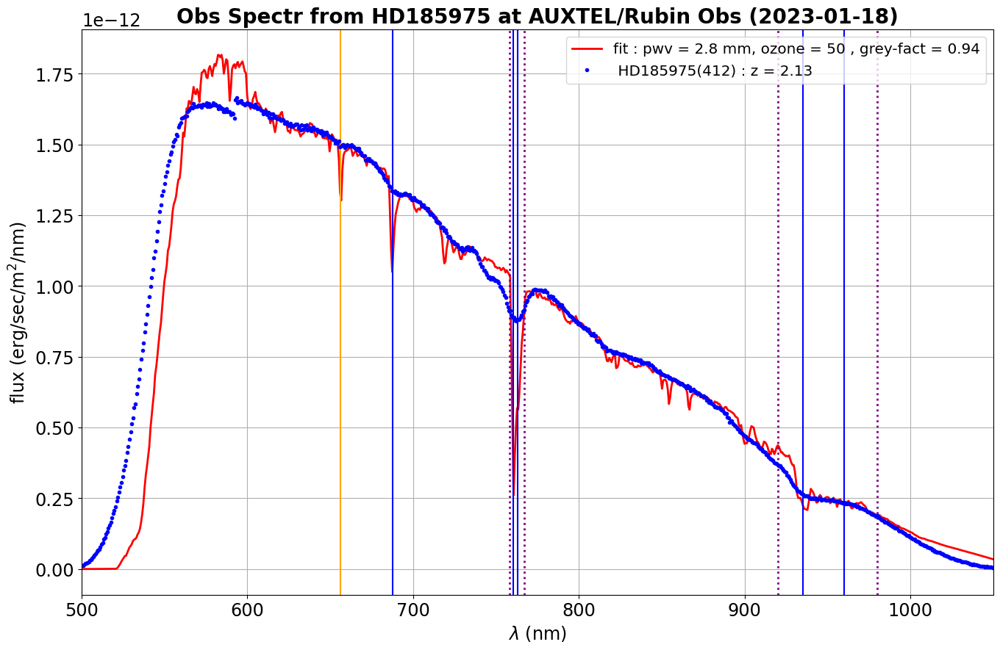

======================================= 18 : HD38666(423) : z = 1.05 =================================
>>>> parameters for  HD38666(423) : z = 1.05 [  1.03797339   3.71534837 521.81592748]


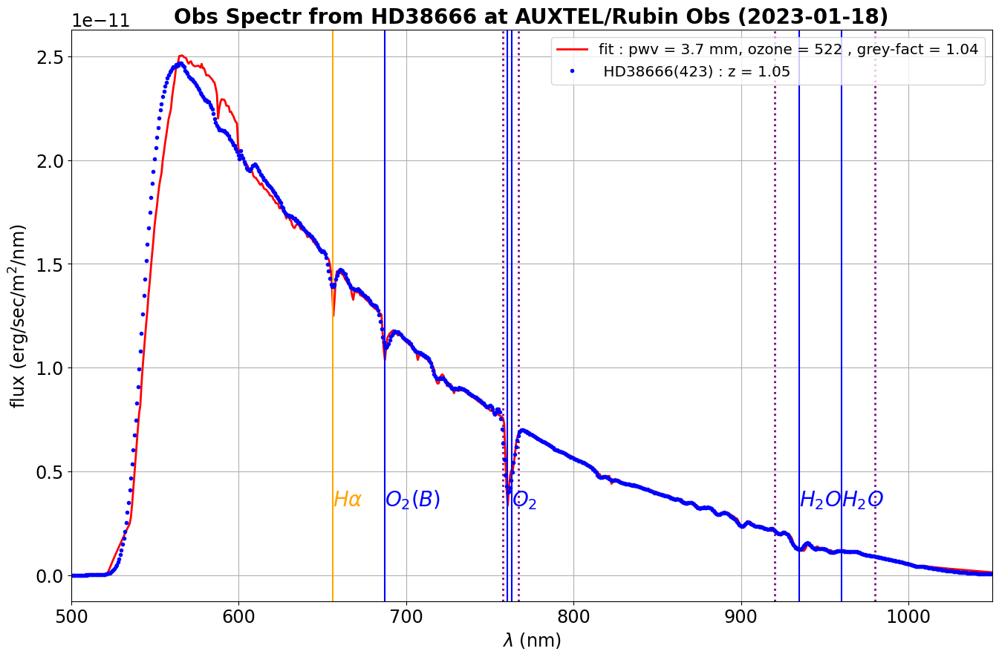

======================================= 19 : HD38666(424) : z = 1.05 =================================
>>>> parameters for  HD38666(424) : z = 1.05 [  1.0257736    3.70670955 513.99675273]


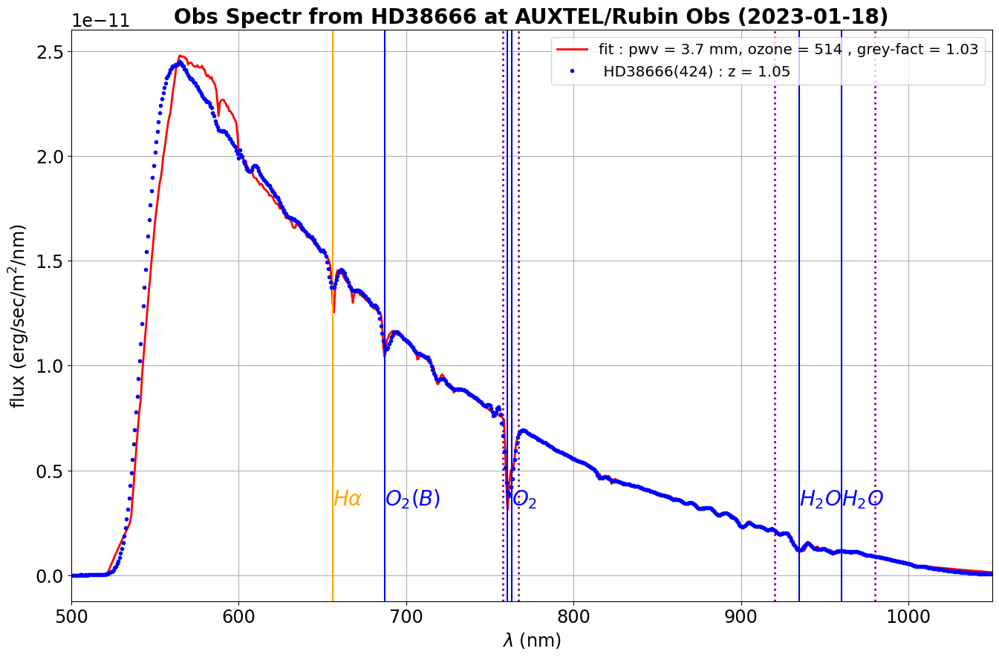

======================================= 20 : HD185975(435) : z = 2.13 =================================
>>>> parameters for  HD185975(435) : z = 2.13 [  0.98742468   2.89613876 330.16149435]


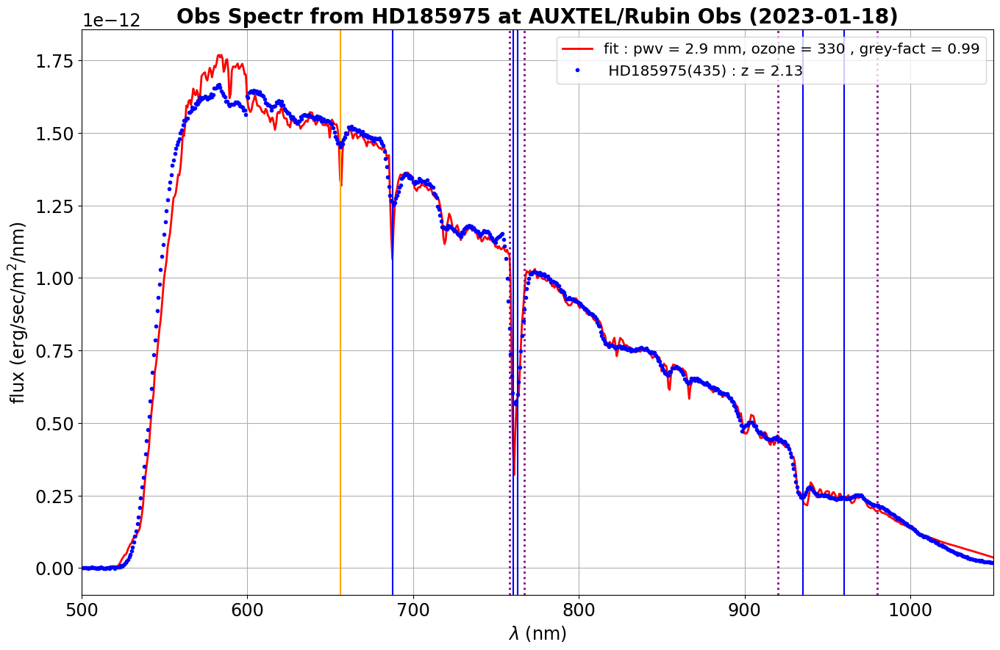

======================================= 21 : HD185975(436) : z = 2.13 =================================
>>>> parameters for  HD185975(436) : z = 2.13 [  0.98269097   3.18840693 294.92289978]


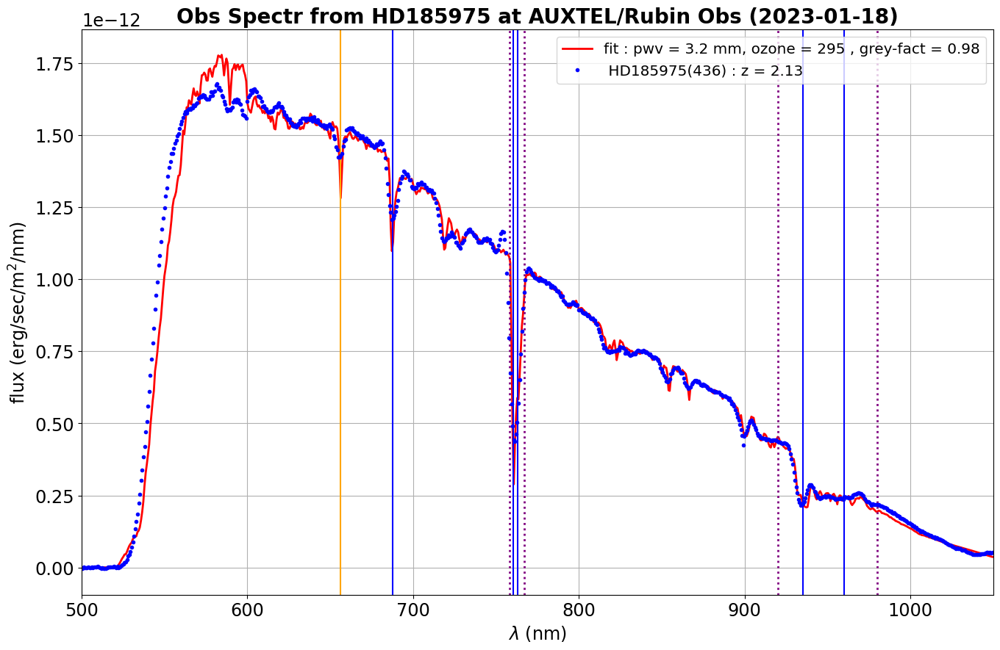

======================================= 22 : HD38666(449) : z = 1.08 =================================
>>>> parameters for  HD38666(449) : z = 1.08 [  1.02749355   3.67513629 497.18498848]


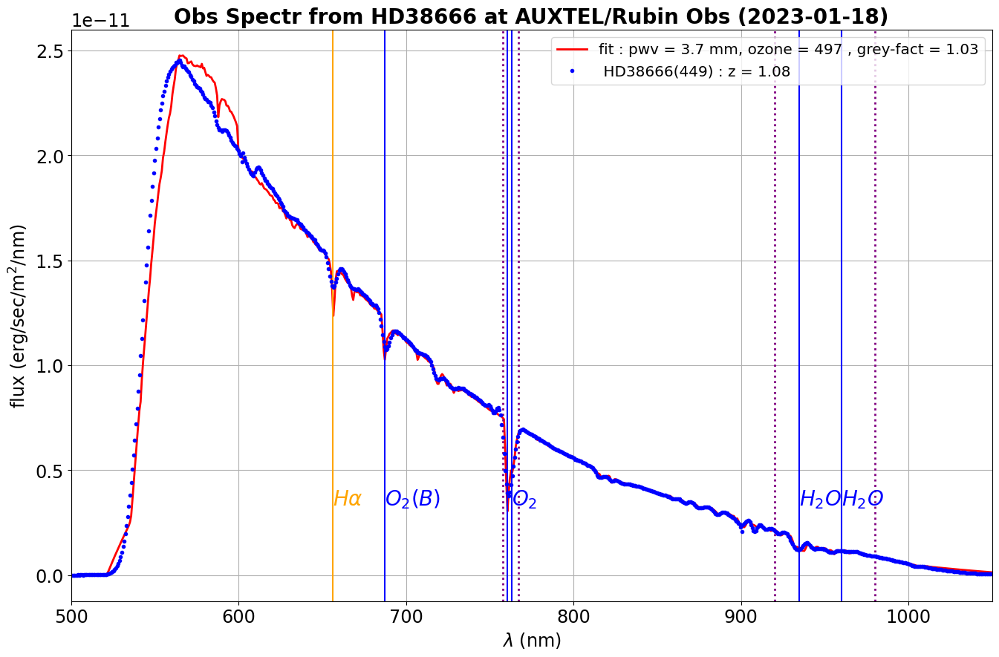

======================================= 23 : HD38666(468) : z = 1.10 =================================
>>>> parameters for  HD38666(468) : z = 1.10 [  1.02993734   3.4845185  487.02098072]


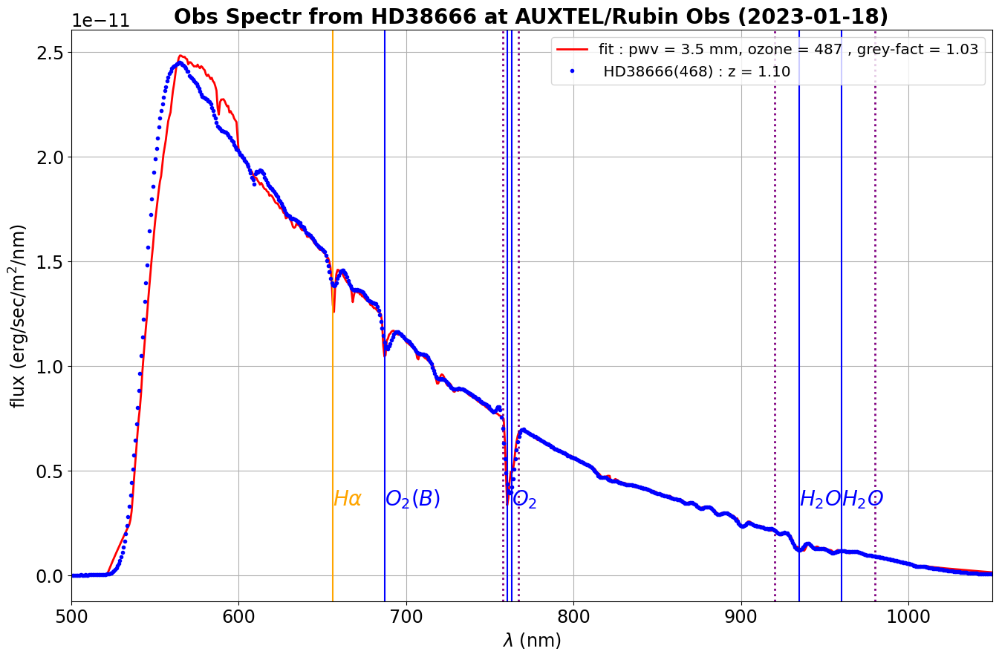

======================================= 24 : HD185975(543) : z = 2.14 =================================
>>>> parameters for  HD185975(543) : z = 2.14 [  0.97107674   3.14004282 392.82168051]


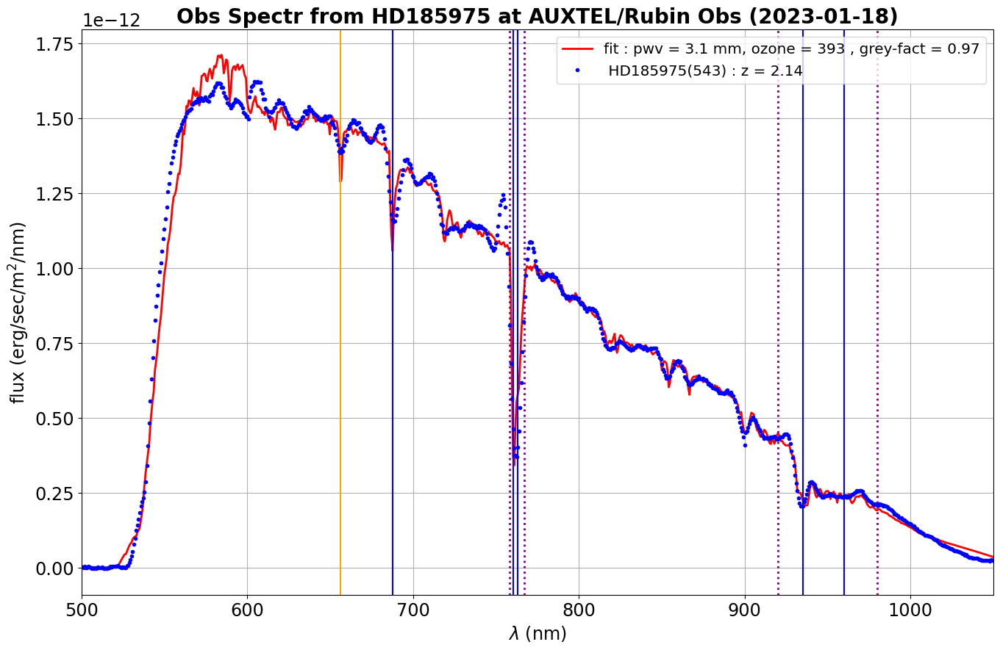

======================================= 25 : HD185975(544) : z = 2.14 =================================
>>>> parameters for  HD185975(544) : z = 2.14 [  1.00419947   2.84157533 378.67606069]


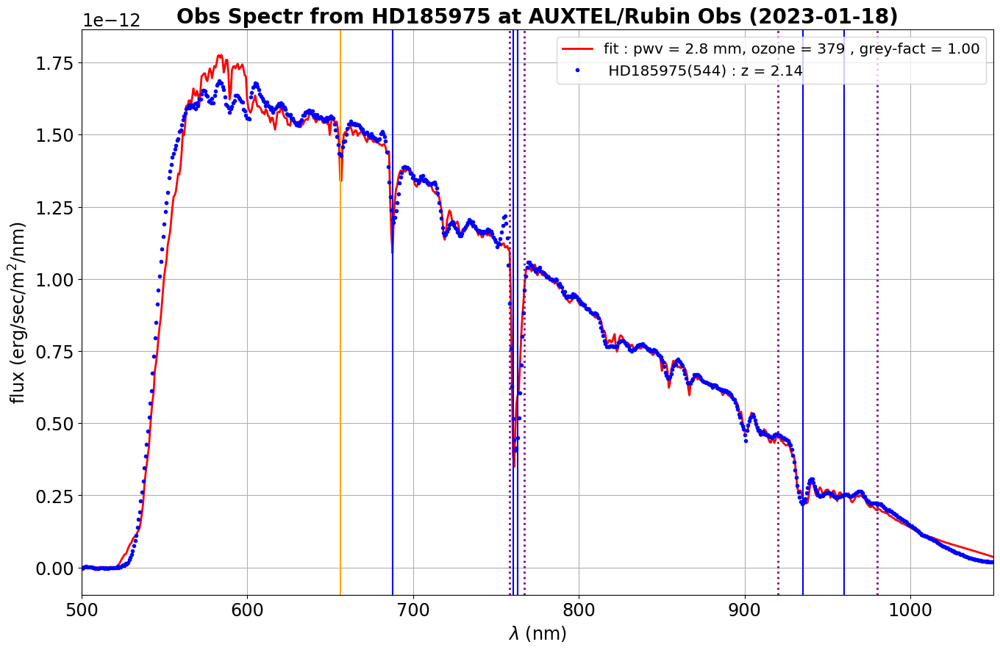

======================================= 26 : HD38666(558) : z = 1.44 =================================
>>>> parameters for  HD38666(558) : z = 1.44 [  1.01785192   3.68116303 443.68460635]


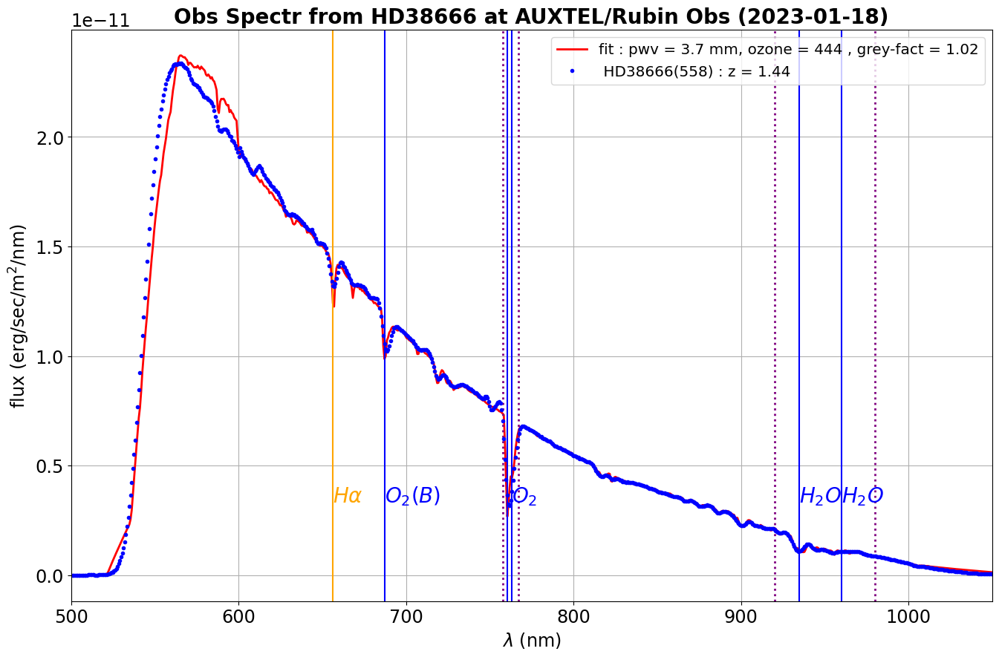

======================================= 27 : HD38666(559) : z = 1.44 =================================
>>>> parameters for  HD38666(559) : z = 1.44 [  1.0030927    3.61910891 428.27143181]


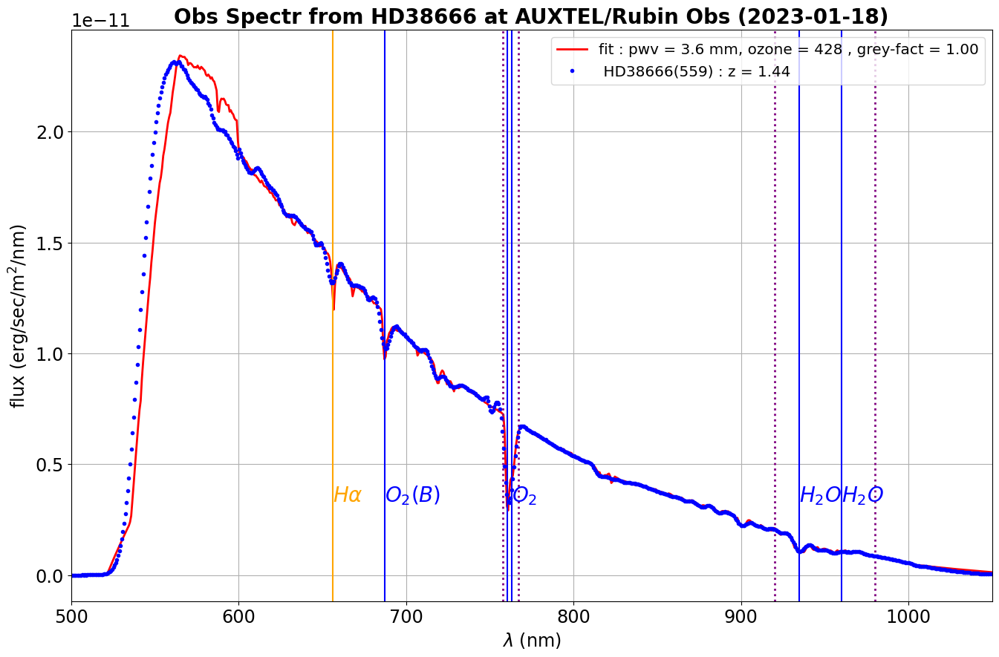

======================================= 28 : HD38666(568) : z = 1.47 =================================
>>>> parameters for  HD38666(568) : z = 1.47 [  1.01738481   3.65139343 440.4344818 ]


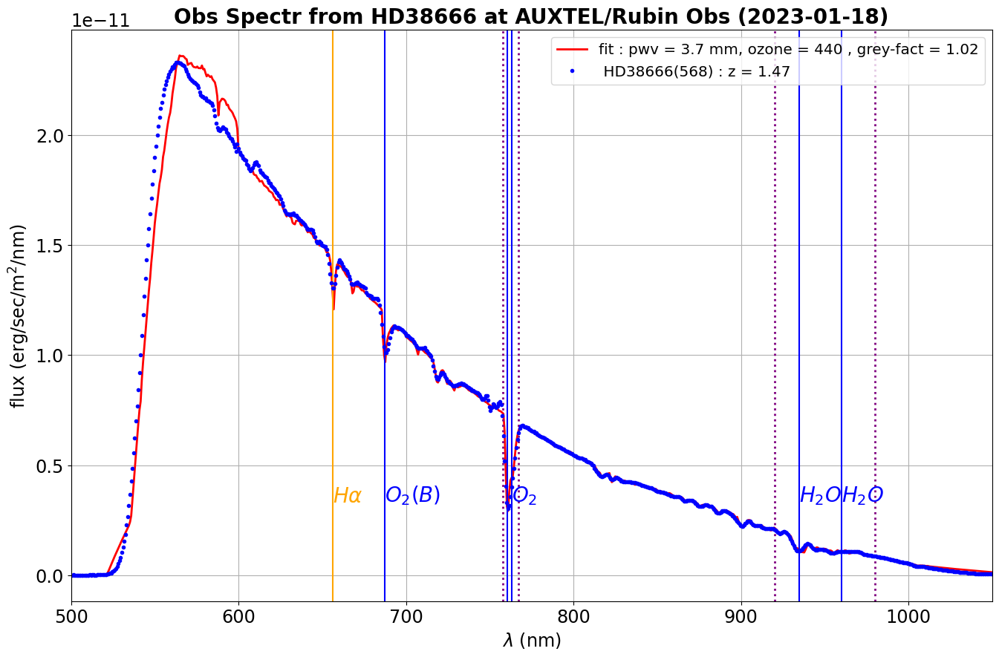

======================================= 29 : HD185975(594) : z = 2.14 =================================
>>>> parameters for  HD185975(594) : z = 2.14 [  0.9951074    3.03116519 339.26240759]


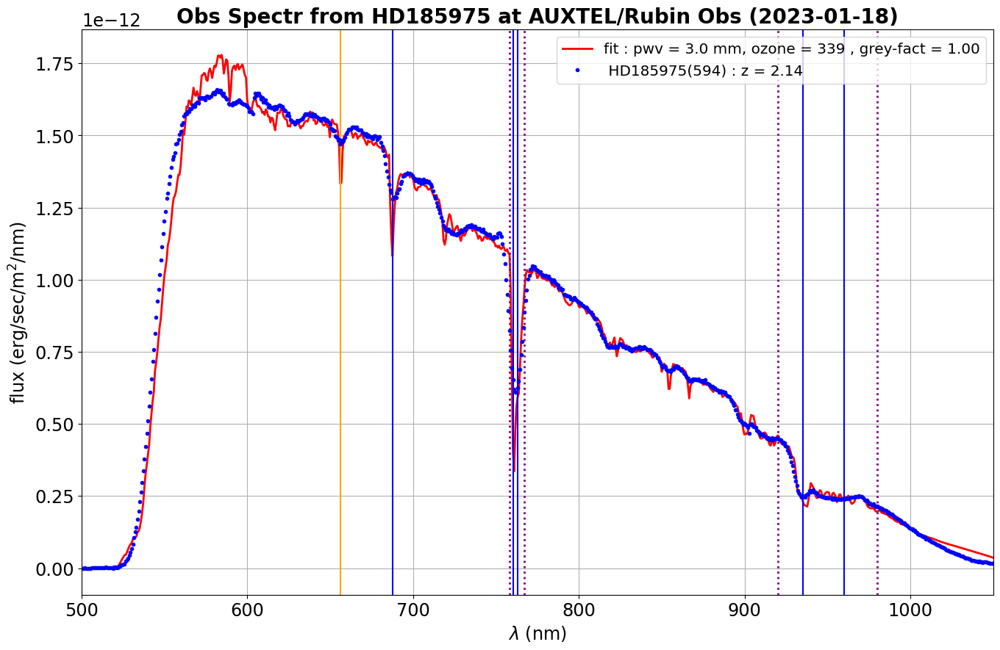

======================================= 30 : HD185975(595) : z = 2.14 =================================
>>>> parameters for  HD185975(595) : z = 2.14 [  0.98889324   2.8561145  349.554216  ]


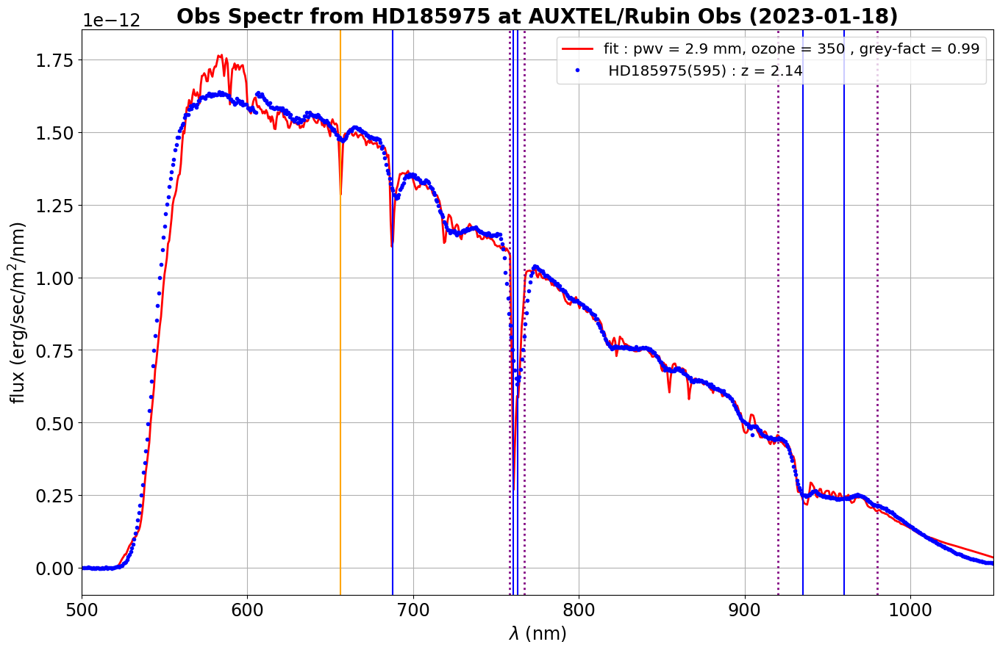

======================================= 31 : HD38666(603) : z = 1.62 =================================
>>>> parameters for  HD38666(603) : z = 1.62 [  1.01369734   3.86693441 398.19145705]


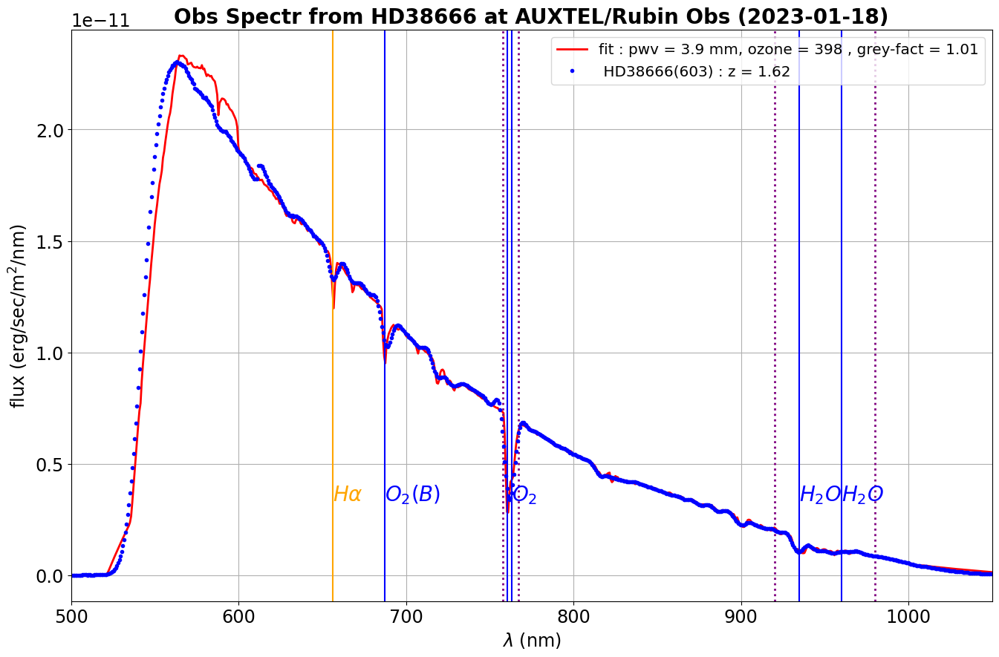

======================================= 32 : HD38666(604) : z = 1.63 =================================
>>>> parameters for  HD38666(604) : z = 1.63 [  1.01562482   3.78458137 448.444714  ]


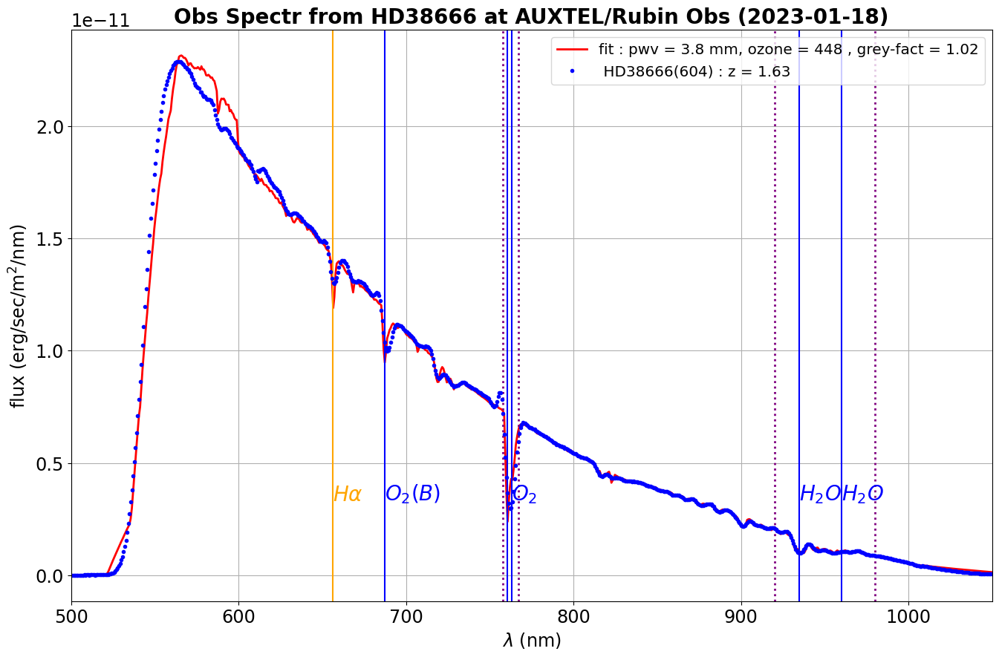

======================================= 33 : HD38666(612) : z = 1.66 =================================
>>>> parameters for  HD38666(612) : z = 1.66 [  1.00333607   3.88999533 421.23659685]


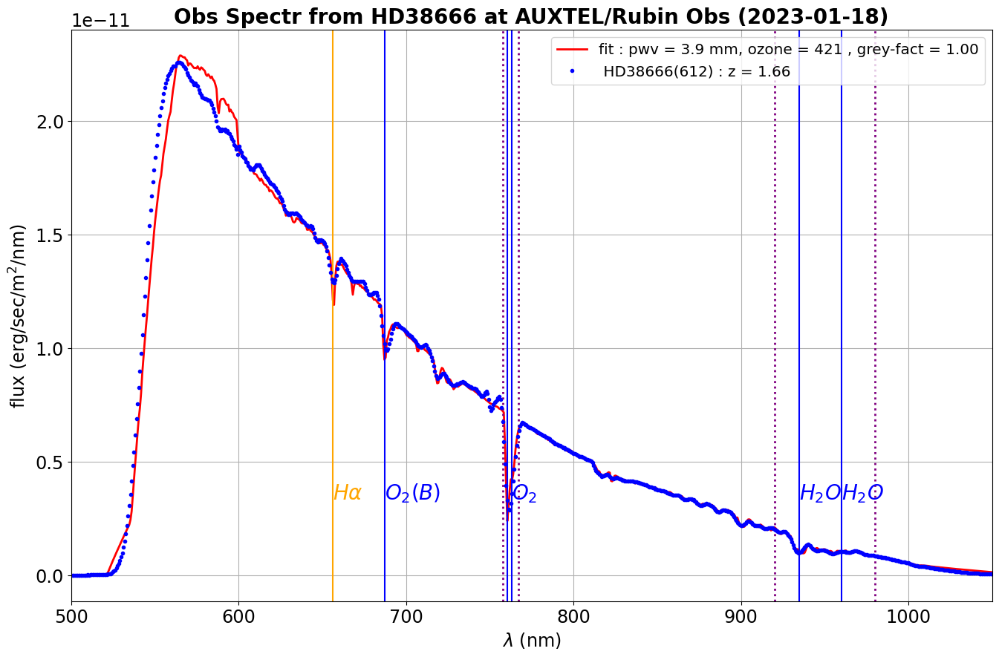

======================================= 34 : HD38666(613) : z = 1.67 =================================
>>>> parameters for  HD38666(613) : z = 1.67 [  1.00996147   3.87750679 426.18287786]


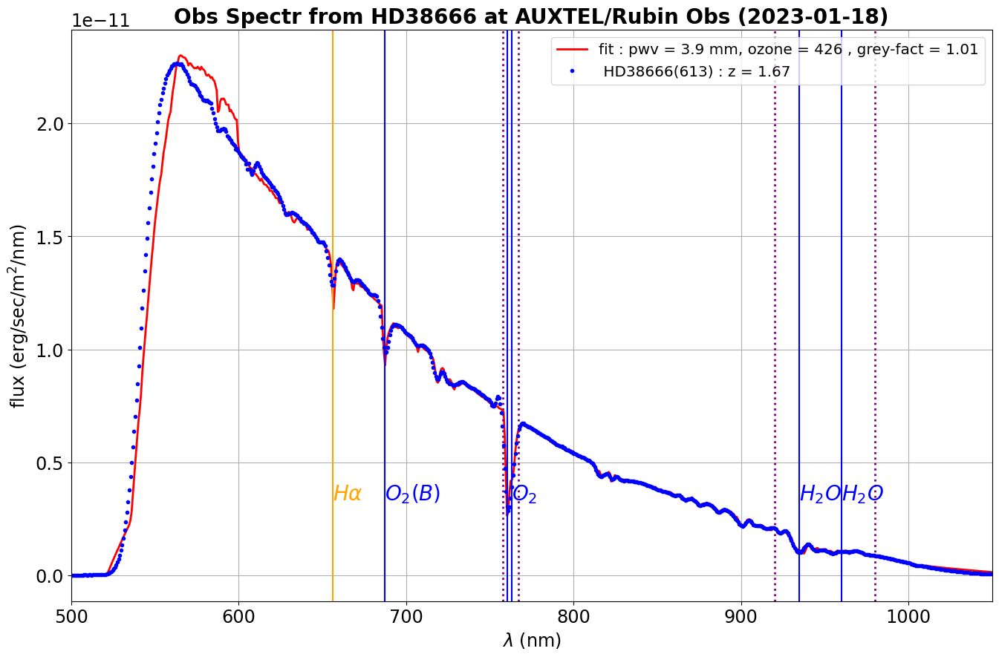

======================================= 35 : HD38666(622) : z = 1.71 =================================
>>>> parameters for  HD38666(622) : z = 1.71 [  1.0095855    3.69245939 413.13636033]


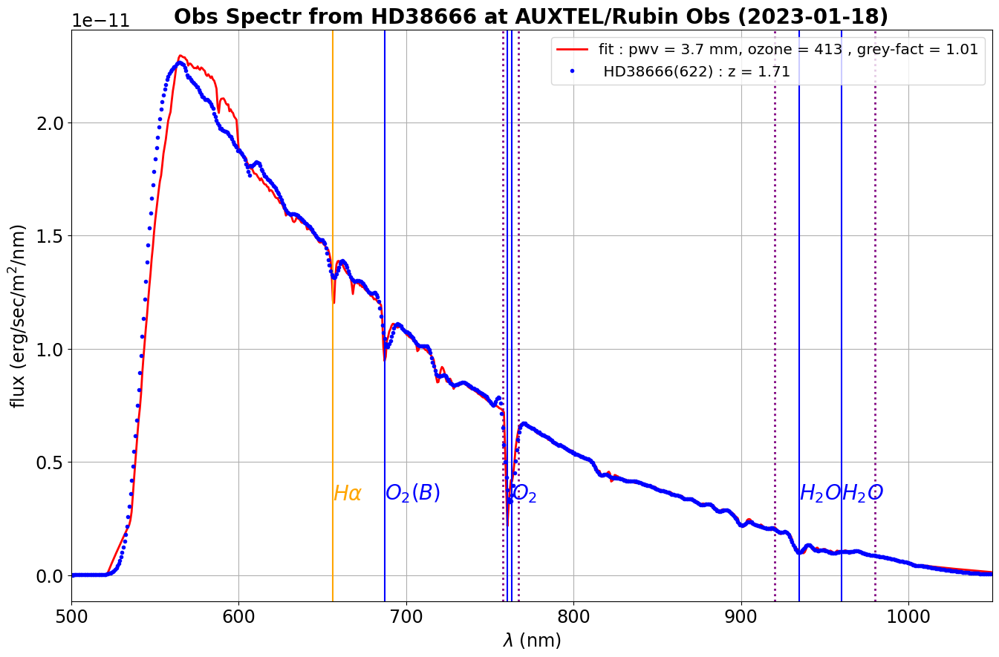

======================================= 36 : HD38666(630) : z = 1.75 =================================
>>>> parameters for  HD38666(630) : z = 1.75 [  1.00011291   3.60363216 408.88045789]


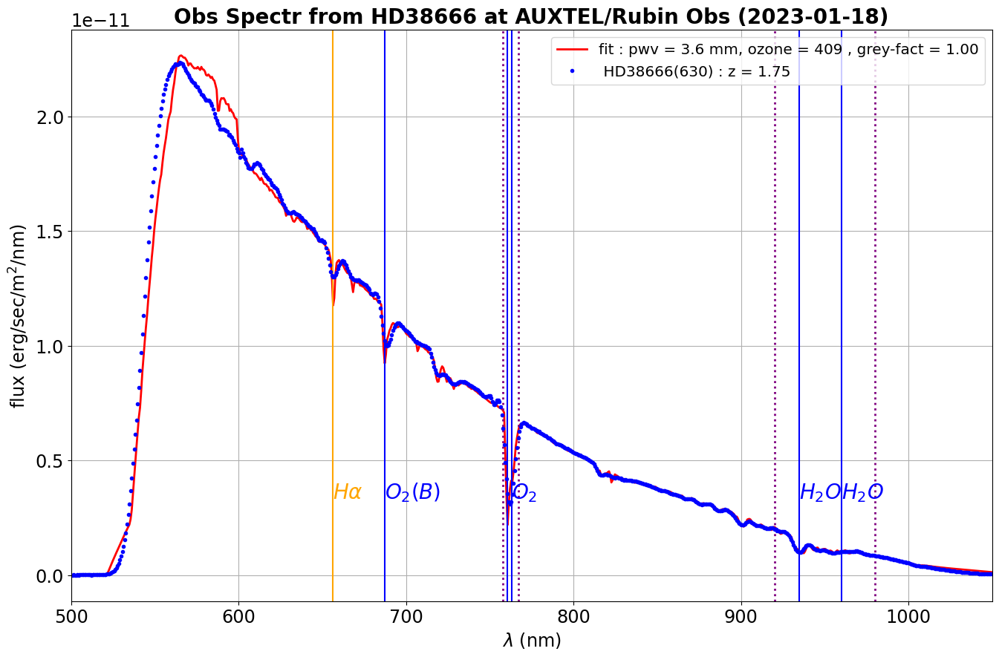

======================================= 37 : HD38666(631) : z = 1.76 =================================
>>>> parameters for  HD38666(631) : z = 1.76 [  1.00635562   3.58042287 412.9141678 ]


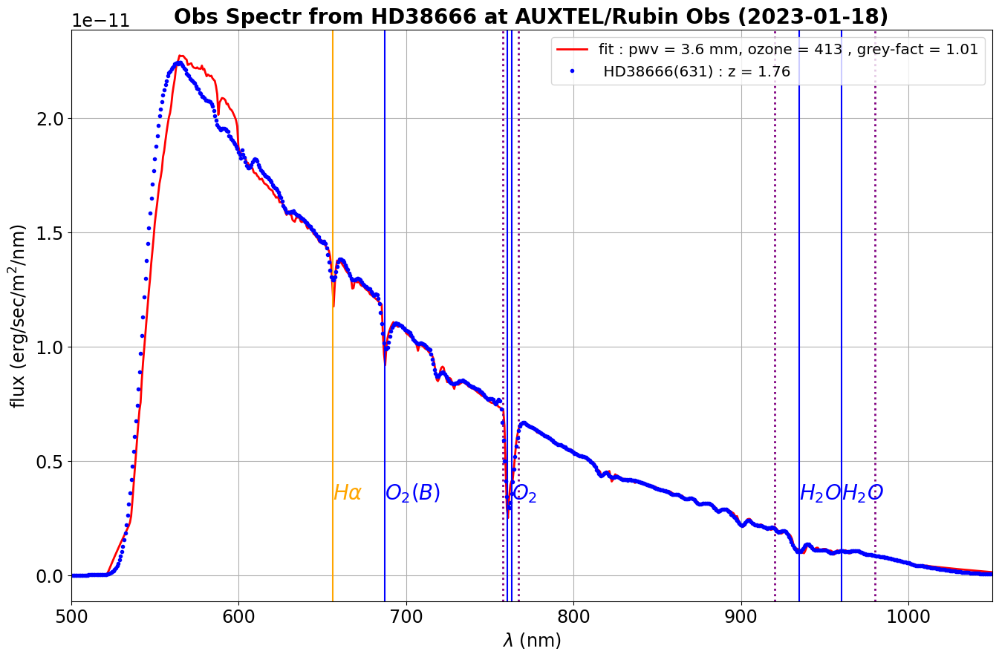

======================================= 38 : HD38666(640) : z = 1.81 =================================
>>>> parameters for  HD38666(640) : z = 1.81 [  1.01042475   3.6306132  406.06802685]


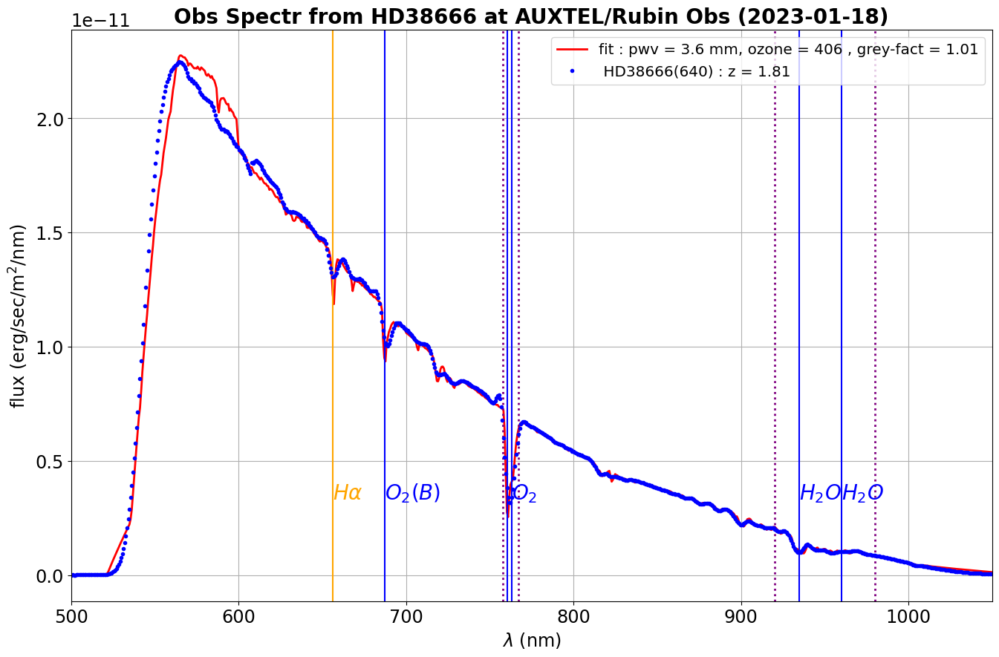

======================================= 39 : HD185975(648) : z = 2.13 =================================
>>>> parameters for  HD185975(648) : z = 2.13 [  0.98757413   2.97603598 341.25120244]


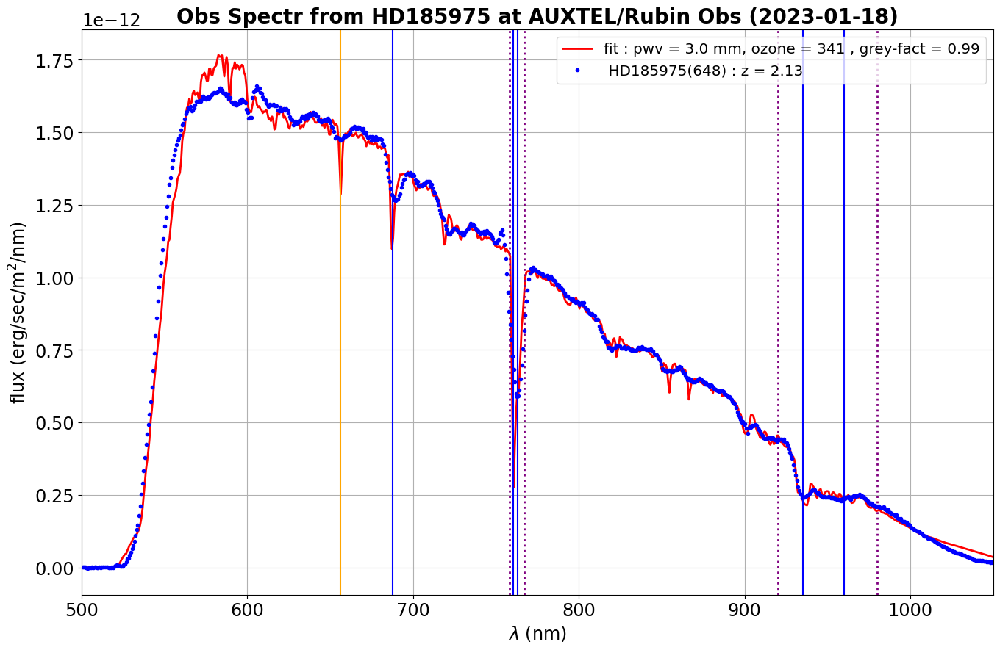

======================================= 40 : HD185975(649) : z = 2.13 =================================
>>>> parameters for  HD185975(649) : z = 2.13 [  0.98792734   2.95868454 341.1061207 ]


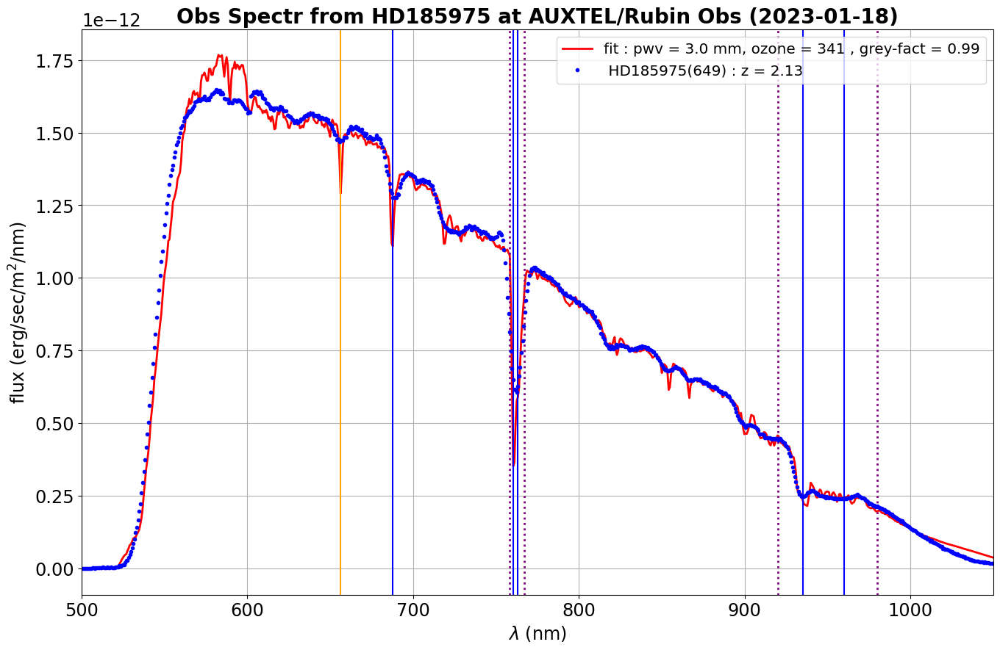

======================================= 41 : HD38666(657) : z = 1.93 =================================
>>>> parameters for  HD38666(657) : z = 1.93 [  0.99143328   3.65762142 395.67866468]


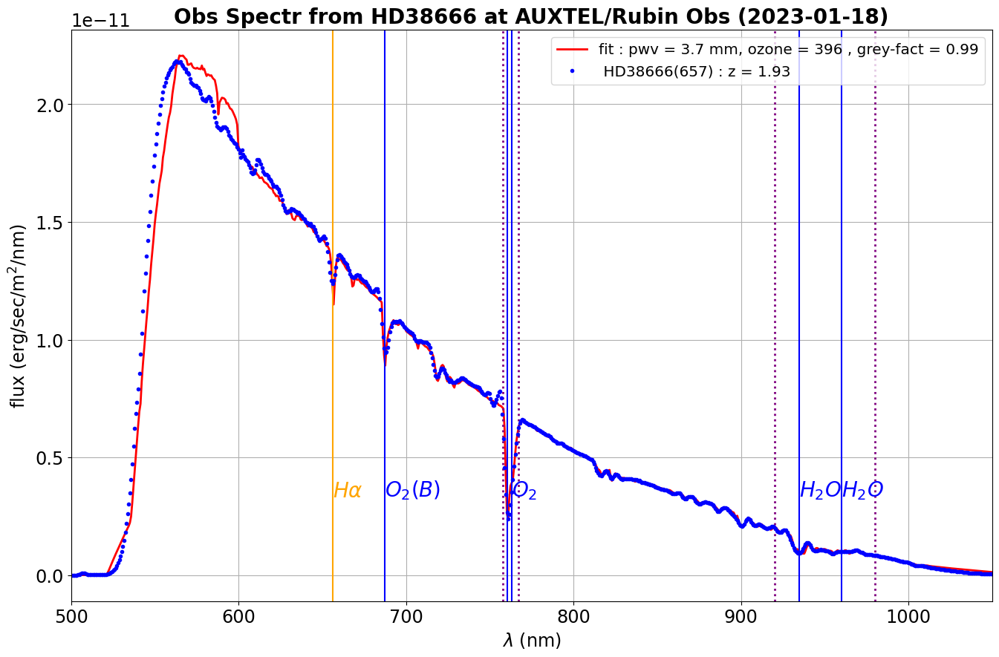

======================================= 42 : HD38666(684) : z = 2.13 =================================
>>>> parameters for  HD38666(684) : z = 2.13 [  0.99783043   3.68805813 392.58860077]


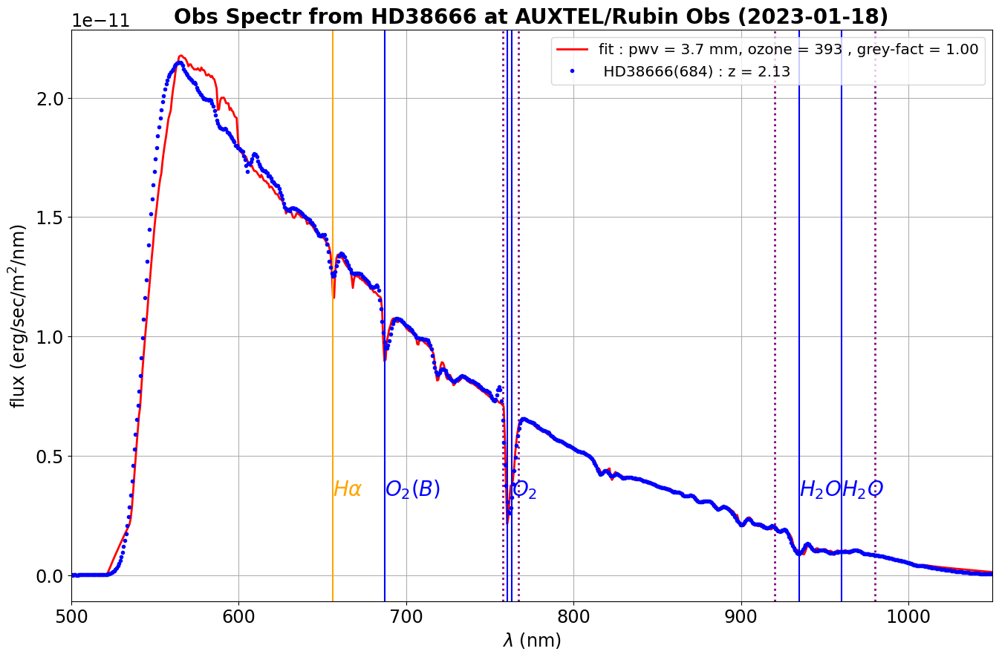

======================================= 43 : HD38666(685) : z = 2.14 =================================
>>>> parameters for  HD38666(685) : z = 2.14 [  0.99278344   3.402696   415.26740818]


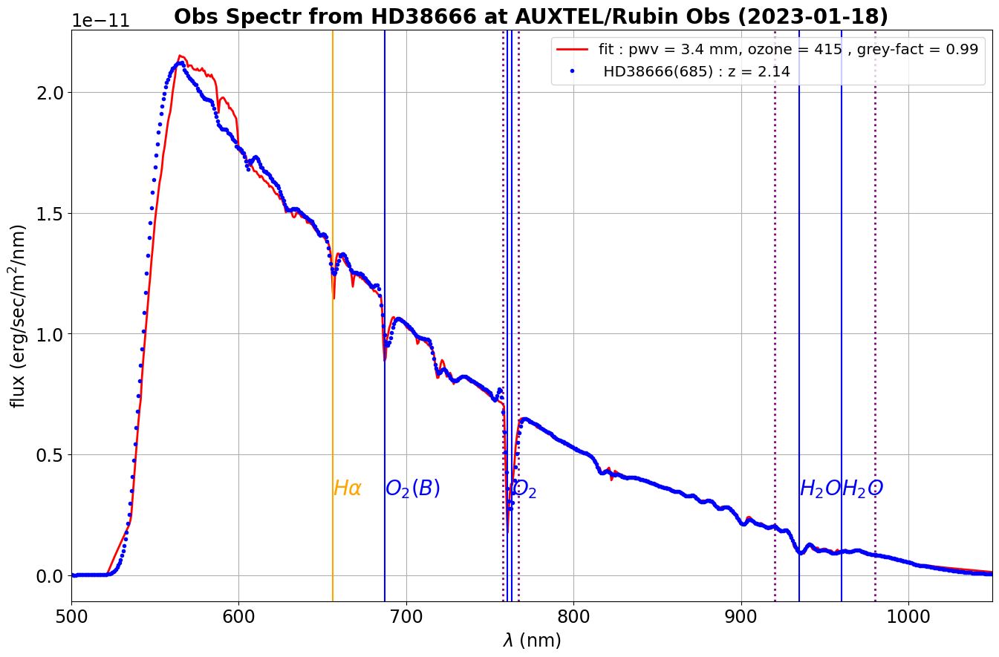

======================================= 44 : HD38666(693) : z = 2.20 =================================
>>>> parameters for  HD38666(693) : z = 2.20 [  0.95116232   3.38446009 390.87260026]


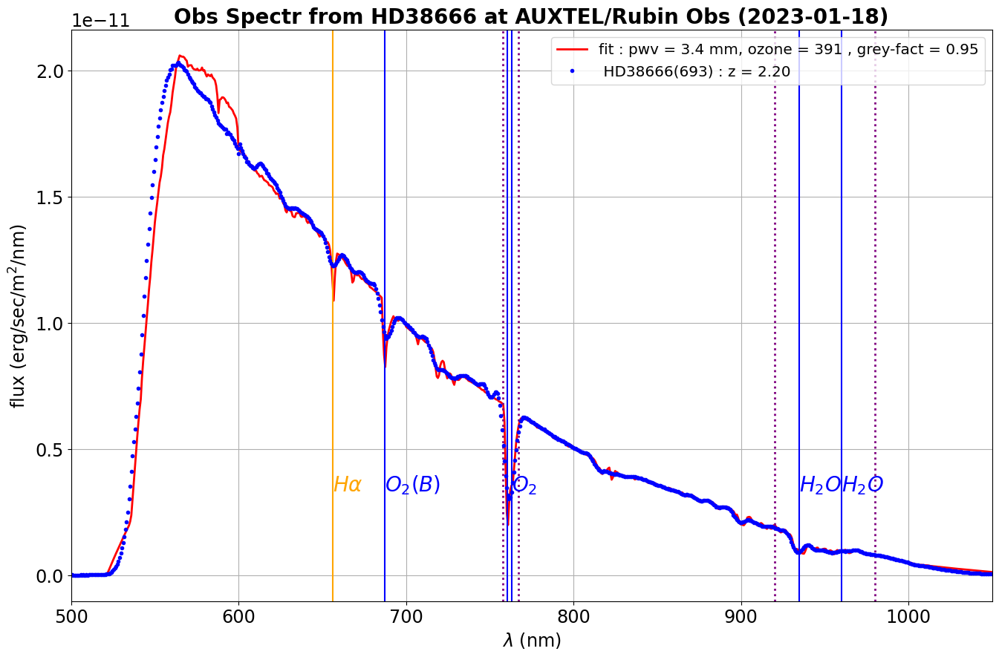

======================================= 45 : HD38666(694) : z = 2.22 =================================
>>>> parameters for  HD38666(694) : z = 2.22 [  0.94280744   3.45235855 399.96826673]


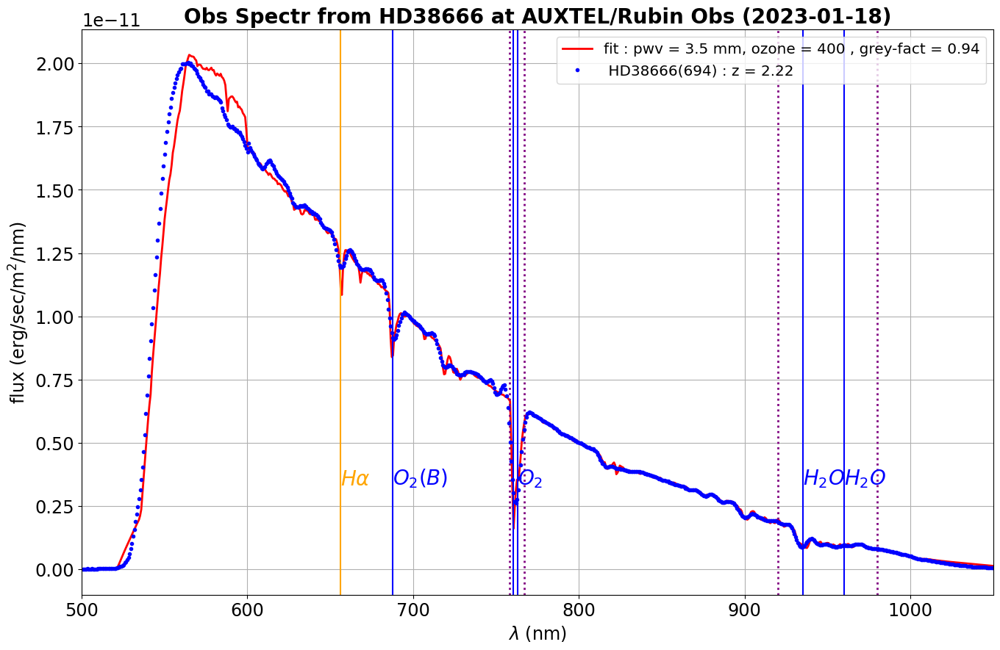

======================================= 46 : HD185975(702) : z = 2.11 =================================
>>>> parameters for  HD185975(702) : z = 2.11 [  0.98903834   3.10779991 338.81209544]


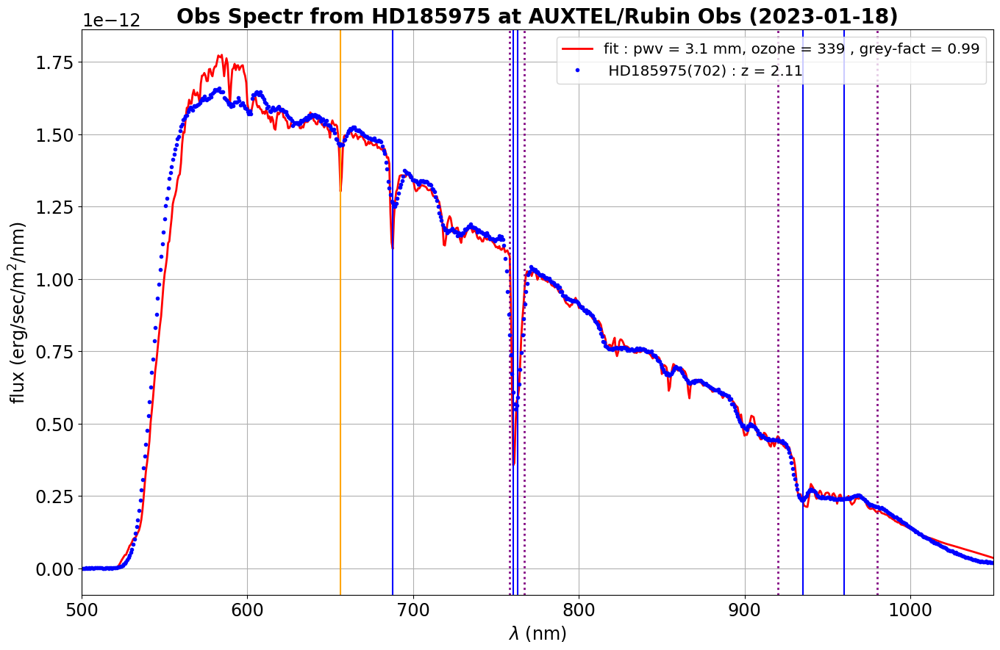

======================================= 47 : HD185975(703) : z = 2.11 =================================
>>>> parameters for  HD185975(703) : z = 2.11 [  0.99614394   3.08865927 346.30417852]


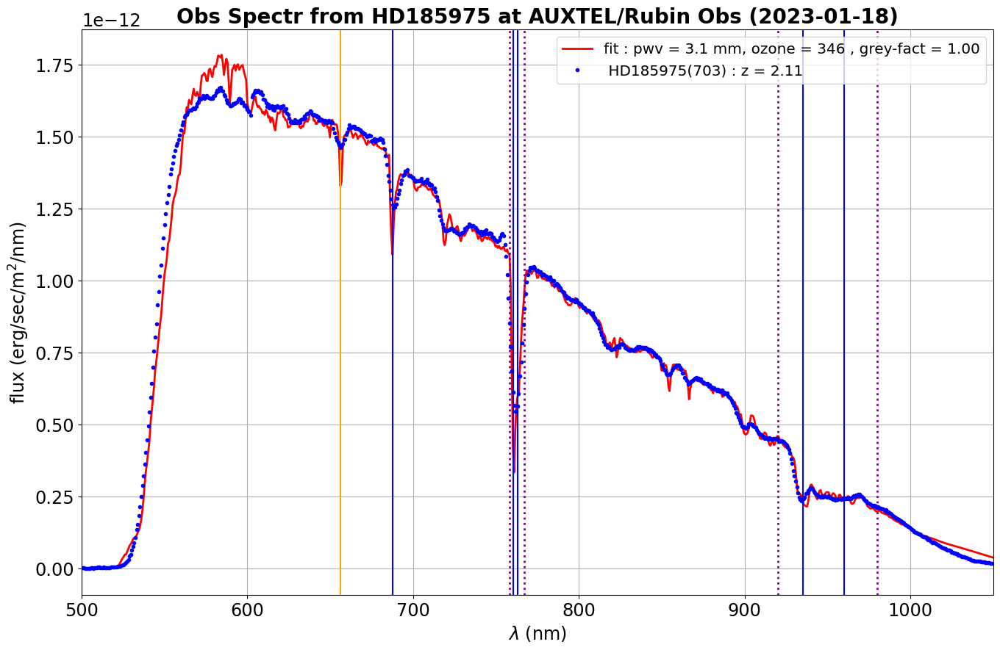

======================================= 48 : HD111980(734) : z = 1.10 =================================
>>>> parameters for  HD111980(734) : z = 1.10 [  1.06056588   2.96682162 550.        ]


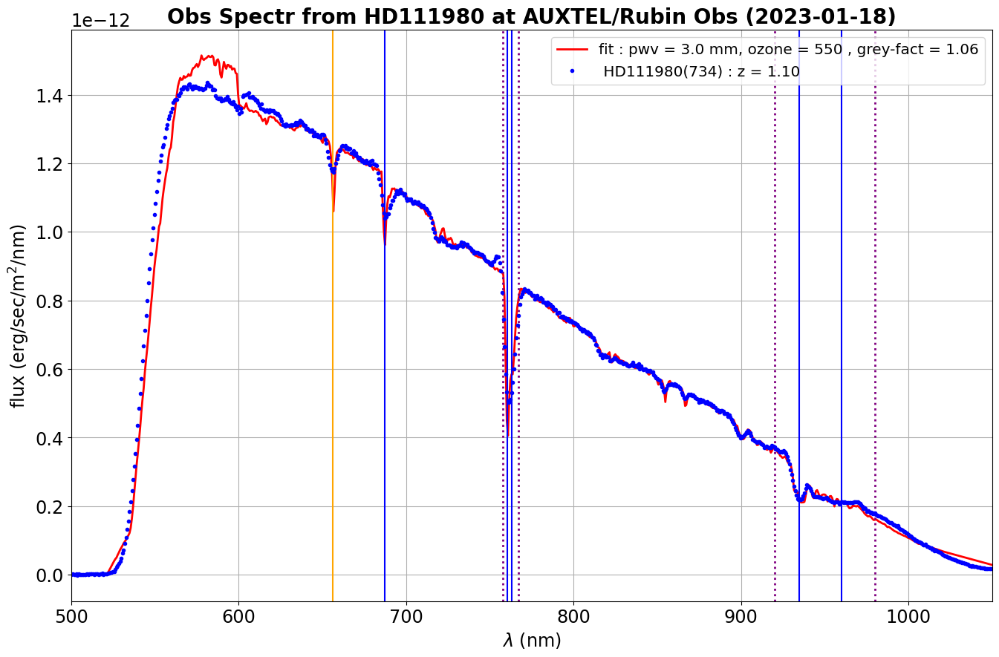

======================================= 49 : HD111980(735) : z = 1.10 =================================
>>>> parameters for  HD111980(735) : z = 1.10 [  1.05503643   3.30415439 550.        ]


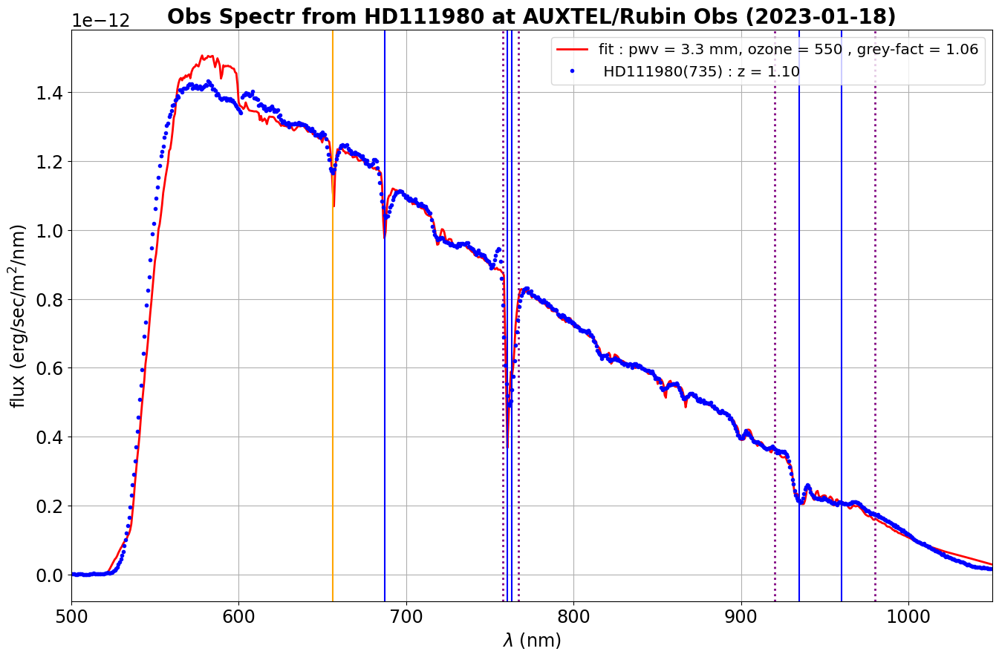

======================================= 50 : HD185975(757) : z = 2.09 =================================
>>>> parameters for  HD185975(757) : z = 2.09 [  0.99794434   3.34866935 380.75165184]


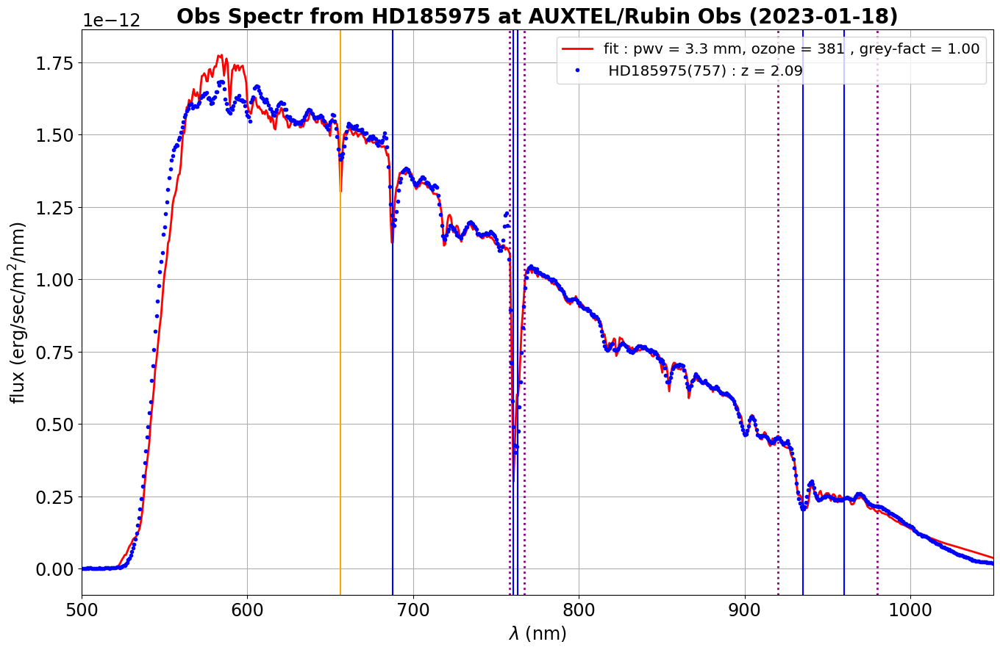

======================================= 51 : HD185975(758) : z = 2.09 =================================
>>>> parameters for  HD185975(758) : z = 2.09 [  1.00232269   3.16074589 389.00676676]


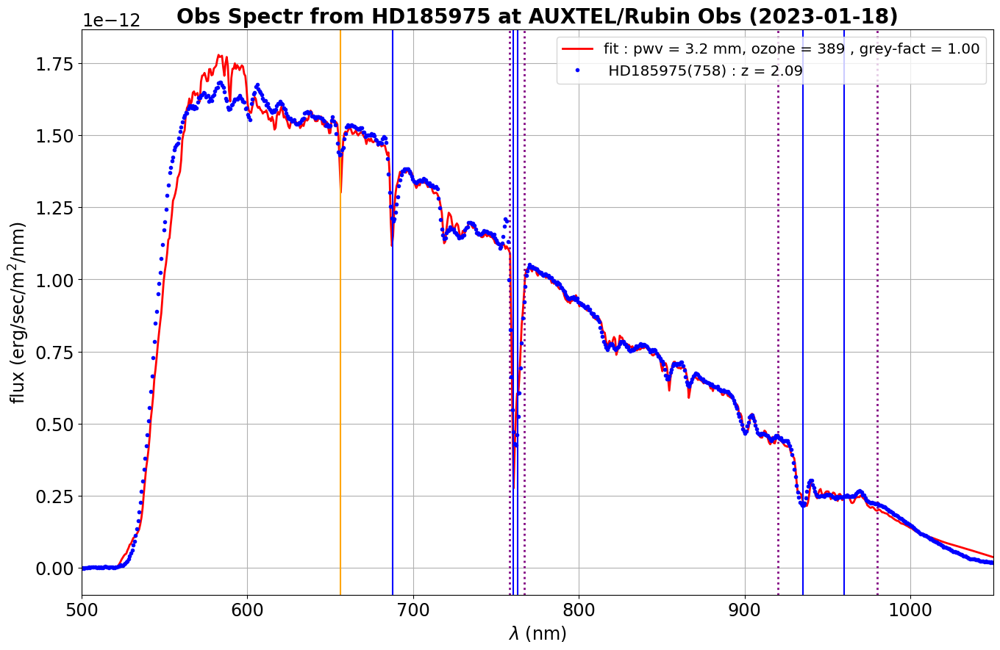

In [110]:
# extract spectrum from data
for idx in range(NBSPECTRA):
    
    fig=plt.figure(figsize=(16,10))
    gs = gridspec.GridSpec(1, 1,height_ratios=[1] ,figure=fig)


    # Fig 1
    ax=fig.add_subplot(gs[0,0])
    
    
    the_df=all_spectra[idx]
    data = the_df['all_fluxes']/correction_area
    dataerr = the_df["all_fluxes_err"]/correction_area
    data_the_wl = the_df["all_lambdas"].values

    index_sel= np.where(np.logical_and(data_the_wl>WLMINSEL,data_the_wl<WLMAXSEL))[0]

    data = data[index_sel].values
    dataerr = dataerr[index_sel].values 
    data_the_wl = data_the_wl[index_sel]
                    
    data_airmassvalue = infos.iloc[idx]["airmass"]
    data_target = infos.iloc[idx]["object"]
    data_number = infos.iloc[idx]["number"]
    
    f_sed = dict_f_sed[data_target] 
    data_the_sedxthroughput = f_sed(data_the_wl) * f_thr_new(data_the_wl)

    label_airmass = f" {data_target}({data_number}) : z = {data_airmassvalue:.2f}"
    
    print(f"======================================= {idx} :{label_airmass} =================================")
    
    # Compute the fit of the parameters (alpha,pwv,oz)
    res2 = least_squares(func_residuals2, params0, bounds=([0.1,0.001,50.],[2,9.5,550.]),
                                                           args=[data_the_wl,data_the_sedxthroughput,data_airmassvalue,data,dataerr])
    
    alpha_fit,pwv_fit,oz_fit = res2.x
    label_fit =f"fit : pwv = {pwv_fit:.1f} mm, ozone = {oz_fit:.0f} , grey-fact = {alpha_fit:.2f}"
    
    print(f">>>> parameters for {label_airmass}",res2.x)
   
    # Compute the prediction
    the_model = pred2(res2.x,data_the_wl,data_the_sedxthroughput,data_airmassvalue)

   
    # plot

    ax.errorbar(data_the_wl,data,yerr=dataerr, fmt = '.',color="b",capsize = 0.01, ecolor=all_colors[ifile], elinewidth = .01,label=label_airmass)
    ax.plot(data_the_wl,the_model,'r-',label=label_fit,lw=2)

    ax.grid()
    ax.set_xlabel("$\lambda$ (nm)")
    ax.set_ylabel("flux (erg/sec/m$^2$/nm)")
    title=f"Obs Spectr from {data_target} at {SITE} ({DATE})"
    ax.set_title(title,fontsize=20,fontweight='bold')
    #ax.plot(sed_w,sed_f,'k-',label="SED")
    #ax.plot(WL,sed_predicted_f,color='darkviolet',lw=4,label = "predicted flux")
    ax.set_xlim( WLMINSEL  , WLMAXSEL  )

    ax.legend(loc="upper right")
    # draw abs lines
    plotlines(ax,ypos=FLUXLIMMAX/30)
    
    ax.axvline(x=758,linewidth=2,linestyle=":" ,color='purple')
    ax.axvline(x=767,linewidth=2,linestyle=':', color='purple')
    
    ax.axvline(x=920,linewidth=2,linestyle=":" ,color='purple')
    ax.axvline(x=980,linewidth=2,linestyle=':', color='purple')
    
    plt.show()
    


In [111]:
infos

,number,object,dateobs,refhour,airmass,pressure,temperature,humidity,filename,targetx_pix,targety_pix,rotangle,d2ccd
0,211,HD38666,2023-01-19T00:54:29.923007271Z,-3.087228,1.078479,0,0,0,2023011800211,248.234326,1732.468544,0.228422,180.140554
1,220,HD38666,2023-01-19T00:59:57.036990263Z,-2.996363,1.069996,0,0,0,2023011800220,242.321785,1734.470137,0.224652,180.157242
2,252,HD185975,2023-01-19T01:27:35.395008735Z,-2.535708,2.058078,0,0,0,2023011800252,282.846208,1776.201684,0.436762,180.106956
3,253,HD185975,2023-01-19T01:28:18.197490329Z,-2.523818,2.058515,0,0,0,2023011800253,282.855286,1779.107865,0.442411,180.053015
4,267,HD38666,2023-01-19T01:40:08.188998340Z,-2.326598,1.023673,0,0,0,2023011800267,292.747118,1768.489070,0.189878,179.415913
5,268,HD38666,2023-01-19T01:40:51.200005903Z,-2.314651,1.023086,0,0,0,2023011800268,295.340583,1768.451393,0.192723,179.586694
6,292,HD185975,2023-01-19T01:58:49.768499413Z,-2.015048,2.076251,0,0,0,2023011800292,304.184467,1772.654996,0.444434,180.398617
7,316,HD185975,2023-01-19T02:28:12.480994287Z,-1.525406,2.092601,0,0,0,2023011800316,305.882807,1778.849342,0.430714,180.172694
8,317,HD185975,2023-01-19T02:28:55.326491866Z,-1.513504,2.092969,0,0,0,2023011800317,301.088935,1776.993049,0.434735,180.181846
9,325,HD074000,2023-01-19T02:34:40.316998221Z,-1.417674,1.359381,0,0,0,2023011800325,292.421276,1733.749306,0.274512,180.175885
